In [1]:
!pip install pandas numpy matplotlib seaborn
!pip install scikit-learn xgboost scipy
!pip install pydot graphviz
!pip install dowhy==0.9.1
!pip install ipywidgets


In [2]:
import pandas as pd
df = pd.read_csv('PPD_dataset_cleaned.csv')
display(df.head())
print(df.shape)


,Age,Residence,Marital status,Family type,Major changes or losses during pregnancy,Trust and share feelings,Number of the latest pregnancy,Pregnancy plan,Regular checkups,Fear of pregnancy,...,Feeling for regular activities_None,Feeling for regular activities_Tired,Feeling for regular activities_Worried,PHQ9 Result_Minimal,PHQ9 Result_Moderate,PHQ9 Result_Moderately Severe,PHQ9 Result_Normal,PHQ9 Result_Severe,EPDS Result_low,EPDS Result_medium
0,24,0,1,1,1,1,1,0,1,1,...,0,0,1,0,1,0,0,0,0,0
1,31,0,0,0,1,1,1,1,1,1,...,0,1,0,0,0,1,0,0,0,0
2,31,0,1,0,0,1,1,1,1,1,...,0,1,0,0,1,0,0,0,0,0
3,32,0,1,0,1,1,1,1,1,1,...,0,1,0,0,0,0,0,0,1,0
4,27,0,1,0,0,1,1,1,1,1,...,0,0,1,0,1,0,0,0,1,0


(799, 119)


In [3]:
# Identify categorical and numerical features
categorical_features = []
numerical_features = []

for col in df.columns:
    if df[col].dtype in ['int64', 'object']:  # Potential categorical features
        if df[col].nunique() < 10:
            categorical_features.append(col)
        else:
            numerical_features.append(col)
    elif df[col].dtype in ['float64']:
        numerical_features.append(col)

print("Categorical Features:", categorical_features)
print("\nNumerical Features:", numerical_features)

Categorical Features: ['Residence', 'Marital status', 'Family type', 'Major changes or losses during pregnancy', 'Trust and share feelings', 'Number of the latest pregnancy', 'Pregnancy plan', 'Regular checkups', 'Fear of pregnancy', 'Mode of delivery', 'Gender of newborn', 'Birth compliancy', 'Breastfeed', 'Newborn illness', 'Worry about newborn', 'Relax/sleep when newborn is tended ', 'Relax/sleep when the newborn is asleep', 'Angry after latest child birth', 'Depression before pregnancy', 'Depression during pregnancy', 'Education Level_High School', 'Education Level_None', 'Education Level_Primary School', 'Education Level_University', 'Occupation before latest pregnancy_Doctor', 'Occupation before latest pregnancy_Housewife', 'Occupation before latest pregnancy_Other', 'Occupation before latest pregnancy_Service', 'Occupation before latest pregnancy_Student', 'Occupation before latest pregnancy_Teacher', 'Monthly income before latest pregnancy_20000 to 30000', 'Monthly income befor

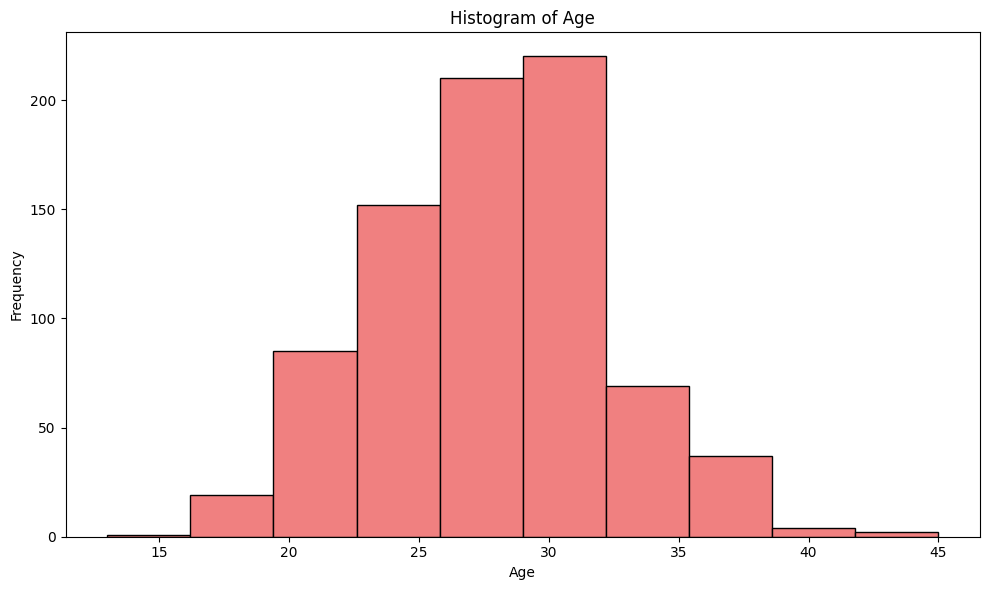

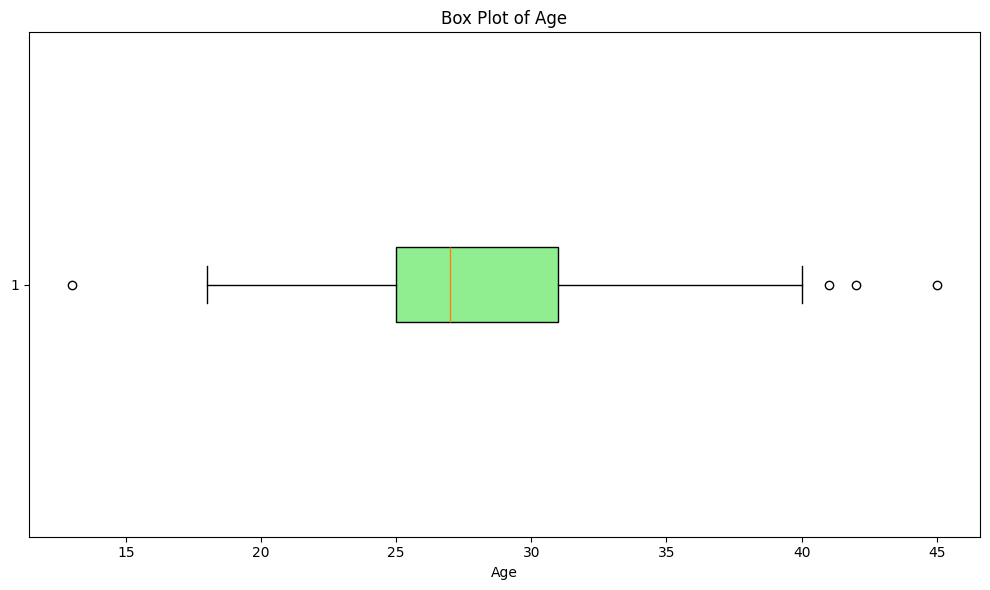

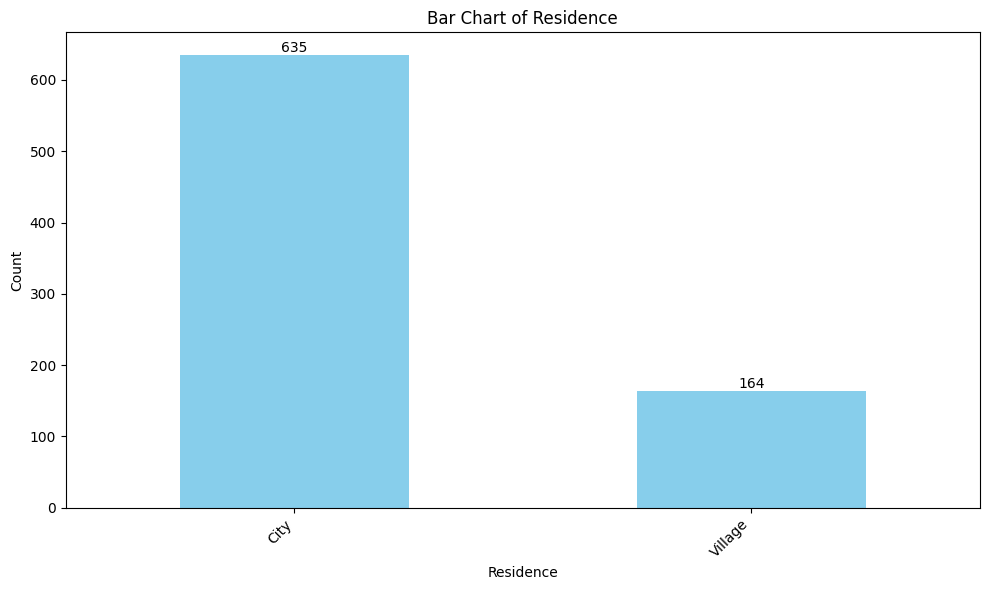

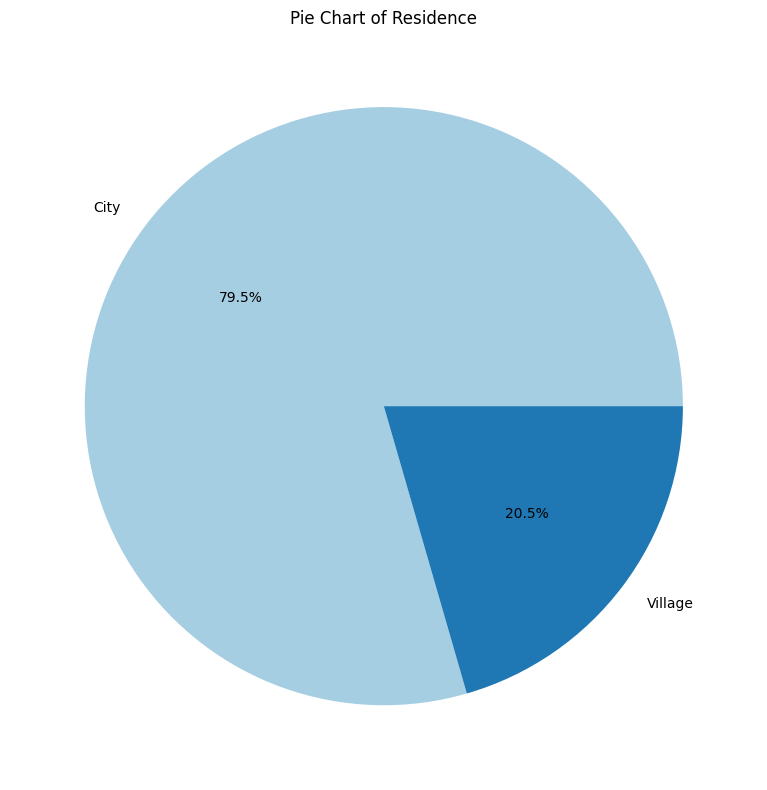

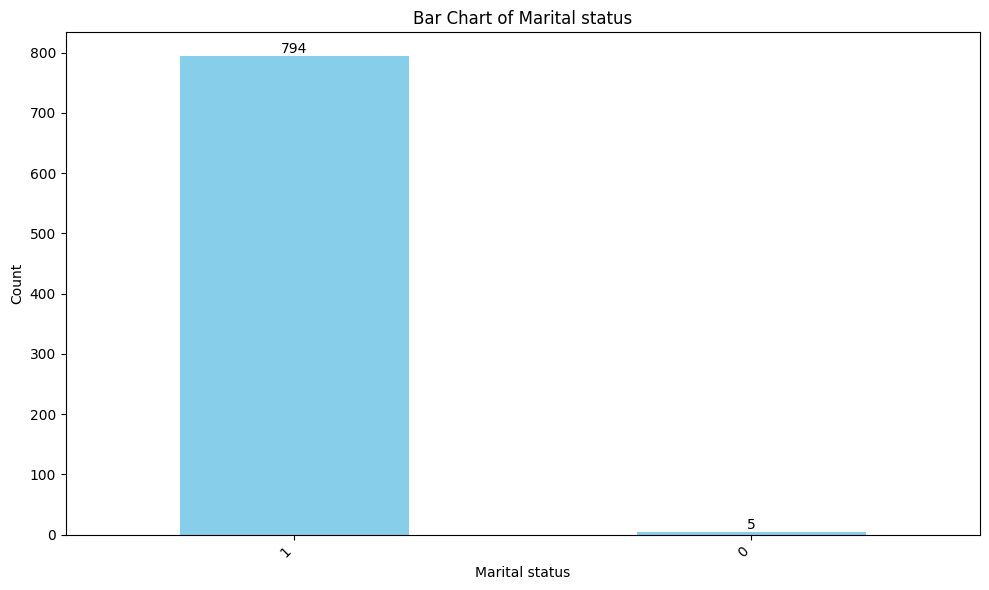

...

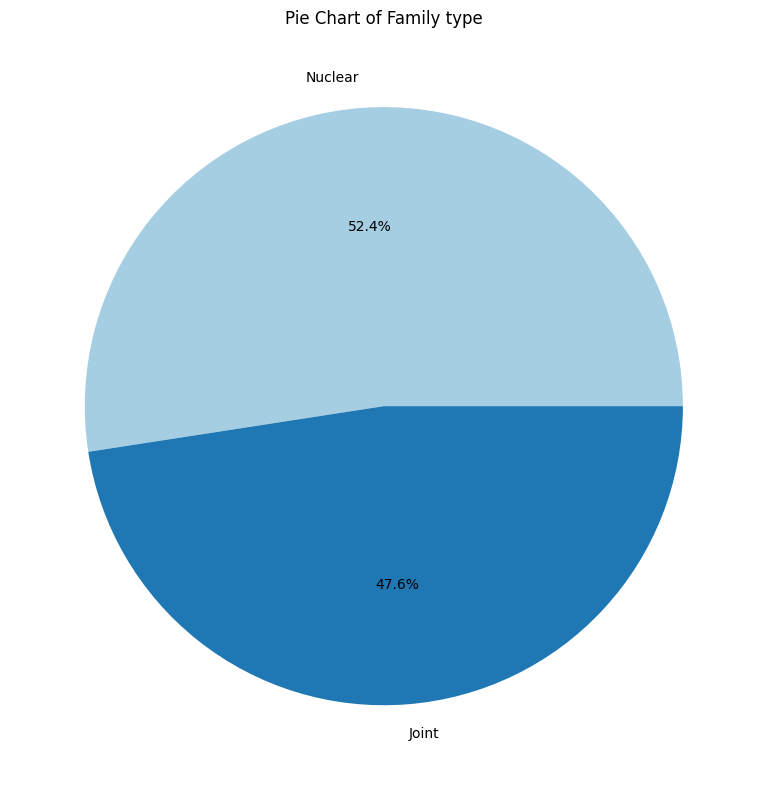

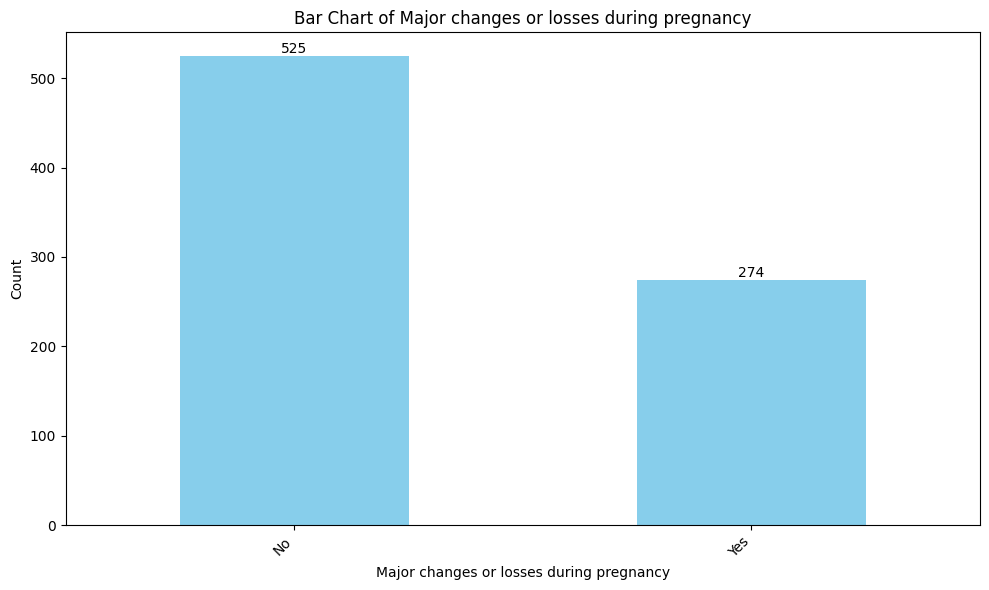

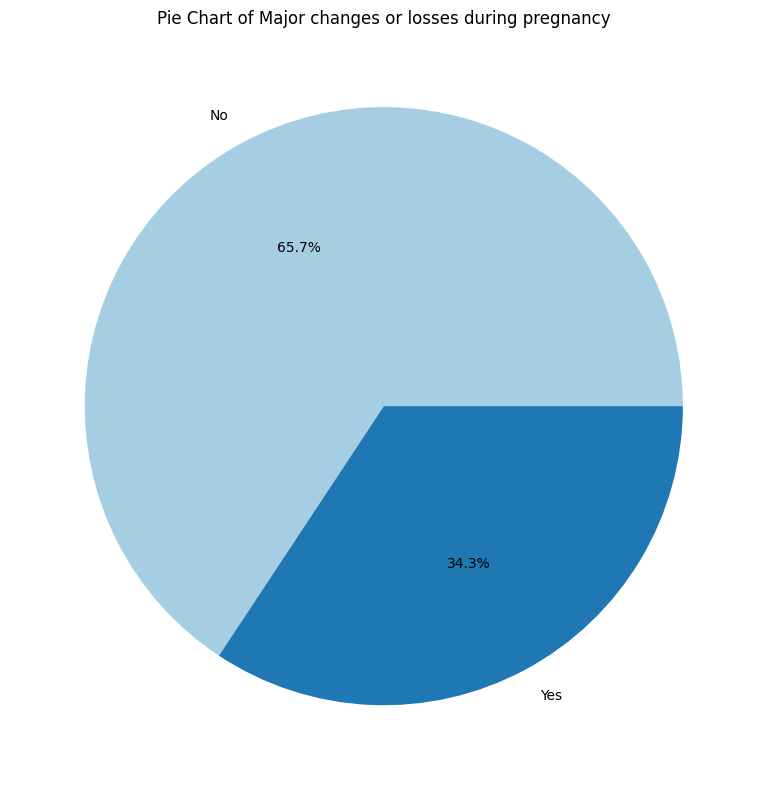

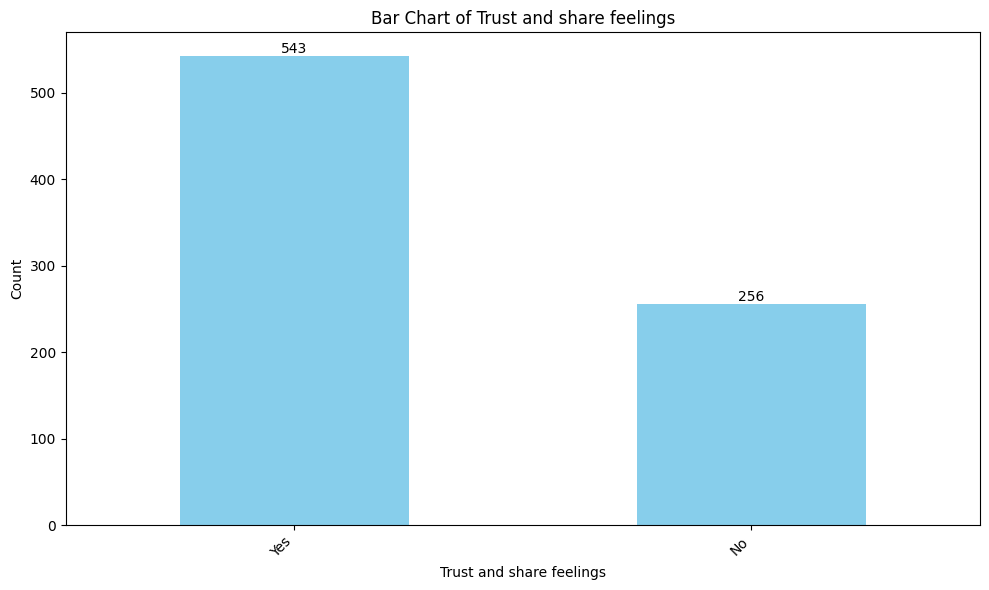

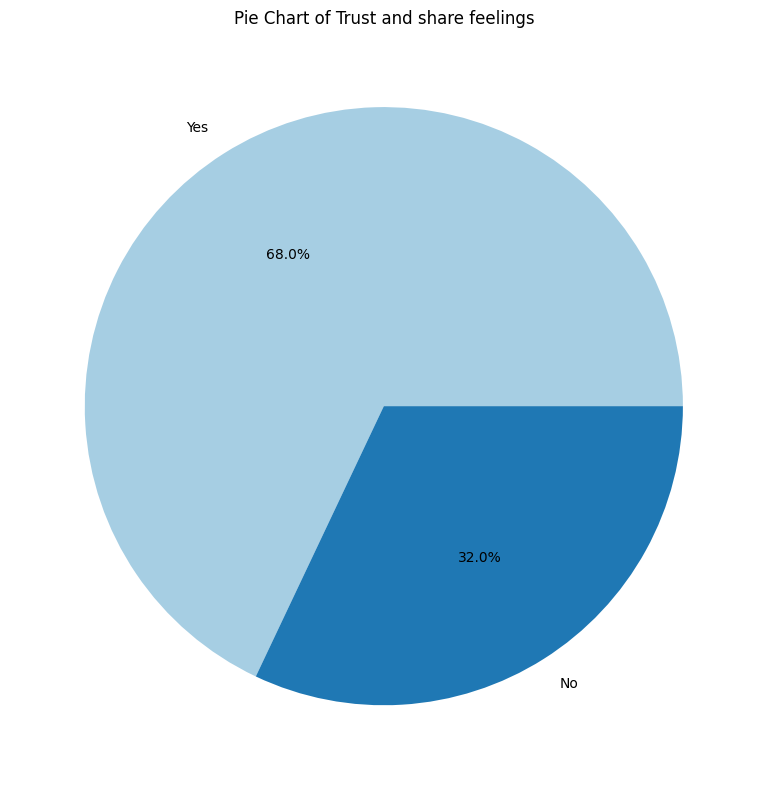

Error plotting Number of the latest pregnancy: 'set' object is not callable


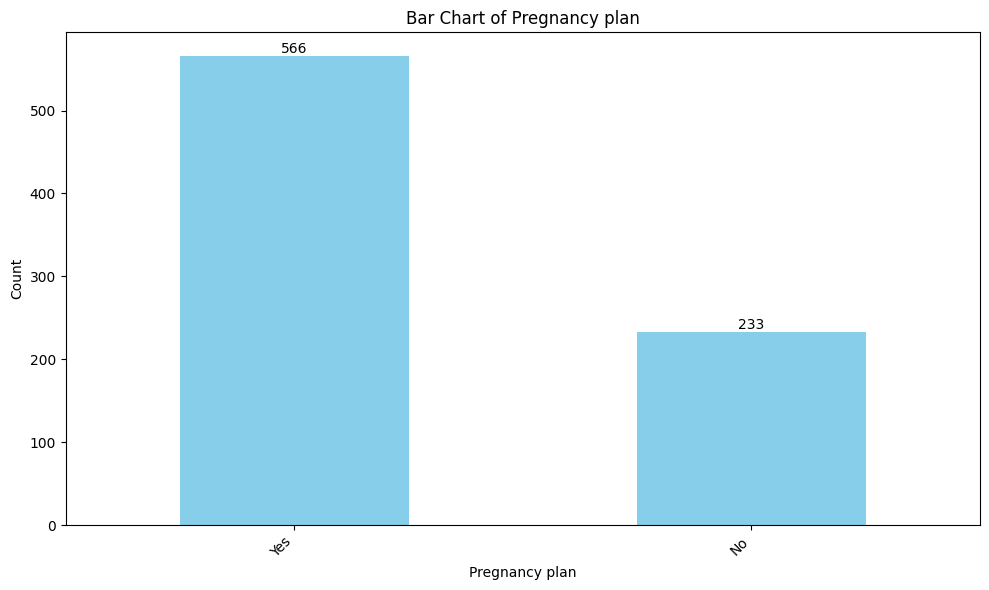

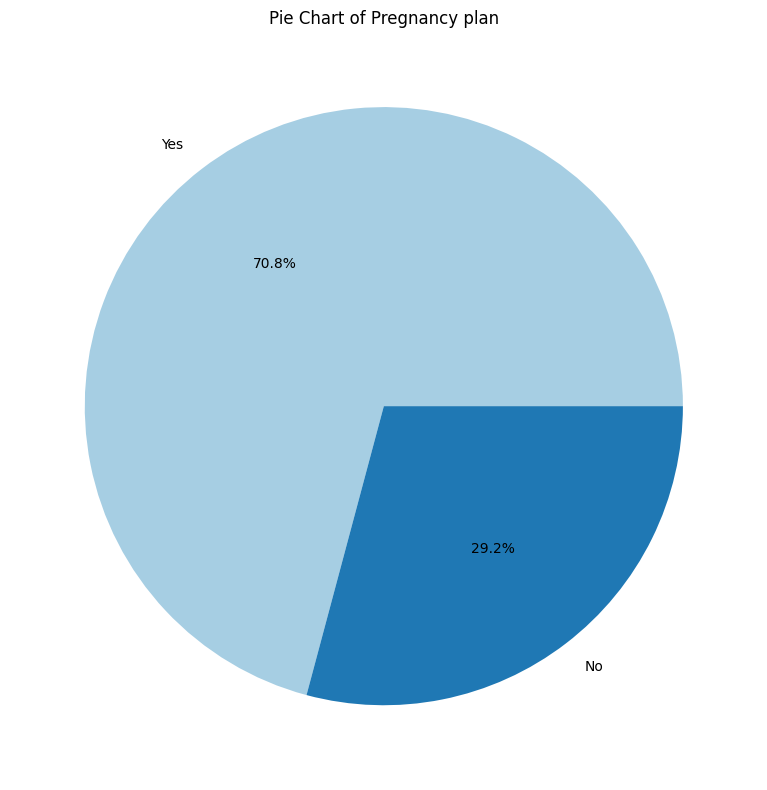

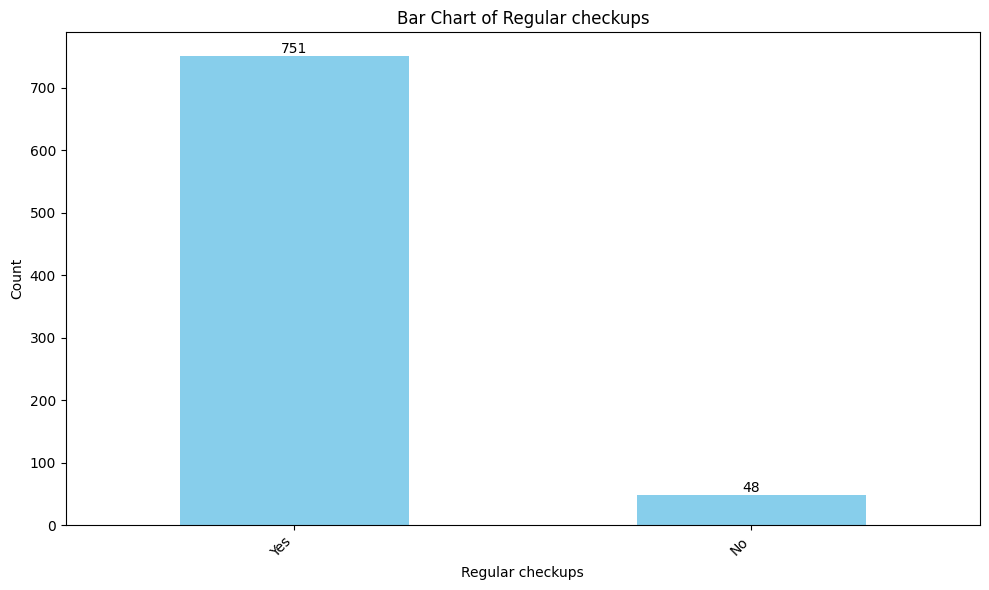

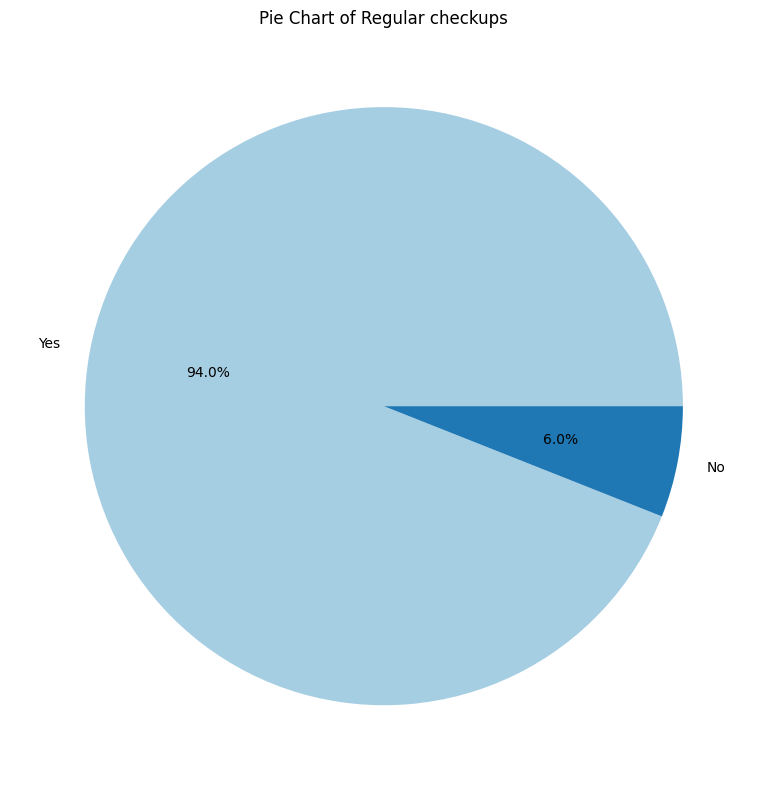

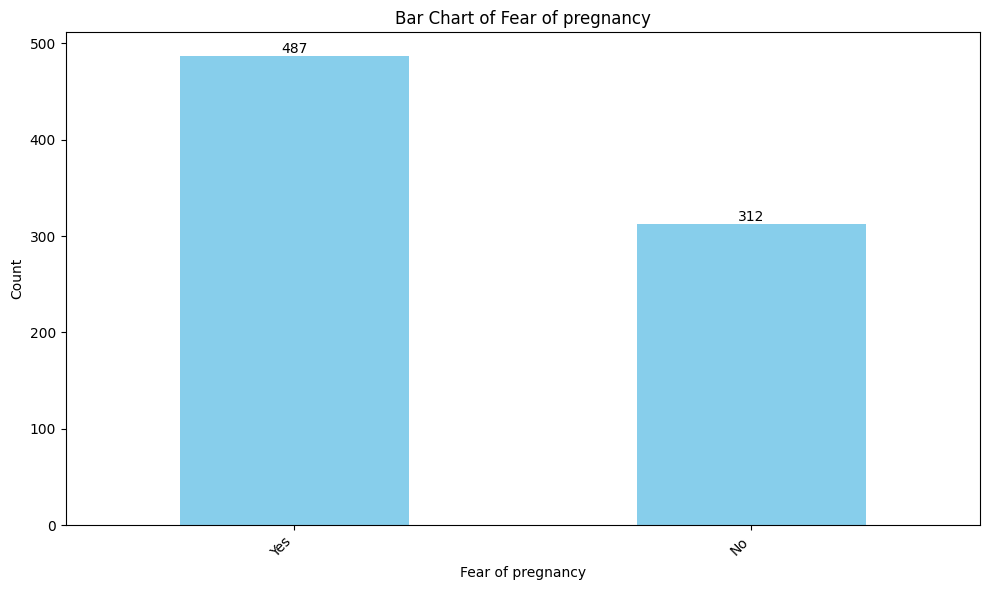

...

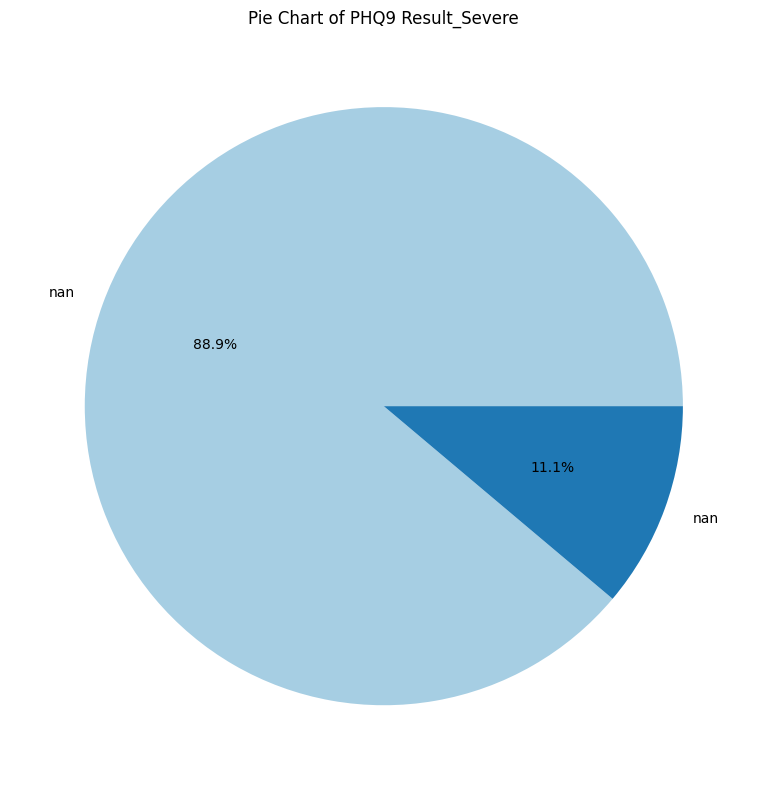

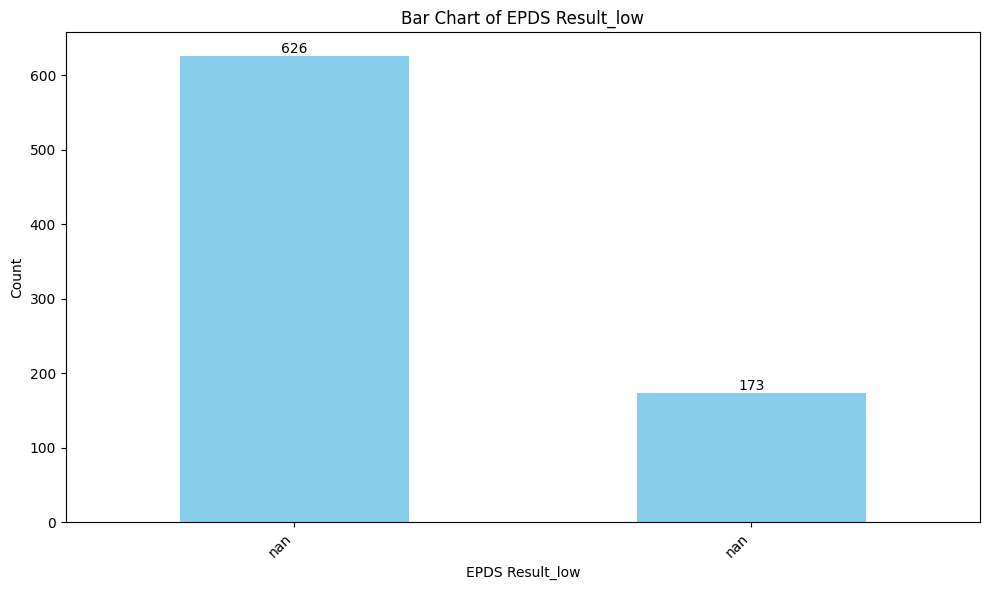

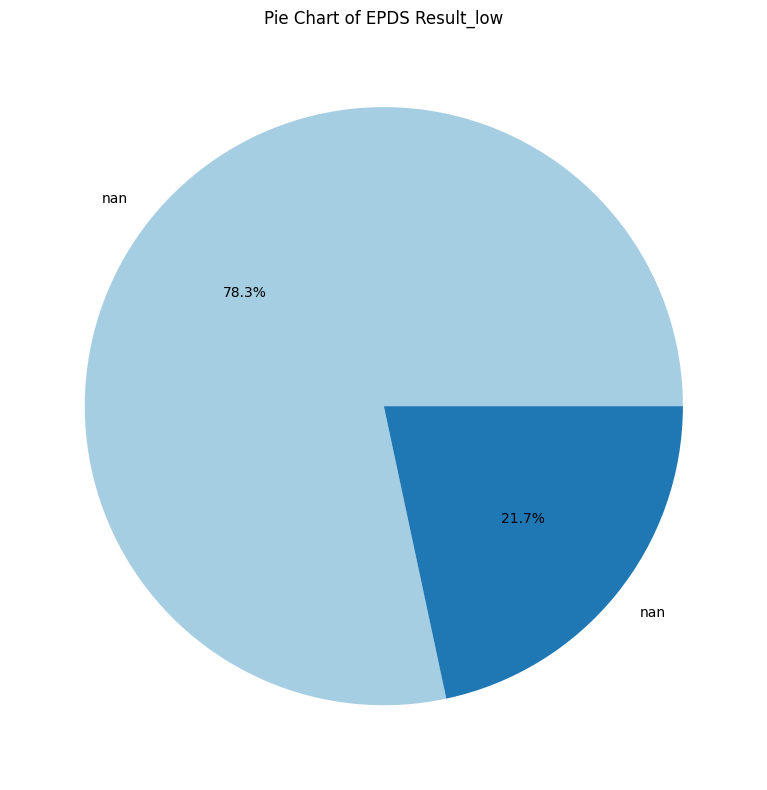

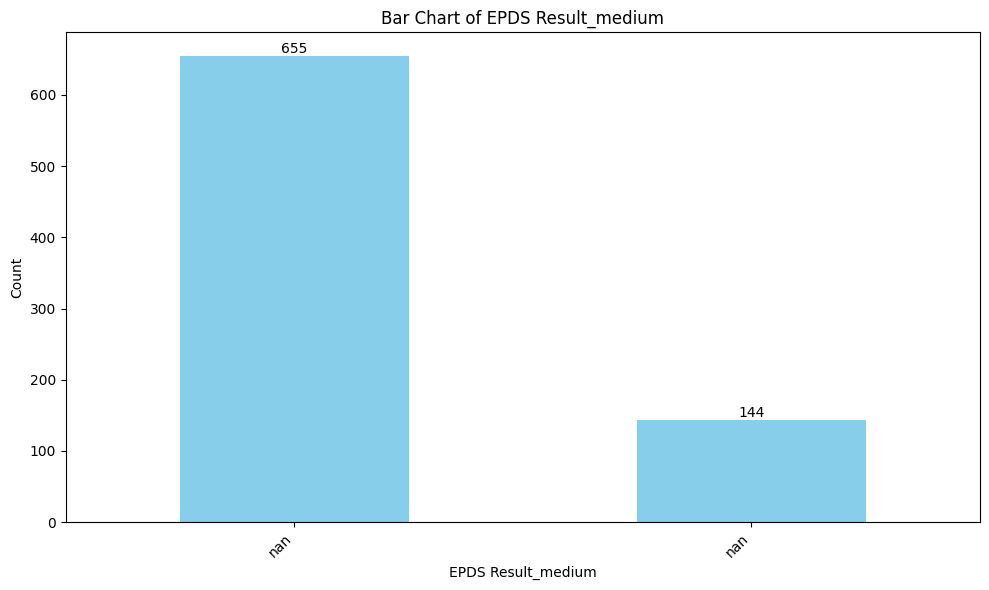

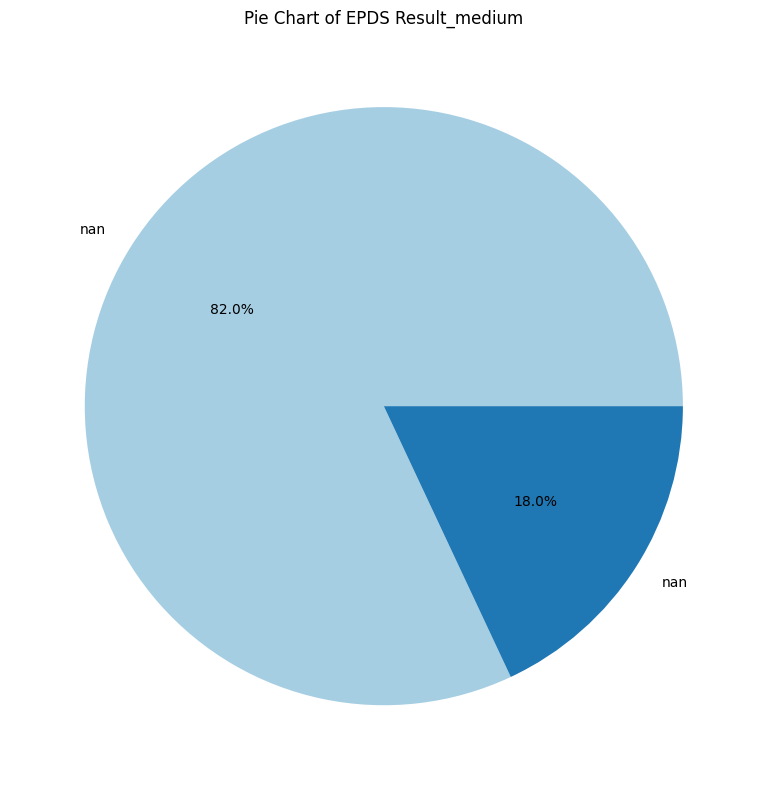

In [4]:
import matplotlib.pyplot as plt

label_mappings = {
    'Residence': {0: 'City', 1: 'Village'},
    'Married': {0: 'Divorced', 1: 'Married'},
    'Family type': {0: 'Joint', 1: 'Nuclear'},
    'Major changes or losses during pregnancy': {0: 'No', 1: 'Yes'},
    'Trust and share feelings': {0: 'No', 1: 'Yes'},
    'Number of the latest pregnancy': {1,2,3,4,5,6,7},
    'Pregnancy plan': {0: 'No', 1: 'Yes'},
    'Regular checkups': {0: 'No', 1: 'Yes'},
    'Fear of pregnancy': {0: 'No', 1: 'Yes'},
    'Mode of delivery': {0: 'Caesarean Section', 1: 'Normal Delivery'},
    'Gender of newborn': {0: 'Boy', 1: 'Girl'},
    'Birth compliancy': {0: 'No', 1: 'Yes'},
    'Breastfeed': {0: 'No', 1: 'Yes'},
    'Newborn illness': {0: 'No', 1: 'Yes'},
    'Worry about newborn': {0: 'No', 1: 'Yes'},
    'Relax/sleep when newborn is tended ': {0: 'No', 1: 'Yes'},
    'Relax/sleep when the newborn is asleep': {0: 'No', 1: 'Yes'},
    'Angry after latest child birth': {0: 'No', 1: 'Yes'},
    'Depression before pregnancy': {0: 'Negative', 1: 'Positive'},
    'Depression during pregnancy': {0: 'Negative', 1: 'Positive'},
    'Education Level_High School': {0: 'No', 1: 'Yes'},
    'Education Level_None': {0: 'No', 1: 'Yes'},
    'Education Level_Primary School': {0: 'No', 1: 'Yes'},
    'Education Level_University': {0: 'No', 1: 'Yes'},
    'Occupation before latest pregnancy_Doctor': {0: 'No', 1: 'Yes'},
    'Occupation before latest pregnancy_Housewife': {0: 'No', 1: 'Yes'},
    'Occupation before latest pregnancy_Other': {0: 'No', 1: 'Yes'},
    'Occupation before latest pregnancy_Service': {0: 'No', 1: 'Yes'},
    'Occupation before latest pregnancy_Student': {0: 'No', 1: 'Yes'},
    'Occupation before latest pregnancy_Teacher': {0: 'No', 1: 'Yes'},
    'Monthly income before latest pregnancy_20000 to 30000': {0: 'No', 1: 'Yes'},
    'Monthly income before latest pregnancy_5000 to 10000': {0: 'No', 1: 'Yes'},
    'Monthly income before latest pregnancy_Less than 5000': {0: 'No', 1: 'Yes'},
    'Monthly income before latest pregnancy_More than 30000': {0: 'No', 1: 'Yes'},
    'Monthly income before latest pregnancy_None': {0: 'No', 1: 'Yes'},
    'Occupation After Your Latest Childbirth_Doctor': {0: 'No', 1: 'Yes'},
    'Occupation After Your Latest Childbirth_Housewife': {0: 'No', 1: 'Yes'},
    'Occupation After Your Latest Childbirth_Other': {0: 'No', 1: 'Yes'},
    'Occupation After Your Latest Childbirth_Service': {0: 'No', 1: 'Yes'},
    'Occupation After Your Latest Childbirth_Student': {0: 'No', 1: 'Yes'},
    'Occupation After Your Latest Childbirth_Teacher': {0: 'No', 1: 'Yes'},
    'Current monthly income_20000 to 30000': {0: 'No', 1: 'Yes'},
    'Current monthly income_5000 to 10000': {0: 'No', 1: 'Yes'},
    'Current monthly income_Less than 5000': {0: 'No', 1: 'Yes'},
    'Current monthly income_More than 30000': {0: 'No', 1: 'Yes'},
    'Current monthly income_None': {0: 'No', 1: 'Yes'},
    'Husband\'s education level_High school': {},
    'Husband\'s education level_None': {},
    'Husband\'s education level_Primary School': {},
    'Husband\'s education level_University': {},
    'Husbandâ€™s monthly income_20000 to 30000': {},
    'Husbandâ€™s monthly income_5000 to 10000': {},
    'Husbandâ€™s monthly income_Less than 5000': {},
    'Husbandâ€™s monthly income_More than 30000': {},
    'Husbandâ€™s monthly income_None': {},
    'Addiction_Drugs': {},
    'Addiction_None': {},
    'Addiction_Smoking': {},
    'Total children_More than two': {},
    'Total children_One': {},
    'Total children_Two': {},
    'Disease before pregnancy_Chronic Disease': {},
    'Disease before pregnancy_Non-Chronic Disease': {},
    'Disease before pregnancy_None': {},
    'History of pregnancy loss_None': {},
    'History of pregnancy loss_Still-born delivery': {},
    'Number of household members_6 to 8': {},
    'Number of household members_9 or more': {},
    'Relationship with the in-laws_Friendly': {},
    'Relationship with the in-laws_Good': {},
    'Relationship with the in-laws_Neutral': {},
    'Relationship with the in-laws_Poor': {},
    'Relationship with husband_Friendly': {},
    'Relationship with husband_Good': {},
    'Relationship with husband_Neutral': {},
    'Relationship with husband_Poor': {},
    'Relationship with the newborn_Good': {},
    'Relationship with the newborn_Neutral': {},
    'Relationship with the newborn_Very good': {},
    'Relationship between father and newborn_Good': {},
    'Relationship between father and newborn_Neutral': {},
    'Relationship between father and newborn_Very good': {},
    'Feeling about motherhood_Neutral': {},
    'Feeling about motherhood_Sad': {},
    'Recieved Support_Low': {},
    'Recieved Support_Medium': {},
    'Need for Support_Low': {},
    'Need for Support_Medium': {},
    'Need for Support_None': {},
    'Abuse_None': {},
    'Abuse_Yes': {},
    'Pregnancy length_6 months': {},
    'Pregnancy length_7 months': {},
    'Pregnancy length_8 months': {},
    'Pregnancy length_9 months': {},
    'Pregnancy length_Less than 5 months': {},
    'Diseases during pregnancy_Chronic disease': {},
    'Diseases during pregnancy_Non-Chronic Disease': {},
    'Diseases during pregnancy_None': {},
    'Age of newborn_1 year to 1.5 year': {},
    'Age of newborn_6 months to 1 year': {},
    'Age of newborn_Older than 1.5 year': {},
    'Age of immediate older children_1yr to 3yr': {},
    'Age of immediate older children_4yr to 6yr': {},
    'Age of immediate older children_7yr to 12yr': {},
    'Age of immediate older children_None': {},
    'Feeling for regular activities_None': {},
    'Feeling for regular activities_Tired': {},
    'Feeling for regular activities_Worried': {},
    'PHQ9 Result_Minimal': {},
    'PHQ9 Result_Moderate': {},
    'PHQ9 Result_Moderately Severe': {},
    'PHQ9 Result_Normal': {},
    'PHQ9 Result_Severe': {},
    'EPDS Result_low': {},
    'EPDS Result_medium': {},
    
}

for col in df.columns:
    try:
        if col in categorical_features:
            value_counts = df[col].value_counts()

            # Apply label mapping if exists
            if col in label_mappings:
                value_counts.index = value_counts.index.map(label_mappings[col])

            # Bar chart
            plt.figure(figsize=(10, 6))
            value_counts.plot(kind='bar', color='skyblue')
            plt.title(f'Bar Chart of {col}')
            plt.xlabel(col)
            plt.ylabel('Count')
            for i, v in enumerate(value_counts):
                plt.text(i, v, str(v), ha='center', va='bottom')
            plt.xticks(rotation=45, ha='right')
            plt.tight_layout()
            plt.show()
            
            # Pie chart
            plt.figure(figsize=(8, 8))
            value_counts.plot(kind='pie', autopct='%1.1f%%', colors=plt.cm.Paired.colors)
            plt.title(f'Pie Chart of {col}')
            plt.ylabel('')
            plt.tight_layout()
            plt.show()

        elif col in numerical_features:
            # Histogram
            plt.figure(figsize=(10, 6))
            plt.hist(df[col], bins=10, color='lightcoral', edgecolor='black')
            plt.title(f'Histogram of {col}')
            plt.xlabel(col)
            plt.ylabel('Frequency')
            plt.tight_layout()
            plt.show()

            # Box plot
            plt.figure(figsize=(10, 6))
            plt.boxplot(df[col], vert=False, patch_artist=True, boxprops=dict(facecolor='lightgreen'))
            plt.title(f'Box Plot of {col}')
            plt.xlabel(col)
            plt.tight_layout()
            plt.show()
            
    except Exception as e:
        print(f"Error plotting {col}: {e}")


In [5]:
import pandas as pd

try:
    df = pd.read_csv('PPD_dataset_cleaned.csv')
    display(df.head())
    print(df.shape)
except FileNotFoundError:
    print("Error: 'PPD_dataset_cleaned.csv' not found.")
except pd.errors.ParserError:
    print("Error: Could not parse the CSV file. Please check the file format and encoding.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

,Age,Residence,Marital status,Family type,Major changes or losses during pregnancy,Trust and share feelings,Number of the latest pregnancy,Pregnancy plan,Regular checkups,Fear of pregnancy,...,Feeling for regular activities_None,Feeling for regular activities_Tired,Feeling for regular activities_Worried,PHQ9 Result_Minimal,PHQ9 Result_Moderate,PHQ9 Result_Moderately Severe,PHQ9 Result_Normal,PHQ9 Result_Severe,EPDS Result_low,EPDS Result_medium
0,24,0,1,1,1,1,1,0,1,1,...,0,0,1,0,1,0,0,0,0,0
1,31,0,0,0,1,1,1,1,1,1,...,0,1,0,0,0,1,0,0,0,0
2,31,0,1,0,0,1,1,1,1,1,...,0,1,0,0,1,0,0,0,0,0
3,32,0,1,0,1,1,1,1,1,1,...,0,1,0,0,0,0,0,0,1,0
4,27,0,1,0,0,1,1,1,1,1,...,0,0,1,0,1,0,0,0,1,0


(799, 119)


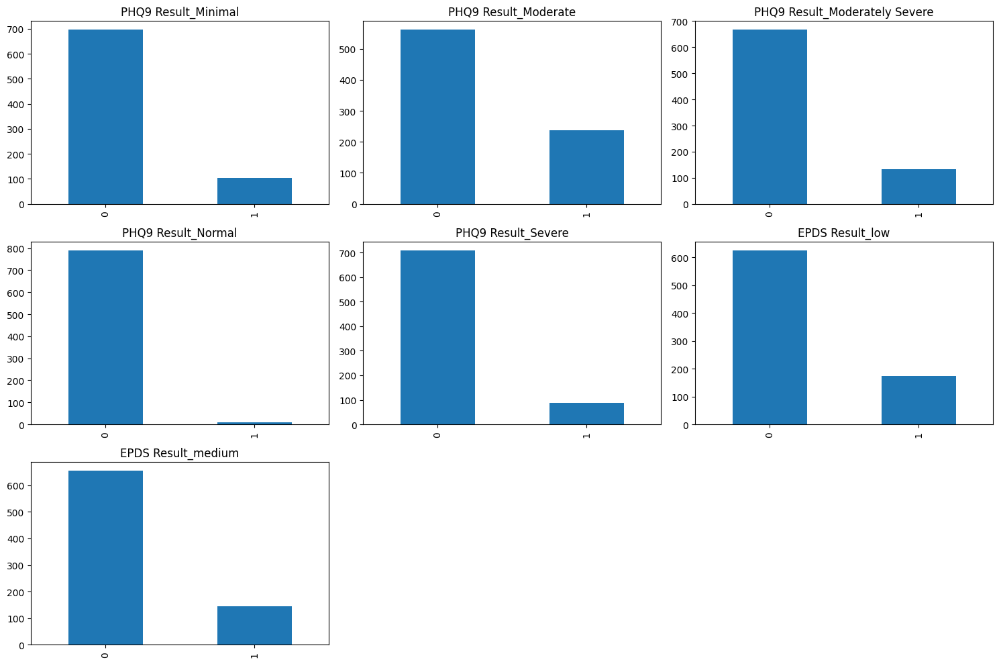

Class distribution for PHQ9 Result_Minimal:
0    696
1    103
Name: PHQ9 Result_Minimal, dtype: int64
Class distribution for PHQ9 Result_Moderate:
0    561
1    238
Name: PHQ9 Result_Moderate, dtype: int64
Class distribution for PHQ9 Result_Moderately Severe:
0    667
1    132
Name: PHQ9 Result_Moderately Severe, dtype: int64
Class distribution for PHQ9 Result_Normal:
0    791
1      8
Name: PHQ9 Result_Normal, dtype: int64
Class distribution for PHQ9 Result_Severe:
0    710
1     89
Name: PHQ9 Result_Severe, dtype: int64
Class distribution for EPDS Result_low:
0    626
1    173
Name: EPDS Result_low, dtype: int64
Class distribution for EPDS Result_medium:
0    655
1    144
Name: EPDS Result_medium, dtype: int64
Missing Values Percentage:
Age                                         0.0
Residence                                   0.0
Marital status                              0.0
Family type                                 0.0
Major changes or losses during pregnancy    0.0
           

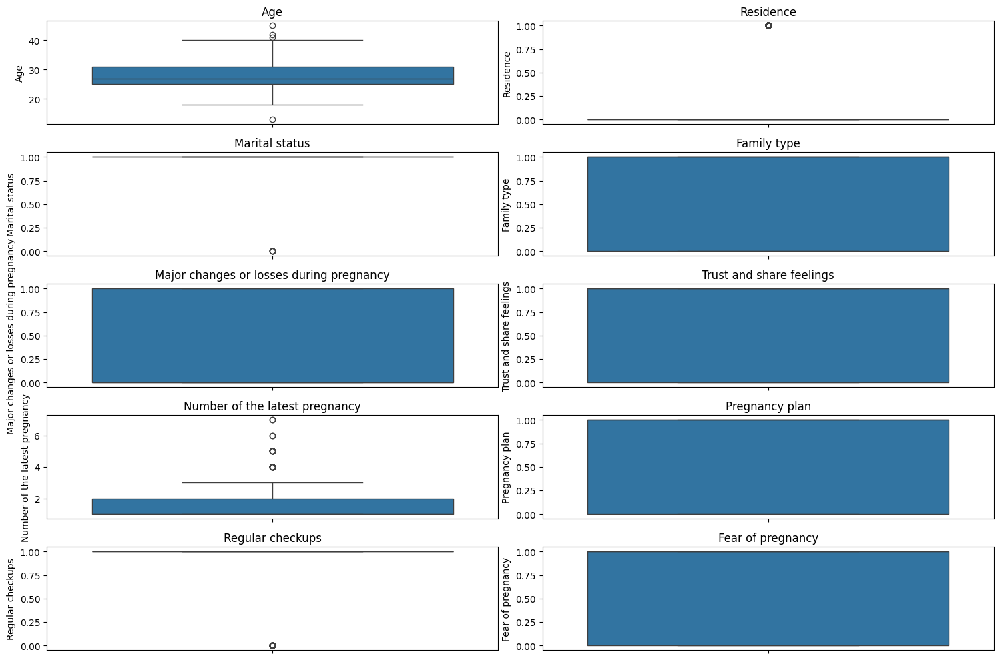

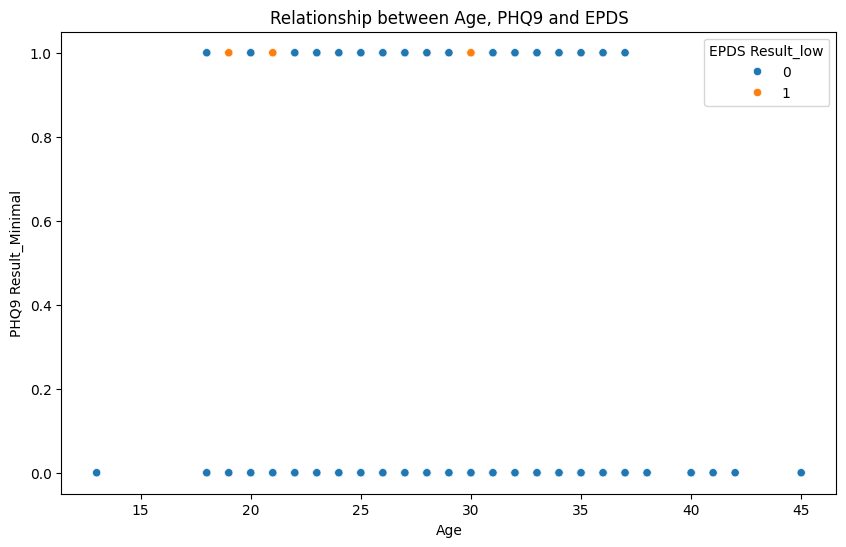

In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

# Analyze Target Variable Distributions
target_columns = ['PHQ9 Result_Minimal', 'PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Normal', 'PHQ9 Result_Severe', 'EPDS Result_low', 'EPDS Result_medium']
plt.figure(figsize=(15, 10))
for i, col in enumerate(target_columns):
    plt.subplot(3, 3, i + 1)
    df[col].value_counts().plot(kind='bar')
    plt.title(col)
plt.tight_layout()
plt.show()

for col in target_columns:
    print(f"Class distribution for {col}:")
    print(df[col].value_counts())

# Identify Missing Values
missing_values = df.isnull().sum()
missing_percentage = (missing_values / len(df)) * 100
print("Missing Values Percentage:")
print(missing_percentage)

# Examine Relationships Between Features and Targets
numerical_features = df.select_dtypes(include=['number']).columns
plt.figure(figsize=(15, 10))  # Adjust figure size
for i, col in enumerate(numerical_features[:10]): # Limit for demonstration
    plt.subplot(5, 2, i + 1)
    sns.boxplot(y=df[col])
    plt.title(col)
plt.tight_layout()
plt.show()

# Example visualization for the first numerical feature and target variables.
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df[numerical_features[0]], y=df['PHQ9 Result_Minimal'], hue=df['EPDS Result_low'])
plt.title(f'Relationship between {numerical_features[0]}, PHQ9 and EPDS')
plt.show()


In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Identify categorical columns
categorical_cols = df.select_dtypes(include=['object', 'category']).columns

# One-hot encode categorical features
df = pd.get_dummies(df, columns=categorical_cols, drop_first=True)

# Separate features and target variables
target_cols = ['PHQ9 Result_Minimal', 'PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Normal', 'PHQ9 Result_Severe', 'EPDS Result_low', 'EPDS Result_medium']
X = df.drop(columns=target_cols)
y = df[target_cols]

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

display(X_train.head())
display(y_train.head())
print(X_train.shape)
print(y_train.shape)

,Age,Residence,Marital status,Family type,Major changes or losses during pregnancy,Trust and share feelings,Number of the latest pregnancy,Pregnancy plan,Regular checkups,Fear of pregnancy,...,Age of newborn_1 year to 1.5 year,Age of newborn_6 months to 1 year,Age of newborn_Older than 1.5 year,Age of immediate older children_1yr to 3yr,Age of immediate older children_4yr to 6yr,Age of immediate older children_7yr to 12yr,Age of immediate older children_None,Feeling for regular activities_None,Feeling for regular activities_Tired,Feeling for regular activities_Worried
264,30,0,1,1,1,0,1,1,1,1,...,1,0,0,0,0,0,1,0,1,0
615,26,0,1,1,0,1,1,1,1,1,...,0,1,0,0,0,0,1,0,1,0
329,25,0,1,1,0,1,1,1,1,1,...,0,0,0,0,0,0,1,0,0,0
342,30,1,1,1,1,0,2,1,1,1,...,1,0,0,0,0,0,1,0,1,0
394,22,0,1,0,0,1,1,0,1,1,...,1,0,0,0,1,0,0,1,0,0


,PHQ9 Result_Minimal,PHQ9 Result_Moderate,PHQ9 Result_Moderately Severe,PHQ9 Result_Normal,PHQ9 Result_Severe,EPDS Result_low,EPDS Result_medium
264,0,1,0,0,0,0,1
615,0,1,0,0,0,0,0
329,0,0,1,0,0,0,0
342,0,1,0,0,0,0,1
394,0,1,0,0,0,0,1


(639, 112)
(639, 7)


In [8]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Example interaction feature:  Combine 'PHQ9 Score' and 'EPDS Score'
X_train['PHQ9_EPDS_Interaction'] = X_train['PHQ9 Score'] * X_train['EPDS Score']

# Split training data into training and validation sets
X_train_subset, X_val, y_train_subset, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42
)

# Train a decision tree on the subset without the interaction feature
dt_no_interaction = DecisionTreeClassifier(random_state=42)
dt_no_interaction.fit(X_train_subset.drop(columns=['PHQ9_EPDS_Interaction']), y_train_subset)
y_pred_no_interaction = dt_no_interaction.predict(X_val.drop(columns=['PHQ9_EPDS_Interaction']))
accuracy_no_interaction = accuracy_score(y_val, y_pred_no_interaction)

# Train a decision tree on the subset with the interaction feature
dt_interaction = DecisionTreeClassifier(random_state=42)
dt_interaction.fit(X_train_subset, y_train_subset)
y_pred_interaction = dt_interaction.predict(X_val)
accuracy_interaction = accuracy_score(y_val, y_pred_interaction)

print(f"Accuracy without interaction feature: {accuracy_no_interaction}")
print(f"Accuracy with interaction feature: {accuracy_interaction}")

# Apply transformation to test set if interaction feature improves performance
if accuracy_interaction > accuracy_no_interaction:
    X_test['PHQ9_EPDS_Interaction'] = X_test['PHQ9 Score'] * X_test['EPDS Score']
    X_train_engineered = X_train.copy()
    X_test_engineered = X_test.copy()
    print("Interaction feature improved performance.  Applying transformation to test set.")

else:
    X_train_engineered = X_train.copy()
    X_test_engineered = X_test.copy()
    print("Interaction feature did not improve performance.")


Accuracy without interaction feature: 0.875
Accuracy with interaction feature: 0.8671875
Interaction feature did not improve performance.


In [9]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier

# Initialize classifiers with class_weight='balanced' and random_state
classifiers = {
    'RandomForest': RandomForestClassifier(class_weight='balanced', random_state=42),
    'SVM': SVC(class_weight='balanced', random_state=42),
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='logloss', class_weight='balanced', random_state=42),
    'DecisionTree': DecisionTreeClassifier(class_weight='balanced', random_state=42),
    'LogisticRegression': LogisticRegression(class_weight='balanced', random_state=42),
    'GradientBoosting': GradientBoostingClassifier(random_state=42)
}

target_variables = y_train.columns

trained_models = {}
for target_variable in target_variables:
    for model_name, model in classifiers.items():
        try:
            model.fit(X_train_engineered, y_train[target_variable])
            trained_models[(model_name, target_variable)] = model
            print(f"Successfully trained {model_name} model on {target_variable}")
        except Exception as e:
            print(f"Error training {model_name} model on {target_variable}: {e}")

Successfully trained RandomForest model on PHQ9 Result_Minimal
Successfully trained SVM model on PHQ9 Result_Minimal
Successfully trained XGBoost model on PHQ9 Result_Minimal
Successfully trained DecisionTree model on PHQ9 Result_Minimal


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:08] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained LogisticRegression model on PHQ9 Result_Minimal
Successfully trained GradientBoosting model on PHQ9 Result_Minimal
Successfully trained RandomForest model on PHQ9 Result_Moderate
Successfully trained SVM model on PHQ9 Result_Moderate
Successfully trained XGBoost model on PHQ9 Result_Moderate
Successfully trained DecisionTree model on PHQ9 Result_Moderate
Successfully trained LogisticRegression model on PHQ9 Result_Moderate


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:08] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained GradientBoosting model on PHQ9 Result_Moderate
Successfully trained RandomForest model on PHQ9 Result_Moderately Severe
Successfully trained SVM model on PHQ9 Result_Moderately Severe


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:08] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained XGBoost model on PHQ9 Result_Moderately Severe
Successfully trained DecisionTree model on PHQ9 Result_Moderately Severe
Successfully trained LogisticRegression model on PHQ9 Result_Moderately Severe
Successfully trained GradientBoosting model on PHQ9 Result_Moderately Severe
Successfully trained RandomForest model on PHQ9 Result_Normal
Successfully trained SVM model on PHQ9 Result_Normal
Successfully trained XGBoost model on PHQ9 Result_Normal
Successfully trained DecisionTree model on PHQ9 Result_Normal
Successfully trained LogisticRegression model on PHQ9 Result_Normal


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:09] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained GradientBoosting model on PHQ9 Result_Normal
Successfully trained RandomForest model on PHQ9 Result_Severe
Successfully trained SVM model on PHQ9 Result_Severe
Successfully trained XGBoost model on PHQ9 Result_Severe
Successfully trained DecisionTree model on PHQ9 Result_Severe


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:09] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained LogisticRegression model on PHQ9 Result_Severe
Successfully trained GradientBoosting model on PHQ9 Result_Severe
Successfully trained RandomForest model on EPDS Result_low
Successfully trained SVM model on EPDS Result_low


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:09] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained XGBoost model on EPDS Result_low
Successfully trained DecisionTree model on EPDS Result_low
Successfully trained LogisticRegression model on EPDS Result_low
Successfully trained GradientBoosting model on EPDS Result_low
Successfully trained RandomForest model on EPDS Result_medium
Successfully trained SVM model on EPDS Result_medium


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:10] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\linear_model\_logistic.py:444: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Successfully trained XGBoost model on EPDS Result_medium
Successfully trained DecisionTree model on EPDS Result_medium
Successfully trained LogisticRegression model on EPDS Result_medium
Successfully trained GradientBoosting model on EPDS Result_medium


In [10]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform

# Define parameter grids for each model
param_grids = {
    'RandomForest': {
        'n_estimators': randint(50, 200),
        'max_depth': randint(10, 50),
        'min_samples_split': randint(2, 20)
    },
    'SVM': {
        'C': uniform(0.1, 10),
        'gamma': uniform(0.001, 1),
        'kernel': ['linear', 'rbf', 'poly']
    },
    'XGBoost': {
        'n_estimators': randint(50, 200),
        'max_depth': randint(3, 10),
        'learning_rate': uniform(0.01, 0.3)
    },
    'DecisionTree': {
        'max_depth': randint(10, 50),
        'min_samples_split': randint(2, 20),
        'min_samples_leaf': randint(1, 10)
    },
    'LogisticRegression': {
        'C': uniform(0.1, 10),
        'solver': ['liblinear', 'saga']
    },
    'GradientBoosting': {
        'n_estimators': randint(50, 200),
        'max_depth': randint(3, 10),
        'learning_rate': uniform(0.01, 0.3)
    }
}

best_models = {}
for (model_name, target_variable), model in trained_models.items():
    param_grid = param_grids.get(model_name)
    if param_grid:
        random_search = RandomizedSearchCV(model, param_distributions=param_grid, n_iter=50, scoring='accuracy', n_jobs=-1, cv=5, random_state=42)
        try:
            random_search.fit(X_train_engineered, y_train[target_variable])
            best_models[(model_name, target_variable)] = random_search.best_estimator_
            print(f"Best hyperparameters for {model_name} on {target_variable}: {random_search.best_params_}")
            print(f"Best accuracy for {model_name} on {target_variable}: {random_search.best_score_}")
        except ValueError as e:
            print(f"Error during hyperparameter tuning for {model_name} on {target_variable}: {e}")
    else:
        print(f"No parameter grid defined for {model_name}")

Best hyperparameters for RandomForest on PHQ9 Result_Minimal: {'max_depth': 45, 'min_samples_split': 9, 'n_estimators': 180}
Best accuracy for RandomForest on PHQ9 Result_Minimal: 0.9812253937007874
Best hyperparameters for SVM on PHQ9 Result_Minimal: {'C': 0.2563640674119393, 'gamma': 0.4244014807063696, 'kernel': 'linear'}
Best accuracy for SVM on PHQ9 Result_Minimal: 0.9624384842519685


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:03:33] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best hyperparameters for XGBoost on PHQ9 Result_Minimal: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for XGBoost on PHQ9 Result_Minimal: 0.9921628937007874
Best hyperparameters for DecisionTree on PHQ9 Result_Minimal: {'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 13}
Best accuracy for DecisionTree on PHQ9 Result_Minimal: 0.9953125
Best hyperparameters for LogisticRegression on PHQ9 Result_Minimal: {'C': 1.5092422497476266, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on PHQ9 Result_Minimal: 0.9468503937007874
Best hyperparameters for GradientBoosting on PHQ9 Result_Minimal: {'learning_rate': 0.2525192044349383, 'max_depth': 3, 'n_estimators': 139}
Best accuracy for GradientBoosting on PHQ9 Result_Minimal: 0.996875
Best hyperparameters for RandomForest on PHQ9 Result_Moderate: {'max_depth': 45, 'min_samples_split': 9, 'n_estimators': 180}
Best accuracy for RandomForest on PHQ9 Result_Moderate: 0.984375
Best hype

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:05:07] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best hyperparameters for XGBoost on PHQ9 Result_Moderate: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for XGBoost on PHQ9 Result_Moderate: 1.0
Best hyperparameters for DecisionTree on PHQ9 Result_Moderate: {'max_depth': 48, 'min_samples_leaf': 4, 'min_samples_split': 16}
Best accuracy for DecisionTree on PHQ9 Result_Moderate: 1.0
Best hyperparameters for LogisticRegression on PHQ9 Result_Moderate: {'C': 5.347746602583891, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on PHQ9 Result_Moderate: 0.8106668307086615
Best hyperparameters for GradientBoosting on PHQ9 Result_Moderate: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for GradientBoosting on PHQ9 Result_Moderate: 1.0
Best hyperparameters for RandomForest on PHQ9 Result_Moderately Severe: {'max_depth': 45, 'min_samples_split': 9, 'n_estimators': 180}
Best accuracy for RandomForest on PHQ9 Result_Moderately Severe: 0.9811884842519685


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:06:26] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best hyperparameters for XGBoost on PHQ9 Result_Moderately Severe: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for XGBoost on PHQ9 Result_Moderately Severe: 1.0
Best hyperparameters for DecisionTree on PHQ9 Result_Moderately Severe: {'max_depth': 48, 'min_samples_leaf': 4, 'min_samples_split': 16}
Best accuracy for DecisionTree on PHQ9 Result_Moderately Severe: 1.0
Best hyperparameters for LogisticRegression on PHQ9 Result_Moderately Severe: {'C': 6.175448519014383, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on PHQ9 Result_Moderately Severe: 0.8560162401574803
Best hyperparameters for GradientBoosting on PHQ9 Result_Moderately Severe: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for GradientBoosting on PHQ9 Result_Moderately Severe: 1.0


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\model_selection\_split.py:684: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


Best hyperparameters for RandomForest on PHQ9 Result_Normal: {'max_depth': 48, 'min_samples_split': 16, 'n_estimators': 156}
Best accuracy for RandomForest on PHQ9 Result_Normal: 0.9953125


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\model_selection\_split.py:684: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


Best hyperparameters for SVM on PHQ9 Result_Normal: {'C': 7.896910002727692, 'gamma': 0.597850157946487, 'kernel': 'rbf'}
Best accuracy for SVM on PHQ9 Result_Normal: 0.99375


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\model_selection\_split.py:684: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:06:58] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\model_selection\_split.py:684: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


Best hyperparameters for XGBoost on PHQ9 Result_Normal: {'learning_rate': 0.150028867974394, 'max_depth': 7, 'n_estimators': 100}
Best accuracy for XGBoost on PHQ9 Result_Normal: 0.996875
Best hyperparameters for DecisionTree on PHQ9 Result_Normal: {'max_depth': 30, 'min_samples_leaf': 1, 'min_samples_split': 13}
Best accuracy for DecisionTree on PHQ9 Result_Normal: 0.9984375


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\model_selection\_split.py:684: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


Best hyperparameters for LogisticRegression on PHQ9 Result_Normal: {'C': 6.086584841970366, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on PHQ9 Result_Normal: 0.9937376968503937


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\sklearn\model_selection\_split.py:684: UserWarning: The least populated class in y has only 4 members, which is less than n_splits=5.
  warnings.warn(


Best hyperparameters for GradientBoosting on PHQ9 Result_Normal: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for GradientBoosting on PHQ9 Result_Normal: 0.9984375
Best hyperparameters for RandomForest on PHQ9 Result_Severe: {'max_depth': 41, 'min_samples_split': 10, 'n_estimators': 162}
Best accuracy for RandomForest on PHQ9 Result_Severe: 0.9953001968503937
Best hyperparameters for SVM on PHQ9 Result_Severe: {'C': 1.6599452033620266, 'gamma': 0.05908361216819946, 'kernel': 'linear'}
Best accuracy for SVM on PHQ9 Result_Severe: 0.9984375


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:07:29] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best hyperparameters for XGBoost on PHQ9 Result_Severe: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for XGBoost on PHQ9 Result_Severe: 1.0
Best hyperparameters for DecisionTree on PHQ9 Result_Severe: {'max_depth': 48, 'min_samples_leaf': 4, 'min_samples_split': 16}
Best accuracy for DecisionTree on PHQ9 Result_Severe: 1.0
Best hyperparameters for LogisticRegression on PHQ9 Result_Severe: {'C': 3.845401188473625, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on PHQ9 Result_Severe: 0.9921628937007874
Best hyperparameters for GradientBoosting on PHQ9 Result_Severe: {'learning_rate': 0.12236203565420874, 'max_depth': 7, 'n_estimators': 64}
Best accuracy for GradientBoosting on PHQ9 Result_Severe: 1.0
Best hyperparameters for RandomForest on EPDS Result_low: {'max_depth': 48, 'min_samples_split': 7, 'n_estimators': 186}
Best accuracy for RandomForest on EPDS Result_low: 0.9405634842519686
Best hyperparameters for SVM on EPDS Result_

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:08:05] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best hyperparameters for XGBoost on EPDS Result_low: {'learning_rate': 0.2633601546034454, 'max_depth': 7, 'n_estimators': 131}
Best accuracy for XGBoost on EPDS Result_low: 0.9593257874015748
Best hyperparameters for DecisionTree on EPDS Result_low: {'max_depth': 28, 'min_samples_leaf': 7, 'min_samples_split': 12}
Best accuracy for DecisionTree on EPDS Result_low: 0.9608636811023622
Best hyperparameters for LogisticRegression on EPDS Result_low: {'C': 2.059828624191452, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on EPDS Result_low: 0.9248277559055118
Best hyperparameters for GradientBoosting on EPDS Result_low: {'learning_rate': 0.2140922615763339, 'max_depth': 3, 'n_estimators': 67}
Best accuracy for GradientBoosting on EPDS Result_low: 0.9608882874015748
Best hyperparameters for RandomForest on EPDS Result_medium: {'max_depth': 43, 'min_samples_split': 11, 'n_estimators': 63}
Best accuracy for RandomForest on EPDS Result_medium: 0.9374630905511812
Best hyperparamete

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:09:25] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Best hyperparameters for XGBoost on EPDS Result_medium: {'learning_rate': 0.012119891565915222, 'max_depth': 3, 'n_estimators': 98}
Best accuracy for XGBoost on EPDS Result_medium: 0.9499507874015748
Best hyperparameters for DecisionTree on EPDS Result_medium: {'max_depth': 33, 'min_samples_leaf': 6, 'min_samples_split': 3}
Best accuracy for DecisionTree on EPDS Result_medium: 0.9531003937007874
Best hyperparameters for LogisticRegression on EPDS Result_medium: {'C': 2.059828624191452, 'solver': 'liblinear'}
Best accuracy for LogisticRegression on EPDS Result_medium: 0.8060531496062993
Best hyperparameters for GradientBoosting on EPDS Result_medium: {'learning_rate': 0.05958008171890075, 'max_depth': 3, 'n_estimators': 120}
Best accuracy for GradientBoosting on EPDS Result_medium: 0.9499753937007874


In [11]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, matthews_corrcoef
import numpy as np

# Results dictionary
cv_results = {}

# Perform Stratified K-Fold Cross-Validation for each model and target
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for (model_name, target_variable), model in best_models.items():
    print(f"\nEvaluating {model_name} on {target_variable} with Stratified 5-Fold CV...")
    accuracies, f1s, precisions, recalls, aucs, mccs = [], [], [], [], [], []

    y_full = y[target_variable]

    for fold, (train_idx, val_idx) in enumerate(skf.split(X, y_full)):
        X_fold_train, X_fold_val = X.iloc[train_idx].copy(), X.iloc[val_idx].copy()
        y_fold_train, y_fold_val = y_full.iloc[train_idx], y_full.iloc[val_idx]

        # Add interaction feature if applicable
        if 'PHQ9 Score' in X.columns and 'EPDS Score' in X.columns:
            X_fold_train['PHQ9_EPDS_Interaction'] = X_fold_train['PHQ9 Score'] * X_fold_train['EPDS Score']
            X_fold_val['PHQ9_EPDS_Interaction'] = X_fold_val['PHQ9 Score'] * X_fold_val['EPDS Score']

        try:
            model.fit(X_fold_train, y_fold_train)
            y_pred = model.predict(X_fold_val)

            acc = accuracy_score(y_fold_val, y_pred)
            f1 = f1_score(y_fold_val, y_pred, average='binary')
            prec = precision_score(y_fold_val, y_pred, zero_division=0)
            rec = recall_score(y_fold_val, y_pred, zero_division=0)
            auc = roc_auc_score(y_fold_val, y_pred)
            mcc = matthews_corrcoef(y_fold_val, y_pred)

            accuracies.append(acc)
            f1s.append(f1)
            precisions.append(prec)
            recalls.append(rec)
            aucs.append(auc)
            mccs.append(mcc)

            print(f"  Fold {fold + 1}: Accuracy={acc:.4f}, F1={f1:.4f}, Precision={prec:.4f}, Recall={rec:.4f}, AUC={auc:.4f}, MCC={mcc:.4f}")
        
        except Exception as e:
            print(f"  Error in fold {fold + 1} for {model_name} on {target_variable}: {e}")

    # Store average scores
    cv_results[(model_name, target_variable)] = {
        'Accuracy': np.mean(accuracies),
        'F1': np.mean(f1s),
        'Precision': np.mean(precisions),
        'Recall': np.mean(recalls),
        'AUC': np.mean(aucs),
        'MCC': np.mean(mccs)
    }

# Print overall results
print("\n=== Cross-Validation Summary ===")
for (model, target), scores in cv_results.items():
    print(f"\nModel: {model} | Target: {target}")
    for metric, value in scores.items():
        print(f"  {metric}: {value:.4f}")



Evaluating RandomForest on PHQ9 Result_Minimal with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9938, F1=0.9756, Precision=0.9524, Recall=1.0000, AUC=0.9964, MCC=0.9724
  Fold 2: Accuracy=0.9688, F1=0.8780, Precision=0.9000, Recall=0.8571, AUC=0.9214, MCC=0.8605
  Fold 3: Accuracy=0.9812, F1=0.9302, Precision=0.9091, Recall=0.9524, AUC=0.9690, MCC=0.9197
  Fold 4: Accuracy=0.9688, F1=0.8837, Precision=0.8636, Recall=0.9048, AUC=0.9416, MCC=0.8660
  Fold 5: Accuracy=0.9811, F1=0.9268, Precision=0.9048, Recall=0.9500, AUC=0.9678, MCC=0.9164

Evaluating SVM on PHQ9 Result_Minimal with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9875, F1=0.9500, Precision=0.9500, Recall=0.9500, AUC=0.9714, MCC=0.9429
  Fold 2: Accuracy=0.9500, F1=0.8261, Precision=0.7600, Recall=0.9048, AUC=0.9308, MCC=0.8013
  Fold 3: Accuracy=0.9500, F1=0.8261, Precision=0.7600, Recall=0.9048, AUC=0.9308, MCC=0.8013
  Fold 4: Accuracy=0.9437, F1=0.8235, Precision=0.7000, Recall=1.0000, AUC=0.9676, MCC=0.8091
  Fold 5:

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:09:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:09:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 1: Accuracy=0.9938, F1=0.9744, Precision=1.0000, Recall=0.9500, AUC=0.9750, MCC=0.9712
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:09:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:09:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:09:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating DecisionTree on PHQ9 Result_Minimal with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9875, F1=0.9474, Precision=1.0000, Recall=0.9000, AUC=0.9500, MCC=0.9420
  Fold 2: Accuracy=0.9875, F1=0.9500, Precision=1.0000, Recall=0.9048, AUC=0.9524, MCC=0.9444
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating LogisticRegression on PHQ9 Result_Minimal with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9688, F1=0.8780, Precision=0.8571, Recall=0.9000, AUC=0.9393, MCC=0.8605
  Fold 2: Accuracy=0.9000, F1=0.7037, Precision=0.5758, Recall=0.9048, AUC=0.9020, MCC=0.6710
  Fold 3: Accuracy=0.9062, F1=0.7273, Precision=0.5882, Recall=0.9524, AUC=0.9258, MCC=0

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating DecisionTree on PHQ9 Result_Moderate with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating LogisticRegression on PHQ9 Result_Moderate with Stratified 5-Fold CV...


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 1: Accuracy=0.8063, F1=0.7156, Precision=0.6393, Recall=0.8125, AUC=0.8080, MCC=0.5813
  Fold 2: Accuracy=0.8375, F1=0.7547, Precision=0.6897, Recall=0.8333, AUC=0.8363, MCC=0.6412
  Fold 3: Accuracy=0.8313, F1=0.7568, Precision=0.6667, Recall=0.8750, AUC=0.8438, MCC=0.6448
  Fold 4: Accuracy=0.8250, F1=0.7455, Precision=0.6508, Recall=0.8723, AUC=0.8388, MCC=0.6317
  Fold 5: Accuracy=0.8679, F1=0.8037, Precision=0.7167, Recall=0.9149, AUC=0.8816, MCC=0.7184

Evaluating GradientBoosting on PHQ9 Result_Moderate with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, A

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:13] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:14] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:14] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:14] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating DecisionTree on PHQ9 Result_Moderately Severe with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating LogisticRegression on PHQ9 Result_Moderately Severe with Stratified 5-Fold CV...


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:14] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 1: Accuracy=0.8375, F1=0.5667, Precision=0.5000, Recall=0.6538, AUC=0.7635, MCC=0.4752
  Fold 2: Accuracy=0.8750, F1=0.6552, Precision=0.5938, Recall=0.7308, AUC=0.8169, MCC=0.5845
  Fold 3: Accuracy=0.8625, F1=0.6333, Precision=0.5758, Recall=0.7037, AUC=0.7992, MCC=0.5539
  Fold 4: Accuracy=0.8812, F1=0.7077, Precision=0.6053, Recall=0.8519, AUC=0.8695, MCC=0.6505
  Fold 5: Accuracy=0.8491, F1=0.6250, Precision=0.5263, Recall=0.7692, AUC=0.8169, MCC=0.5497

Evaluating GradientBoosting on PHQ9 Result_Moderately Severe with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:15] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:16] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 2: Accuracy=0.9938, F1=0.6667, Precision=1.0000, Recall=0.5000, AUC=0.7500, MCC=0.7049
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:16] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:16] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating DecisionTree on PHQ9 Result_Normal with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=0.9938, F1=0.6667, Precision=1.0000, Recall=0.5000, AUC=0.7500, MCC=0.7049
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating LogisticRegression on PHQ9 Result_Normal with Stratified 5-Fold CV...


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:16] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 1: Accuracy=0.9875, F1=0.5000, Precision=0.3333, Recall=1.0000, AUC=0.9937, MCC=0.5737
  Fold 2: Accuracy=0.9938, F1=0.6667, Precision=1.0000, Recall=0.5000, AUC=0.7500, MCC=0.7049
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=0.9937, F1=0.6667, Precision=0.5000, Recall=1.0000, AUC=0.9968, MCC=0.7049

Evaluating GradientBoosting on PHQ9 Result_Normal with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=0.9938, F1=0.6667, Precision=1.0000, Recall=0.5000, AUC=0.7500, MCC=0.7049
  Fold 3: Accuracy=0.9938, F1=0.6667, Precision=1.0000, Recall=0.5000, AUC=0.7500, MCC=0.7049
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:17] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating DecisionTree on PHQ9 Result_Severe with Stratified 5-Fold CV...
  Fold 1: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 4: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 5: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000

Evaluating LogisticRegression on PHQ9 Result_Severe with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9875, F1=0.9474, Precision=0.9000, Recall=1.0000, AUC=0.9930, MCC=0.9420
  Fold 2: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0000
  Fold 3: Accuracy=1.0000, F1=1.0000, Precision=1.0000, Recall=1.0000, AUC=1.0000, MCC=1.0

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:20] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 1: Accuracy=0.9500, F1=0.8824, Precision=0.8824, Recall=0.8824, AUC=0.9253, MCC=0.8506


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:20] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 2: Accuracy=0.9688, F1=0.9315, Precision=0.8947, Recall=0.9714, AUC=0.9697, MCC=0.9126


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:20] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 3: Accuracy=0.9625, F1=0.9118, Precision=0.9394, Recall=0.8857, AUC=0.9349, MCC=0.8886


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:20] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 4: Accuracy=0.9500, F1=0.8919, Precision=0.8462, Recall=0.9429, AUC=0.9474, MCC=0.8616


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:21] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 5: Accuracy=0.9434, F1=0.8657, Precision=0.8788, Recall=0.8529, AUC=0.9105, MCC=0.8300

Evaluating DecisionTree on EPDS Result_low with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9500, F1=0.8919, Precision=0.8250, Recall=0.9706, AUC=0.9575, MCC=0.8645
  Fold 2: Accuracy=0.9375, F1=0.8750, Precision=0.7778, Recall=1.0000, AUC=0.9600, MCC=0.8459
  Fold 3: Accuracy=0.9750, F1=0.9444, Precision=0.9189, Recall=0.9714, AUC=0.9737, MCC=0.9289
  Fold 4: Accuracy=0.9375, F1=0.8718, Precision=0.7907, Recall=0.9714, AUC=0.9497, MCC=0.8387
  Fold 5: Accuracy=0.9308, F1=0.8533, Precision=0.7805, Recall=0.9412, AUC=0.9346, MCC=0.8146

Evaluating LogisticRegression on EPDS Result_low with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9250, F1=0.8333, Precision=0.7895, Recall=0.8824, AUC=0.9094, MCC=0.7872
  Fold 2: Accuracy=0.9062, F1=0.8052, Precision=0.7381, Recall=0.8857, AUC=0.8989, MCC=0.7495
  Fold 3: Accuracy=0.9313, F1=0.8451, Precision=0.8333, Recall=0.8571, AUC=0.9046, MCC=0.8010
  

C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:25] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:25] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 2: Accuracy=0.9563, F1=0.8923, Precision=0.8056, Recall=1.0000, AUC=0.9733, MCC=0.8732
  Fold 3: Accuracy=0.9375, F1=0.8148, Precision=0.8800, Recall=0.7586, AUC=0.8679, MCC=0.7806


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:26] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:26] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 4: Accuracy=0.9375, F1=0.8529, Precision=0.7436, Recall=1.0000, AUC=0.9618, MCC=0.8288
  Fold 5: Accuracy=0.9560, F1=0.8889, Precision=0.8000, Recall=1.0000, AUC=0.9733, MCC=0.8702

Evaluating DecisionTree on EPDS Result_medium with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9375, F1=0.8387, Precision=0.7879, Recall=0.8966, AUC=0.9216, MCC=0.8027
  Fold 2: Accuracy=0.9437, F1=0.8475, Precision=0.8333, Recall=0.8621, AUC=0.9120, MCC=0.8132


C:\Users\user1\anaconda3\envs\causal_env\lib\site-packages\xgboost\core.py:158: UserWarning: [22:10:26] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "class_weight", "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


  Fold 3: Accuracy=0.9313, F1=0.8254, Precision=0.7647, Recall=0.8966, AUC=0.9177, MCC=0.7868
  Fold 4: Accuracy=0.9313, F1=0.8358, Precision=0.7368, Recall=0.9655, AUC=0.9446, MCC=0.8049
  Fold 5: Accuracy=0.9686, F1=0.9180, Precision=0.8485, Recall=1.0000, AUC=0.9809, MCC=0.9034

Evaluating LogisticRegression on EPDS Result_medium with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.8500, F1=0.6364, Precision=0.5676, Recall=0.7241, AUC=0.8010, MCC=0.5500
  Fold 2: Accuracy=0.7625, F1=0.4865, Precision=0.4000, Recall=0.6207, AUC=0.7073, MCC=0.3552
  Fold 3: Accuracy=0.7812, F1=0.5205, Precision=0.4318, Recall=0.6552, AUC=0.7322, MCC=0.4006
  Fold 4: Accuracy=0.8375, F1=0.6750, Precision=0.5294, Recall=0.9310, AUC=0.8739, MCC=0.6182
  Fold 5: Accuracy=0.8176, F1=0.5915, Precision=0.4884, Recall=0.7500, AUC=0.7910, MCC=0.4991

Evaluating GradientBoosting on EPDS Result_medium with Stratified 5-Fold CV...
  Fold 1: Accuracy=0.9437, F1=0.8571, Precision=0.7941, Recall=0.9310, AUC=0.9388, MCC

In [12]:
# Convert results to DataFrame
cv_df = pd.DataFrame([
    {'Model': model, 'Target': target, **metrics}
    for (model, target), metrics in cv_results.items()
])

# Save to CSV
cv_df.to_csv('cv_results_summary.csv', index=False)
print("\nCross-validation results saved to 'cv_results_summary.csv'")



Cross-validation results saved to 'cv_results_summary.csv'


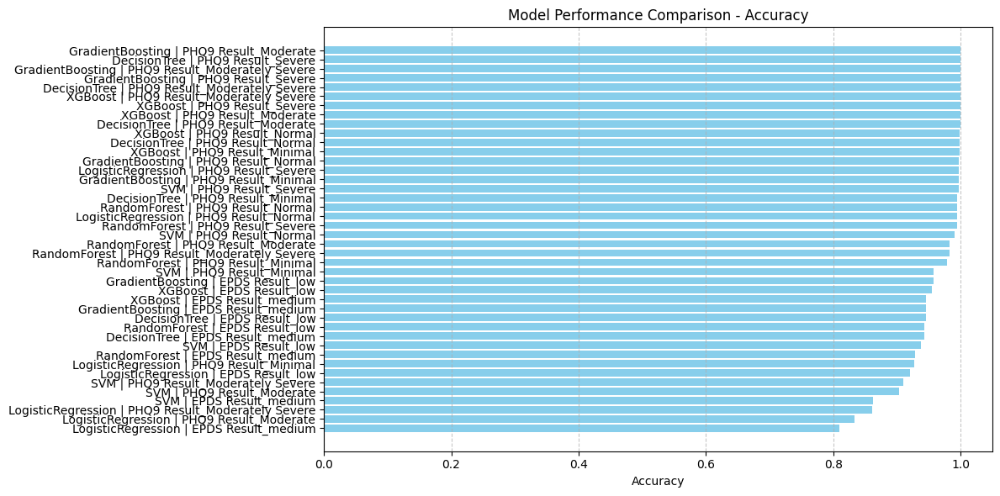

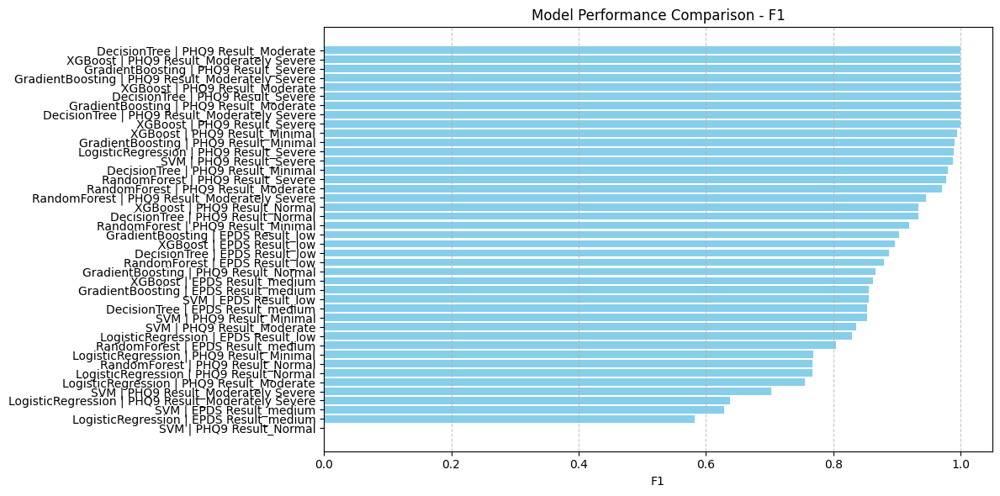

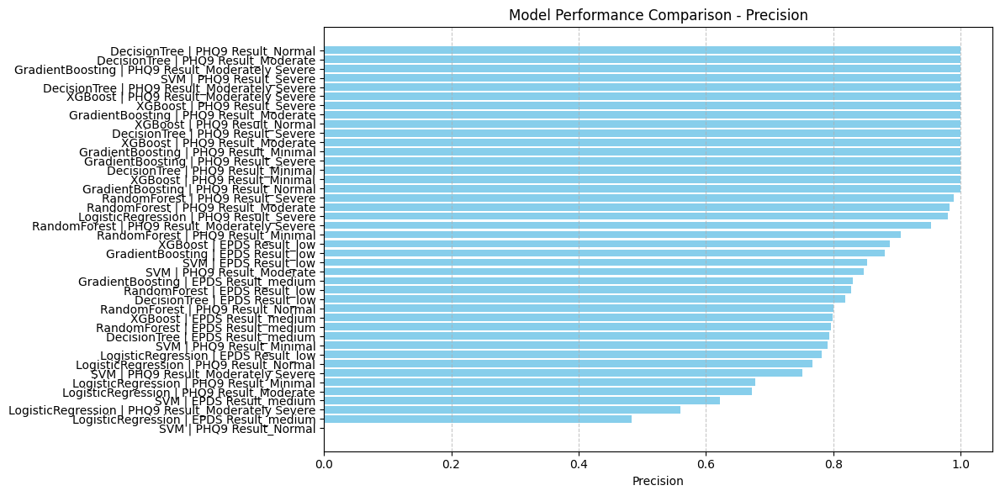

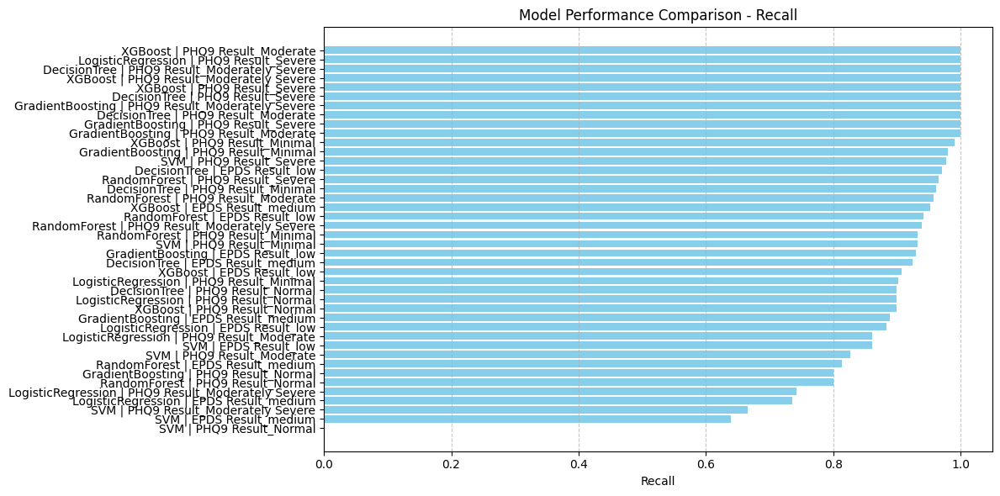

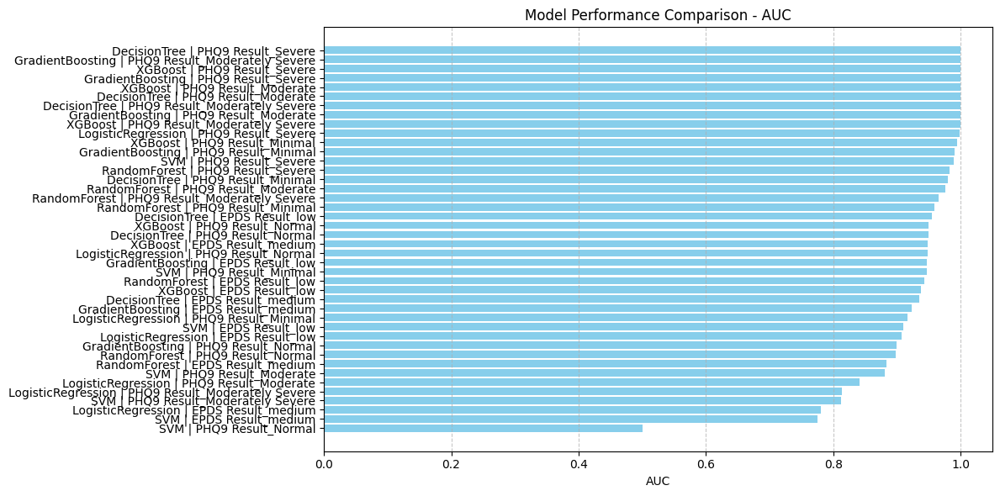

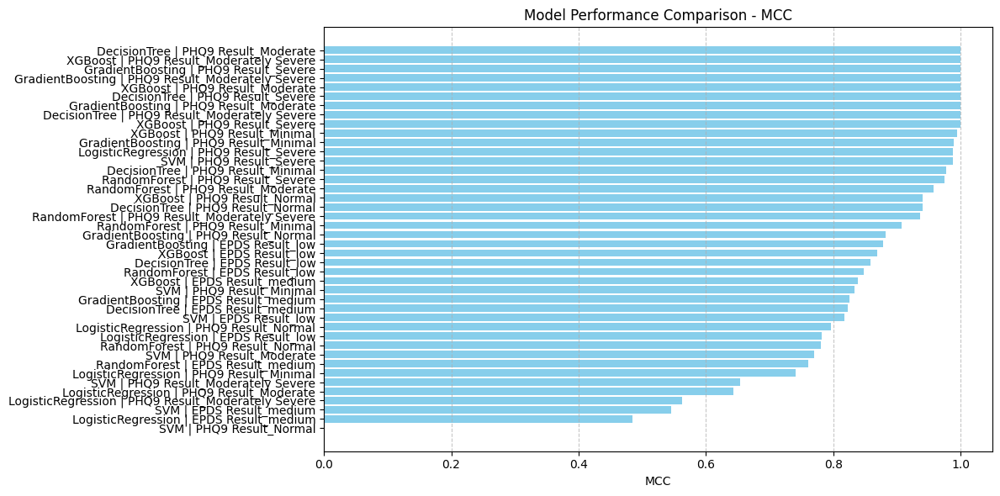

In [13]:
import matplotlib.pyplot as plt

metrics_to_plot = ['Accuracy', 'F1', 'Precision', 'Recall', 'AUC', 'MCC']

for metric in metrics_to_plot:
    plt.figure(figsize=(12, 6))
    sorted_df = cv_df.sort_values(by=metric, ascending=False)
    labels = sorted_df['Model'] + ' | ' + sorted_df['Target']
    plt.barh(labels, sorted_df[metric], color='skyblue')
    plt.xlabel(metric)
    plt.title(f'Model Performance Comparison - {metric}')
    plt.gca().invert_yaxis()  # Highest on top
    plt.grid(axis='x', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()


In [14]:
!pip install causalnex dowhy pygraphviz


  Using cached causalnex-0.12.1-py3-none-any.whl.metadata (7.8 kB)
  Using cached numpy-1.23.5-cp39-cp39-win_amd64.whl.metadata (2.3 kB)
  Using cached pathos-0.3.4-py3-none-any.whl.metadata (11 kB)
  Using cached pgmpy-0.1.19-py3-none-any.whl.metadata (6.3 kB)
  Using cached pyvis-0.3.2-py3-none-any.whl.metadata (1.7 kB)
  Using cached torch-2.7.1-cp39-cp39-win_amd64.whl.metadata (28 kB)
  Using cached ppft-1.7.7-py3-none-any.whl.metadata (12 kB)
  Using cached dill-0.4.0-py3-none-any.whl.metadata (10 kB)
  Using cached pox-0.3.6-py3-none-any.whl.metadata (8.0 kB)
  Using cached multiprocess-0.70.18-py39-none-any.whl.metadata (7.5 kB)
  Using cached jsonpickle-4.1.1-py3-none-any.whl.metadata (8.1 kB)
  Using cached filelock-3.18.0-py3-none-any.whl.metadata (2.9 kB)
  Using cached fsspec-2025.5.1-py3-none-any.whl.metadata (11 kB)
Using cached causalnex-0.12.1-py3-none-any.whl (153 kB)
Using cached numpy-1.23.5-cp39-cp39-win_amd64.whl (14.7 MB)
Using cached pgmpy-0.1.19-py3-none-any.whl

  You can safely remove it manually.


In [15]:
# Select a manageable subset of features for causal discovery
causal_features = [
    'Fear of pregnancy', 'Major changes or losses during pregnancy', 'Trust and share feelings',
    'Depression during pregnancy', 'Depression before pregnancy',
    'PHQ9 Score', 'EPDS Score', 'PHQ9 Result_Severe', 'EPDS Result_medium'
]

causal_df = df[causal_features].copy()

# Optional: Check for any missing values
causal_df = causal_df.dropna()


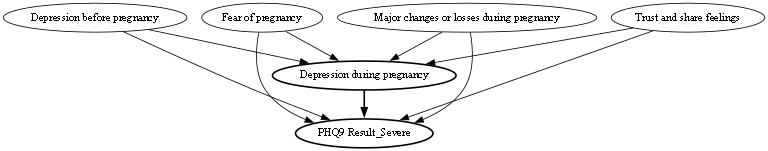

In [16]:
from dowhy import CausalModel
import matplotlib.pyplot as plt
import PIL.Image
from IPython.display import display

# Example variables
treatment = "Depression during pregnancy"
outcome = "PHQ9 Result_Severe"
common_causes = [
    "Depression before pregnancy", "Fear of pregnancy",
    "Major changes or losses during pregnancy", "Trust and share feelings"
]

# Make sure 'causal_df' exists in your notebook
causal_model = CausalModel(
    data=causal_df,
    treatment=treatment,
    outcome=outcome,
    common_causes=common_causes
)

causal_model.view_model(layout="dot")
display(PIL.Image.open("causal_model.png"))


  0%|          | 0/25 [00:00<?, ?it/s]

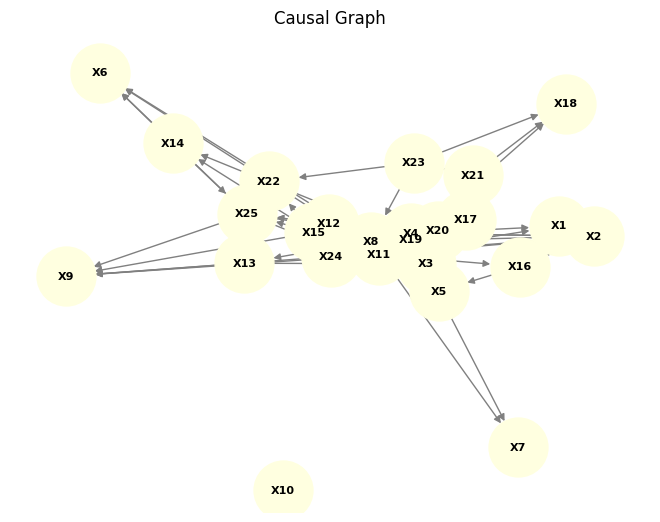

  0%|          | 0/24 [00:00<?, ?it/s]

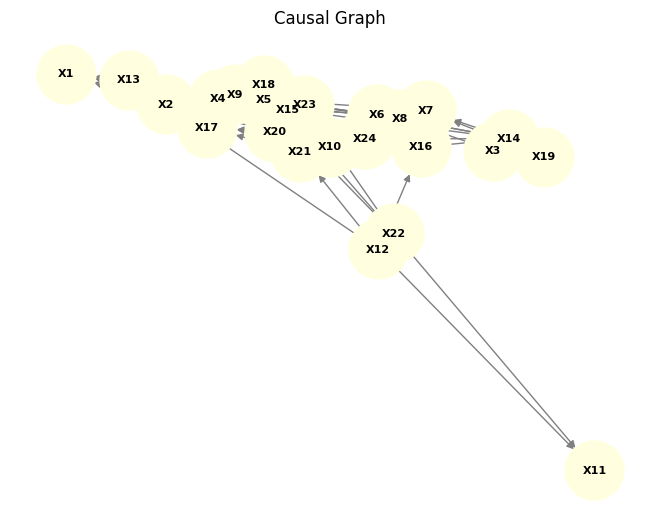

In [17]:
# === 1. Imports ===
import pandas as pd
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.cit import fisherz
import matplotlib.pyplot as plt
import networkx as nx

# === 2. Load Your Dataset ===
df = pd.read_csv('PPD_dataset_cleaned.csv')

# === 3. Create Binary Targets ===

# PHQ9: Depressed = Moderate OR Moderately Severe OR Severe
df['PHQ9_Depressed'] = df[['PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Severe']].max(axis=1)

# EPDS: Already one-hot encoded, use 'medium' as binary depressed
df['EPDS_Depressed'] = df['EPDS Result_medium']

# === 4. Define Feature Sets ===

phq9_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Major changes or losses during pregnancy',
    'Trust and share feelings', 'Pregnancy plan', 'Regular checkups',
    'Fear of pregnancy', 'Breastfeed', 'Newborn illness',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Relax/sleep when the newborn is asleep', 'Angry after latest child birth',
    'Occupation before latest pregnancy_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with husband_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Diseases during pregnancy_Chronic disease',
    'Feeling for regular activities_Tired',
    'PHQ9_Depressed'
]

epds_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Worry about newborn', 'Relax/sleep when the newborn is asleep',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Occupation After Your Latest Childbirth_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with the newborn_Neutral',
    'Relationship with husband_Poor',
    'Relationship with the in-laws_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Newborn illness', 'Breastfeed',
    'Feeling for regular activities_Worried',
    'Diseases during pregnancy_Chronic disease',
    'Birth compliancy',
    'Mode of delivery',
    'EPDS_Depressed'
]

# === 5. Utility to Plot Graph ===
import matplotlib.pyplot as plt
import networkx as nx

def plot_causal_graph(cg, labels):
    G = nx.DiGraph()

    # Step 0: Build name-to-index map (works even if get_name returns str)
    name_to_label = {}
    for idx, label in enumerate(labels):
        name_to_label[str(idx)] = label  # in case node names are stringified indices
        name_to_label[idx] = label       # or integers

    # Step 1: Add nodes
    for node in cg.G.get_nodes():
        G.add_node(node)

    # Step 2: Add edges
    for edge in cg.G.get_graph_edges():
        i = edge.get_node1()
        j = edge.get_node2()
        ep1 = edge.get_endpoint1()
        ep2 = edge.get_endpoint2()

        if ep1 == 'TAIL' and ep2 == 'ARROW':
            G.add_edge(i, j)
        elif ep1 == 'ARROW' and ep2 == 'TAIL':
            G.add_edge(j, i)
        else:
            G.add_edge(i, j)

    # Step 3: Label mapping using flexible str/int resolution
    node_labels = {}
    for node in G.nodes():
        name = node.get_name()
        node_labels[node] = name_to_label.get(name, str(name))  # fallback to name if missing

    # Step 4: Draw
    pos = nx.spring_layout(G, seed=42)
    nx.draw(G, pos, with_labels=True, labels=node_labels,
            node_color='lightyellow', edge_color='gray',
            node_size=1800, font_size=8, font_weight='bold', arrows=True)
    plt.title("Causal Graph")
    plt.show()



# === 6. Run Causal Discovery for PHQ9 ===
df_phq9 = df[phq9_columns].dropna()
data_phq9 = df_phq9.to_numpy()
cg_phq9 = pc(data_phq9, alpha=0.05, ci_test=fisherz)
plot_causal_graph(cg_phq9, df_phq9.columns.tolist())

# === 7. Run Causal Discovery for EPDS ===
df_epds = df[epds_columns].dropna()
data_epds = df_epds.to_numpy()
cg_epds = pc(data_epds, alpha=0.05, ci_test=fisherz)
plot_causal_graph(cg_epds, df_epds.columns.tolist())


  0%|          | 0/25 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\883561243.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


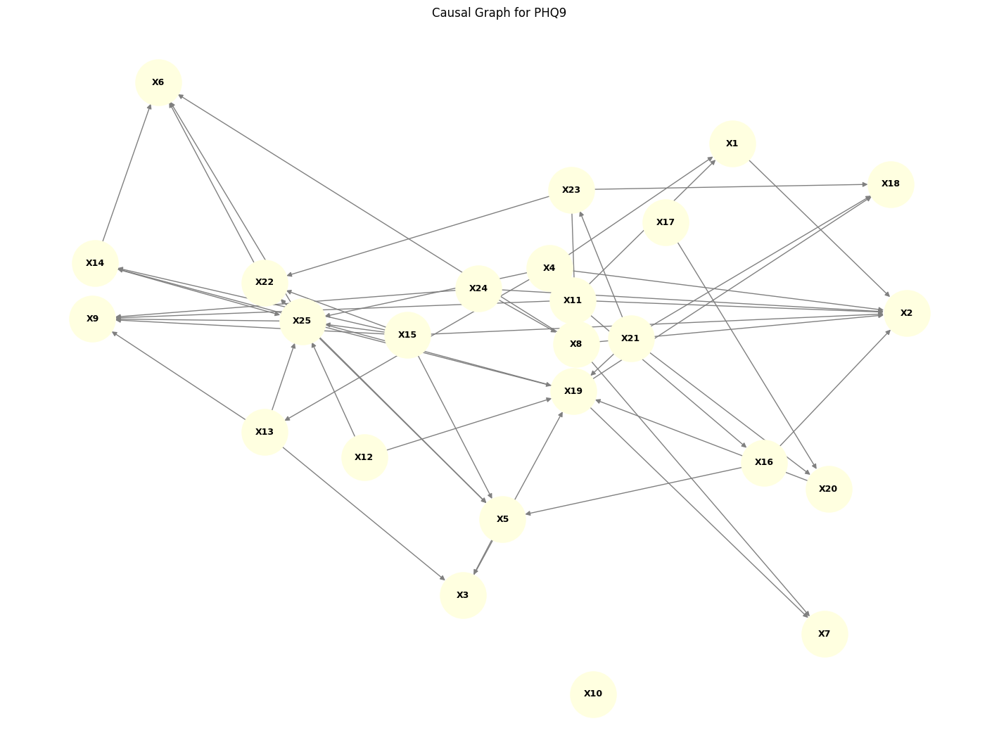

  0%|          | 0/24 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\883561243.py:96: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


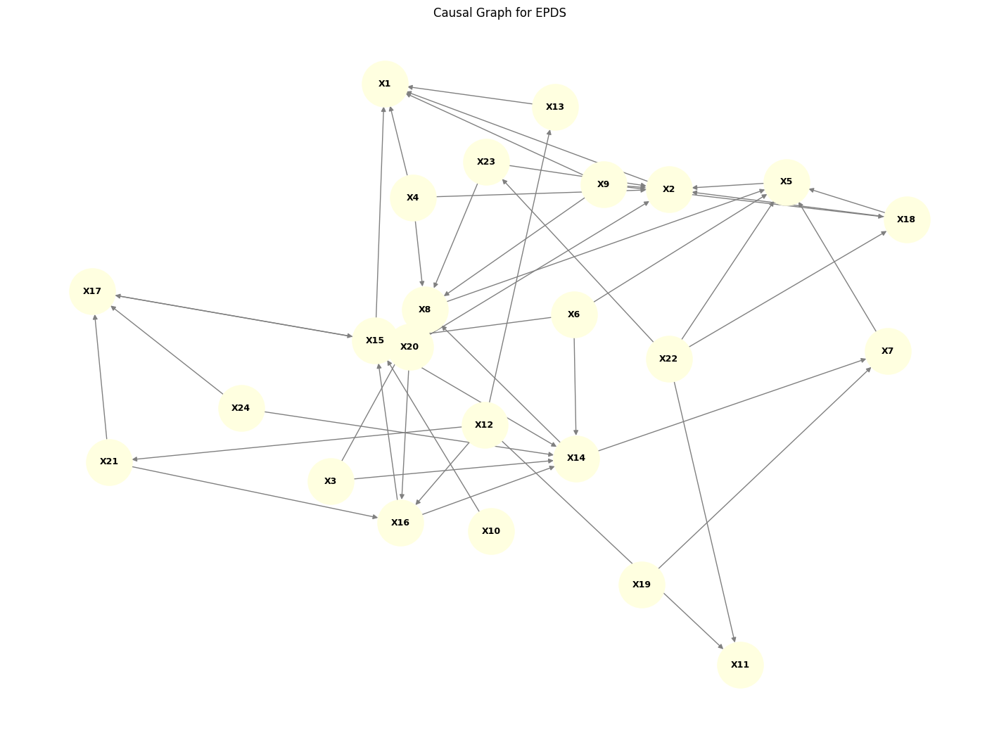

In [18]:
# === 1. Imports ===
import pandas as pd
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.cit import fisherz
import matplotlib.pyplot as plt
import networkx as nx

# === 2. Load Your Dataset ===
df = pd.read_csv('PPD_dataset_cleaned.csv')

# === 3. Create Binary Targets ===

# PHQ9: Depressed = Moderate OR Moderately Severe OR Severe
df['PHQ9_Depressed'] = df[['PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Severe']].max(axis=1)

# EPDS: Already one-hot encoded, use 'medium' as binary depressed
df['EPDS_Depressed'] = df['EPDS Result_medium']

# === 4. Define Feature Sets ===

phq9_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Major changes or losses during pregnancy',
    'Trust and share feelings', 'Pregnancy plan', 'Regular checkups',
    'Fear of pregnancy', 'Breastfeed', 'Newborn illness',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Relax/sleep when the newborn is asleep', 'Angry after latest child birth',
    'Occupation before latest pregnancy_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with husband_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Diseases during pregnancy_Chronic disease',
    'Feeling for regular activities_Tired',
    'PHQ9_Depressed'
]

epds_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Worry about newborn', 'Relax/sleep when the newborn is asleep',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Occupation After Your Latest Childbirth_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with the newborn_Neutral',
    'Relationship with husband_Poor',
    'Relationship with the in-laws_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Newborn illness', 'Breastfeed',
    'Feeling for regular activities_Worried',
    'Diseases during pregnancy_Chronic disease',
    'Birth compliancy',
    'Mode of delivery',
    'EPDS_Depressed'
]

# === 5. Utility to Plot Graph ===
def plot_causal_graph(cg, labels, title="Causal Graph"):
    G = nx.DiGraph()

    # Create node → label mapping
    name_to_label = {str(i): label for i, label in enumerate(labels)}

    # Add nodes
    for node in cg.G.get_nodes():
        G.add_node(node.get_name())  # Use name as string

    # Add edges
    for edge in cg.G.get_graph_edges():
        i = edge.get_node1().get_name()
        j = edge.get_node2().get_name()
        ep1 = edge.get_endpoint1()
        ep2 = edge.get_endpoint2()

        if ep1 == 'TAIL' and ep2 == 'ARROW':
            G.add_edge(i, j)
        elif ep1 == 'ARROW' and ep2 == 'TAIL':
            G.add_edge(j, i)
        else:
            G.add_edge(i, j)

    # Relabel with readable feature names
    G = nx.relabel_nodes(G, name_to_label)

    # Plot
    plt.figure(figsize=(14, 10))
    pos = nx.spring_layout(G, k=0.7, seed=42)
    nx.draw(G, pos, with_labels=True,
            node_color='lightyellow', edge_color='gray',
            node_size=2200, font_size=9, font_weight='bold', arrows=True)
    plt.title(title)
    plt.tight_layout()
    plt.show()


# === 6. Run Causal Discovery for PHQ9 ===
df_phq9 = df[phq9_columns].dropna()
data_phq9 = df_phq9.to_numpy()
cg_phq9 = pc(data_phq9, alpha=0.05, ci_test=fisherz)
plot_causal_graph(cg_phq9, df_phq9.columns.tolist(), title="Causal Graph for PHQ9")

# === 7. Run Causal Discovery for EPDS ===
df_epds = df[epds_columns].dropna()
data_epds = df_epds.to_numpy()
cg_epds = pc(data_epds, alpha=0.05, ci_test=fisherz)
plot_causal_graph(cg_epds, df_epds.columns.tolist(), title="Causal Graph for EPDS")


  0%|          | 0/25 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\2669928968.py:91: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


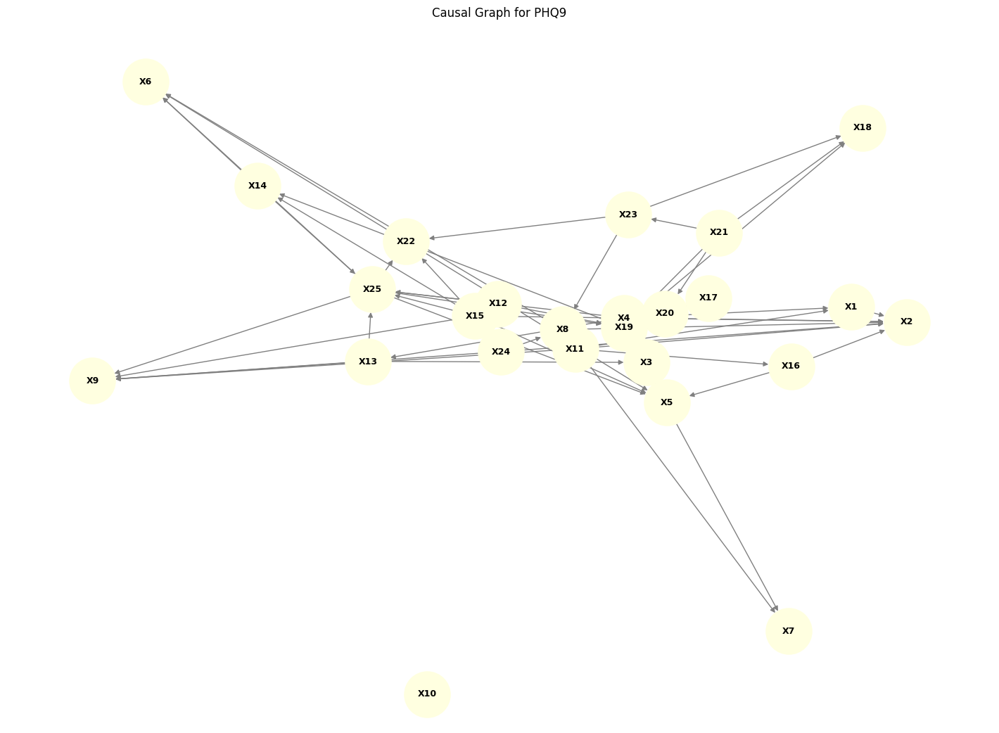


Direct causes of PHQ9_Depressed:

PHQ9 Graph: Total Nodes = 25, Total Edges = 51
Top 5 Influential Features (PHQ9):
 - X15: 6 edges
 - X25: 5 edges
 - X4: 4 edges
 - X11: 4 edges
 - X21: 4 edges


  0%|          | 0/24 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\2669928968.py:91: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


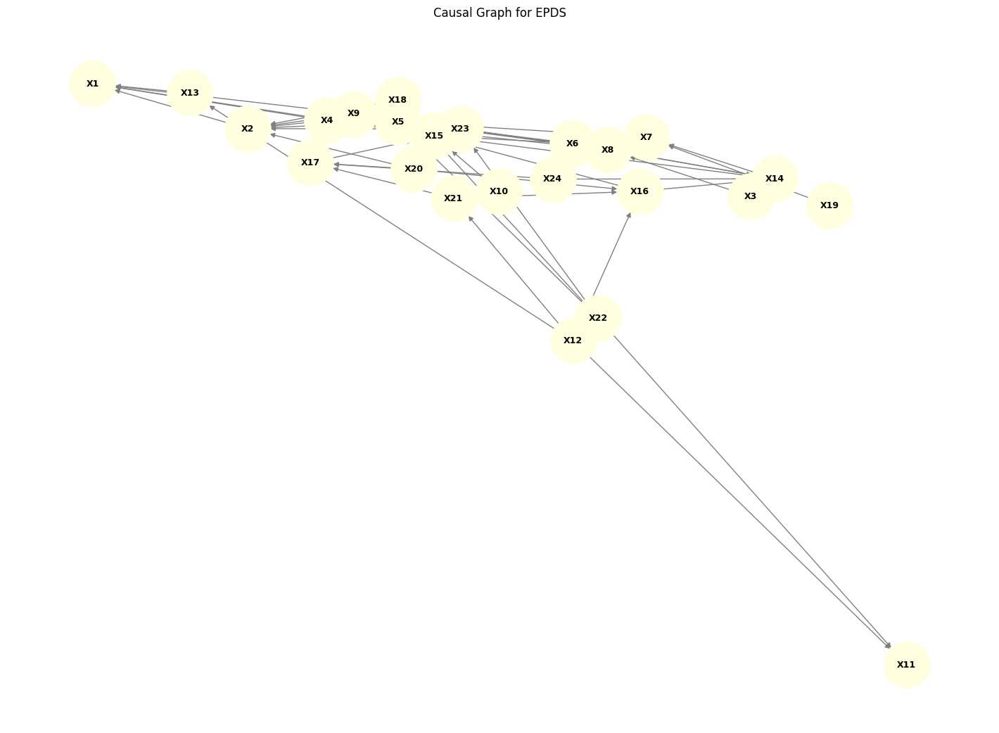


Direct causes of EPDS_Depressed:

EPDS Graph: Total Nodes = 24, Total Edges = 45
Top 5 Influential Features (EPDS):
 - X9: 4 edges
 - X12: 4 edges
 - X22: 4 edges
 - X4: 3 edges
 - X6: 3 edges


In [19]:
# === 1. Imports ===
import pandas as pd
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.cit import fisherz
import matplotlib.pyplot as plt
import networkx as nx

# === 2. Load Your Dataset ===
df = pd.read_csv('PPD_dataset_cleaned.csv')

# === 3. Create Binary Targets ===
df['PHQ9_Depressed'] = df[['PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Severe']].max(axis=1)
df['EPDS_Depressed'] = df['EPDS Result_medium']

# === 4. Define Feature Sets ===
phq9_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Major changes or losses during pregnancy',
    'Trust and share feelings', 'Pregnancy plan', 'Regular checkups',
    'Fear of pregnancy', 'Breastfeed', 'Newborn illness',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Relax/sleep when the newborn is asleep', 'Angry after latest child birth',
    'Occupation before latest pregnancy_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with husband_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Diseases during pregnancy_Chronic disease',
    'Feeling for regular activities_Tired',
    'PHQ9_Depressed'
]

epds_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Worry about newborn', 'Relax/sleep when the newborn is asleep',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Occupation After Your Latest Childbirth_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with the newborn_Neutral',
    'Relationship with husband_Poor',
    'Relationship with the in-laws_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Newborn illness', 'Breastfeed',
    'Feeling for regular activities_Worried',
    'Diseases during pregnancy_Chronic disease',
    'Birth compliancy',
    'Mode of delivery',
    'EPDS_Depressed'
]

# === 5. Utility to Plot Graph and Return Graph Object ===
def plot_causal_graph(cg, labels, title="Causal Graph"):
    G = nx.DiGraph()

    # Node name → label mapping
    name_to_label = {str(i): label for i, label in enumerate(labels)}

    # Add nodes
    for node in cg.G.get_nodes():
        G.add_node(node.get_name())

    # Add edges with direction
    for edge in cg.G.get_graph_edges():
        i = edge.get_node1().get_name()
        j = edge.get_node2().get_name()
        ep1 = edge.get_endpoint1()
        ep2 = edge.get_endpoint2()

        if ep1 == 'TAIL' and ep2 == 'ARROW':
            G.add_edge(i, j)
        elif ep1 == 'ARROW' and ep2 == 'TAIL':
            G.add_edge(j, i)
        else:
            G.add_edge(i, j)

    # Relabel using original feature names
    G = nx.relabel_nodes(G, name_to_label)

    # Plot
    plt.figure(figsize=(14, 10))
    pos = nx.spring_layout(G, seed=42)
    nx.draw(G, pos, with_labels=True,
            node_color='lightyellow', edge_color='gray',
            node_size=2200, font_size=9, font_weight='bold', arrows=True)
    plt.title(title)
    plt.tight_layout()
    plt.show()

    return G

# === 6. Run Causal Discovery for PHQ9 ===
df_phq9 = df[phq9_columns].dropna()
data_phq9 = df_phq9.to_numpy()
cg_phq9 = pc(data_phq9, alpha=0.05, ci_test=fisherz)
G_phq9 = plot_causal_graph(cg_phq9, df_phq9.columns.tolist(), title="Causal Graph for PHQ9")

# === 7. Analyze PHQ9 Graph ===
phq9_target = 'PHQ9_Depressed'
parents_phq9 = [src for src, dst in G_phq9.edges if dst == phq9_target]

print(f"\nDirect causes of {phq9_target}:")
for p in parents_phq9:
    print(f" - {p}")

print(f"\nPHQ9 Graph: Total Nodes = {len(G_phq9.nodes)}, Total Edges = {len(G_phq9.edges)}")
out_degrees = sorted(G_phq9.out_degree, key=lambda x: x[1], reverse=True)[:5]
print("Top 5 Influential Features (PHQ9):")
for node, deg in out_degrees:
    print(f" - {node}: {deg} edges")

# === 8. Run Causal Discovery for EPDS ===
df_epds = df[epds_columns].dropna()
data_epds = df_epds.to_numpy()
cg_epds = pc(data_epds, alpha=0.05, ci_test=fisherz)
G_epds = plot_causal_graph(cg_epds, df_epds.columns.tolist(), title="Causal Graph for EPDS")

# === 9. Analyze EPDS Graph ===
epds_target = 'EPDS_Depressed'
parents_epds = [src for src, dst in G_epds.edges if dst == epds_target]

print(f"\nDirect causes of {epds_target}:")
for p in parents_epds:
    print(f" - {p}")

print(f"\nEPDS Graph: Total Nodes = {len(G_epds.nodes)}, Total Edges = {len(G_epds.edges)}")
out_degrees = sorted(G_epds.out_degree, key=lambda x: x[1], reverse=True)[:5]
print("Top 5 Influential Features (EPDS):")
for node, deg in out_degrees:
    print(f" - {node}: {deg} edges")


  0%|          | 0/25 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\694772311.py:105: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


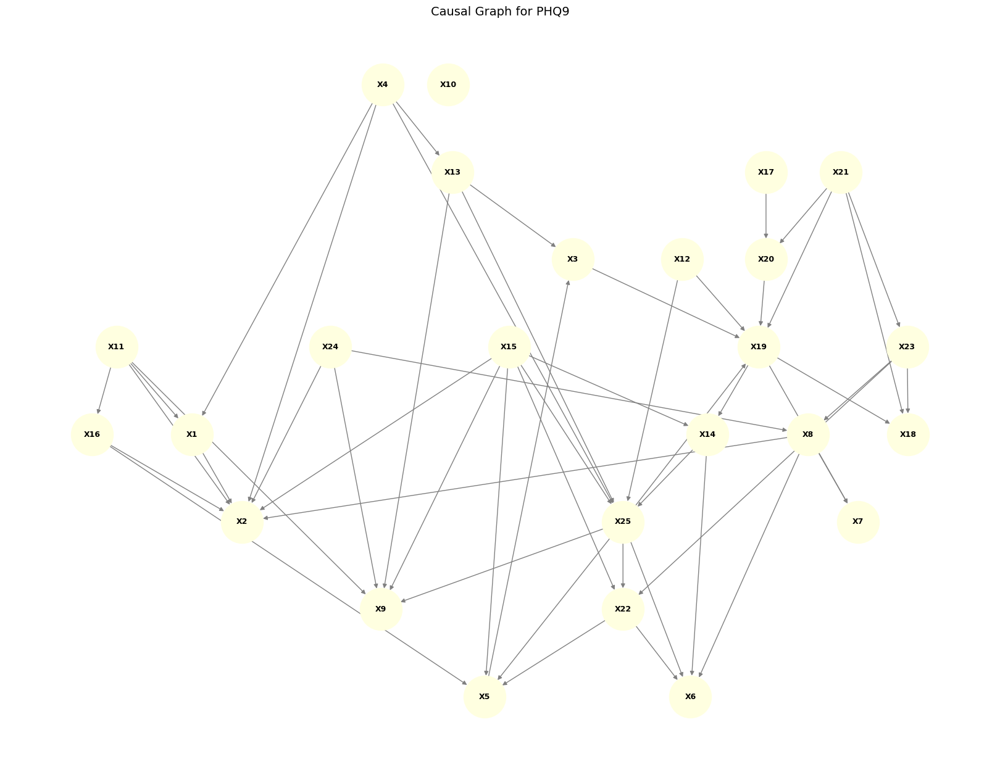


Direct causes of PHQ9_Depressed:

PHQ9 Graph: Total Nodes = 25, Total Edges = 51
Top 5 Influential Features (PHQ9):
 - X15: 6 edges
 - X25: 5 edges
 - X4: 4 edges
 - X11: 4 edges
 - X21: 4 edges


  0%|          | 0/24 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\694772311.py:105: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


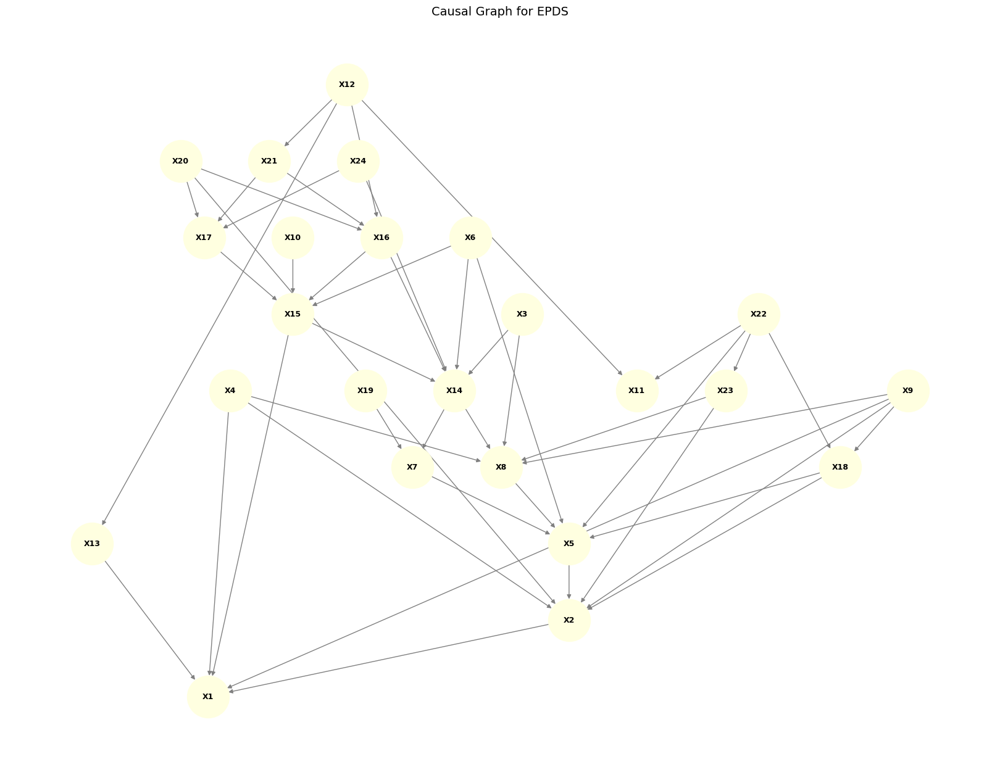


Direct causes of EPDS_Depressed:

EPDS Graph: Total Nodes = 24, Total Edges = 45
Top 5 Influential Features (EPDS):
 - X9: 4 edges
 - X12: 4 edges
 - X22: 4 edges
 - X4: 3 edges
 - X6: 3 edges


In [20]:
# === 1. Imports ===
import pandas as pd
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.cit import fisherz
import matplotlib.pyplot as plt
import networkx as nx

# === 2. Load Your Dataset ===
df = pd.read_csv('PPD_dataset_cleaned.csv')

# === 3. Create Binary Targets ===
df['PHQ9_Depressed'] = df[['PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Severe']].max(axis=1)
df['EPDS_Depressed'] = df['EPDS Result_medium']

# === 4. Define Feature Sets ===
phq9_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Major changes or losses during pregnancy',
    'Trust and share feelings', 'Pregnancy plan', 'Regular checkups',
    'Fear of pregnancy', 'Breastfeed', 'Newborn illness',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Relax/sleep when the newborn is asleep', 'Angry after latest child birth',
    'Occupation before latest pregnancy_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with husband_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Diseases during pregnancy_Chronic disease',
    'Feeling for regular activities_Tired',
    'PHQ9_Depressed'
]

epds_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Worry about newborn', 'Relax/sleep when the newborn is asleep',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Occupation After Your Latest Childbirth_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with the newborn_Neutral',
    'Relationship with husband_Poor',
    'Relationship with the in-laws_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Newborn illness', 'Breastfeed',
    'Feeling for regular activities_Worried',
    'Diseases during pregnancy_Chronic disease',
    'Birth compliancy',
    'Mode of delivery',
    'EPDS_Depressed'
]

def plot_causal_graph(cg, labels, title="Causal Graph"):
    import matplotlib.pyplot as plt
    import networkx as nx

    try:
        from networkx.drawing.nx_agraph import graphviz_layout
        layout_fn = lambda G: graphviz_layout(G, prog='dot')
    except ImportError:
        print("Graphviz layout not found. Falling back to spring layout.")
        layout_fn = lambda G: nx.spring_layout(G, seed=42)

    G = nx.DiGraph()

    # Mapping node numbers to feature labels
    name_to_label = {str(i): label for i, label in enumerate(labels)}

    # Build directed graph from causal discovery result
    for node in cg.G.get_nodes():
        G.add_node(node.get_name())

    for edge in cg.G.get_graph_edges():
        i = edge.get_node1().get_name()
        j = edge.get_node2().get_name()
        ep1 = edge.get_endpoint1()
        ep2 = edge.get_endpoint2()

        if ep1 == 'TAIL' and ep2 == 'ARROW':
            G.add_edge(i, j)
        elif ep1 == 'ARROW' and ep2 == 'TAIL':
            G.add_edge(j, i)
        else:
            G.add_edge(i, j)

    # Relabel node numbers to original feature names
    G = nx.relabel_nodes(G, name_to_label)

    # Plot graph
    plt.figure(figsize=(16, 12))
    pos = layout_fn(G)
    nx.draw(G, pos,
            with_labels=True,
            node_color='lightyellow',
            edge_color='gray',
            node_size=2400,
            font_size=9,
            font_weight='bold',
            arrows=True)

    plt.title(title, fontsize=14)
    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}.png", dpi=600)
    plt.show()

    return G


# === 6. Run Causal Discovery for PHQ9 ===
df_phq9 = df[phq9_columns].dropna()
data_phq9 = df_phq9.to_numpy()
cg_phq9 = pc(data_phq9, alpha=0.05, ci_test=fisherz)
G_phq9 = plot_causal_graph(cg_phq9, df_phq9.columns.tolist(), title="Causal Graph for PHQ9")

# === 7. Analyze PHQ9 Graph ===
phq9_target = 'PHQ9_Depressed'
parents_phq9 = [src for src, dst in G_phq9.edges if dst == phq9_target]

print(f"\nDirect causes of {phq9_target}:")
for p in parents_phq9:
    print(f" - {p}")

print(f"\nPHQ9 Graph: Total Nodes = {len(G_phq9.nodes)}, Total Edges = {len(G_phq9.edges)}")
out_degrees = sorted(G_phq9.out_degree, key=lambda x: x[1], reverse=True)[:5]
print("Top 5 Influential Features (PHQ9):")
for node, deg in out_degrees:
    print(f" - {node}: {deg} edges")

# === 8. Run Causal Discovery for EPDS ===
df_epds = df[epds_columns].dropna()
data_epds = df_epds.to_numpy()
cg_epds = pc(data_epds, alpha=0.05, ci_test=fisherz)
G_epds = plot_causal_graph(cg_epds, df_epds.columns.tolist(), title="Causal Graph for EPDS")

# === 9. Analyze EPDS Graph ===
epds_target = 'EPDS_Depressed'
parents_epds = [src for src, dst in G_epds.edges if dst == epds_target]

print(f"\nDirect causes of {epds_target}:")
for p in parents_epds:
    print(f" - {p}")

print(f"\nEPDS Graph: Total Nodes = {len(G_epds.nodes)}, Total Edges = {len(G_epds.edges)}")
out_degrees = sorted(G_epds.out_degree, key=lambda x: x[1], reverse=True)[:5]
print("Top 5 Influential Features (EPDS):")
for node, deg in out_degrees:
    print(f" - {node}: {deg} edges")


  0%|          | 0/25 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\2215178472.py:105: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


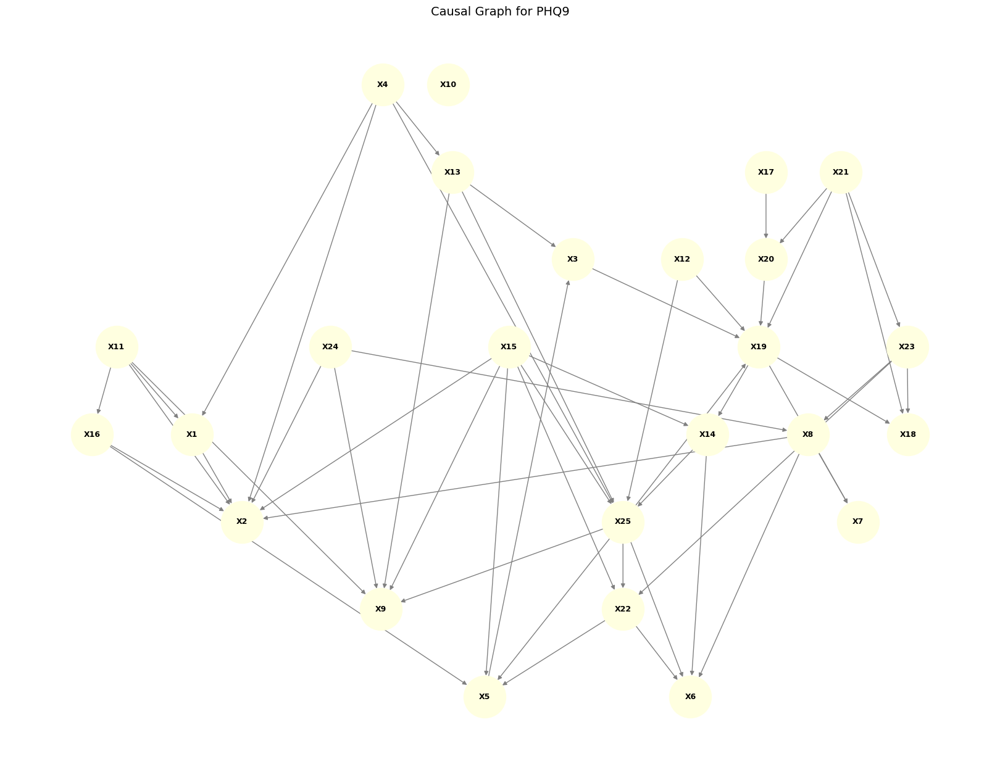


Direct causes of PHQ9_Depressed:

PHQ9 Graph: Total Nodes = 25, Total Edges = 51
Top 5 Influential Features (PHQ9):
 - X15: 6 edges
 - X25: 5 edges
 - X4: 4 edges
 - X11: 4 edges
 - X21: 4 edges


  0%|          | 0/24 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\2215178472.py:105: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


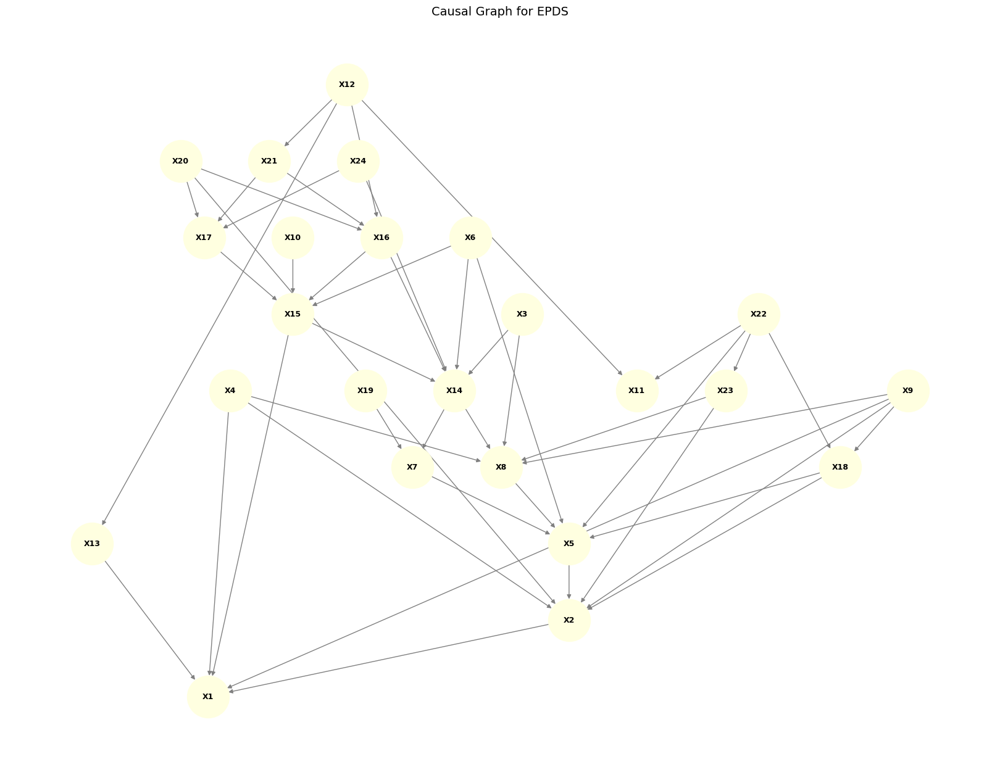


Direct causes of EPDS_Depressed:

EPDS Graph: Total Nodes = 24, Total Edges = 45
Top 5 Influential Features (EPDS):
 - X9: 4 edges
 - X12: 4 edges
 - X22: 4 edges
 - X4: 3 edges
 - X6: 3 edges


In [21]:
# === 1. Imports ===
import pandas as pd
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.cit import fisherz
import matplotlib.pyplot as plt
import networkx as nx

# === 2. Load Your Dataset ===
df = pd.read_csv('PPD_dataset_cleaned.csv')

# === 3. Create Binary Targets ===
df['PHQ9_Depressed'] = df[['PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Severe']].max(axis=1)
df['EPDS_Depressed'] = df['EPDS Result_medium']

# === 4. Define Feature Sets ===
phq9_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Major changes or losses during pregnancy',
    'Trust and share feelings', 'Pregnancy plan', 'Regular checkups',
    'Fear of pregnancy', 'Breastfeed', 'Newborn illness',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Relax/sleep when the newborn is asleep', 'Angry after latest child birth',
    'Occupation before latest pregnancy_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with husband_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Diseases during pregnancy_Chronic disease',
    'Feeling for regular activities_Tired',
    'PHQ9_Depressed'
]

epds_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Worry about newborn', 'Relax/sleep when the newborn is asleep',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Occupation After Your Latest Childbirth_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with the newborn_Neutral',
    'Relationship with husband_Poor',
    'Relationship with the in-laws_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Newborn illness', 'Breastfeed',
    'Feeling for regular activities_Worried',
    'Diseases during pregnancy_Chronic disease',
    'Birth compliancy',
    'Mode of delivery',
    'EPDS_Depressed'
]

def plot_causal_graph(cg, labels, title="Causal Graph"):
    import matplotlib.pyplot as plt
    import networkx as nx

    try:
        from networkx.drawing.nx_agraph import graphviz_layout
        layout_fn = lambda G: graphviz_layout(G, prog='dot')
    except ImportError:
        print("Graphviz layout not found. Falling back to spring layout.")
        layout_fn = lambda G: nx.spring_layout(G, seed=42)

    G = nx.DiGraph()

    # Mapping node numbers to feature labels
    name_to_label = {str(i): label for i, label in enumerate(labels)}

    # Build directed graph from causal discovery result
    for node in cg.G.get_nodes():
        G.add_node(node.get_name())

    for edge in cg.G.get_graph_edges():
        i = edge.get_node1().get_name()
        j = edge.get_node2().get_name()
        ep1 = edge.get_endpoint1()
        ep2 = edge.get_endpoint2()

        if ep1 == 'TAIL' and ep2 == 'ARROW':
            G.add_edge(i, j)
        elif ep1 == 'ARROW' and ep2 == 'TAIL':
            G.add_edge(j, i)
        else:
            G.add_edge(i, j)

    # Relabel node numbers to original feature names
    G = nx.relabel_nodes(G, name_to_label)

    # Plot graph
    plt.figure(figsize=(16, 12))
    pos = layout_fn(G)
    nx.draw(G, pos,
            with_labels=True,
            node_color='lightyellow',
            edge_color='gray',
            node_size=2400,
            font_size=9,
            font_weight='bold',
            arrows=True)

    plt.title(title, fontsize=14)
    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}.png", dpi=600)
    plt.show()

    return G

import plotly.graph_objects as go

def plot_sankey_diagram(G, title="Causal Sankey Diagram"):
    edge_list = list(G.edges())
    if not edge_list:
        print(f"No edges found in {title}")
        return

    # Extract unique node labels
    labels = sorted(set([u for u, _ in edge_list] + [v for _, v in edge_list]))
    label_idx = {label: i for i, label in enumerate(labels)}

    # Build Sankey source and target indices
    source = [label_idx[u] for u, v in edge_list]
    target = [label_idx[v] for u, v in edge_list]
    values = [1 for _ in edge_list]

    # Plot Sankey
    fig = go.Figure(data=[go.Sankey(
        node=dict(pad=15, thickness=20, line=dict(color="black", width=0.5),
                  label=labels, color="lightblue"),
        link=dict(source=source, target=target, value=values, color="gray")
    )])
    fig.update_layout(title_text=title, font_size=10)
    fig.show()


# === 6. Run Causal Discovery for PHQ9 ===
df_phq9 = df[phq9_columns].dropna()
data_phq9 = df_phq9.to_numpy()
cg_phq9 = pc(data_phq9, alpha=0.05, ci_test=fisherz)
G_phq9 = plot_causal_graph(cg_phq9, df_phq9.columns.tolist(), title="Causal Graph for PHQ9")

# === 7. Analyze PHQ9 Graph ===
phq9_target = 'PHQ9_Depressed'
parents_phq9 = [src for src, dst in G_phq9.edges if dst == phq9_target]

print(f"\nDirect causes of {phq9_target}:")
for p in parents_phq9:
    print(f" - {p}")

print(f"\nPHQ9 Graph: Total Nodes = {len(G_phq9.nodes)}, Total Edges = {len(G_phq9.edges)}")
out_degrees = sorted(G_phq9.out_degree, key=lambda x: x[1], reverse=True)[:5]
print("Top 5 Influential Features (PHQ9):")
for node, deg in out_degrees:
    print(f" - {node}: {deg} edges")

# === 8. Run Causal Discovery for EPDS ===
df_epds = df[epds_columns].dropna()
data_epds = df_epds.to_numpy()
cg_epds = pc(data_epds, alpha=0.05, ci_test=fisherz)
G_epds = plot_causal_graph(cg_epds, df_epds.columns.tolist(), title="Causal Graph for EPDS")

# === 9. Analyze EPDS Graph ===
epds_target = 'EPDS_Depressed'
parents_epds = [src for src, dst in G_epds.edges if dst == epds_target]

print(f"\nDirect causes of {epds_target}:")
for p in parents_epds:
    print(f" - {p}")

print(f"\nEPDS Graph: Total Nodes = {len(G_epds.nodes)}, Total Edges = {len(G_epds.edges)}")
out_degrees = sorted(G_epds.out_degree, key=lambda x: x[1], reverse=True)[:5]
print("Top 5 Influential Features (EPDS):")
for node, deg in out_degrees:
    print(f" - {node}: {deg} edges")

# === 10. Sankey Diagrams ===
plot_sankey_diagram(G_phq9, "Causal Sankey Diagram (PHQ9)")
plot_sankey_diagram(G_epds, "Causal Sankey Diagram (EPDS)")



  0%|          | 0/25 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\400862737.py:59: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



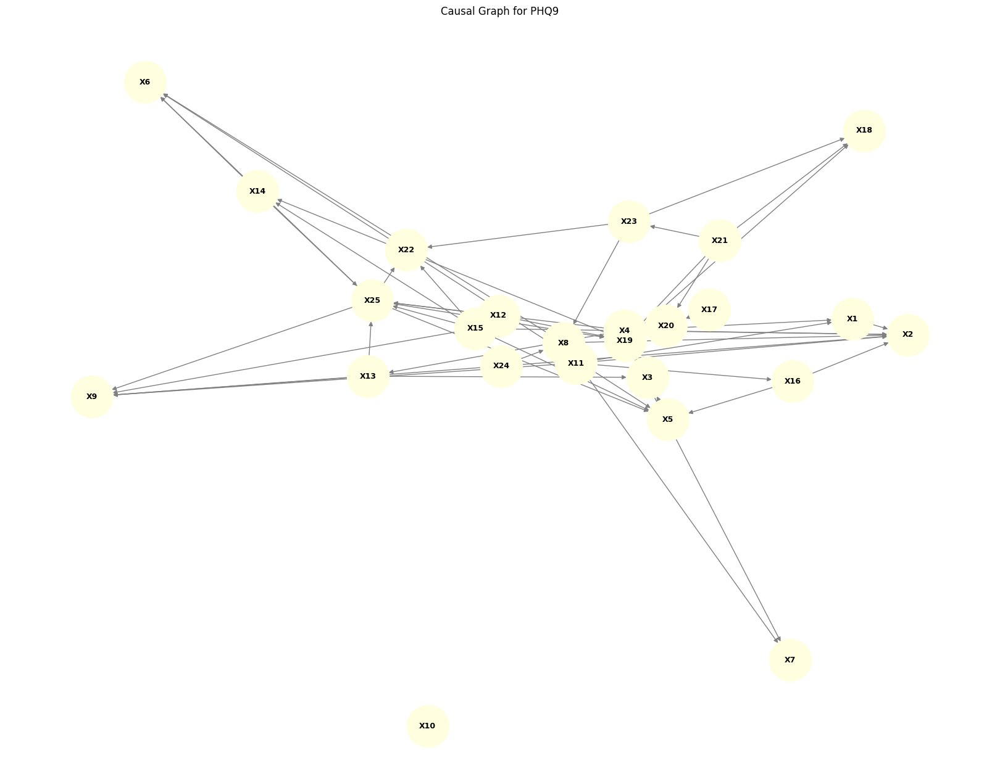


Direct causes of PHQ9_Depressed:

Dot-Arrow Table:
From → To
X1 → X2
X3 → X19
X4 → X1
X4 → X2
X4 → X13
X4 → X25
X5 → X3
X8 → X2
X8 → X6
X8 → X7
X11 → X1
X11 → X2
X11 → X9
X11 → X16
X12 → X19
X12 → X25
X13 → X3
X13 → X9
X13 → X25
X14 → X6
X14 → X25
X15 → X2
X15 → X5
X15 → X9
X15 → X14
X15 → X22
X15 → X25
X16 → X2
X16 → X5
X17 → X20
X19 → X7
X19 → X14
X19 → X18
X20 → X19
X21 → X18
X21 → X19
X21 → X20
X21 → X23
X22 → X5
X22 → X6
X23 → X8
X23 → X18
X23 → X22
X24 → X2
X24 → X8
X24 → X9
X25 → X5
X25 → X6
X25 → X9
X25 → X19
X25 → X22

Adjacency Matrix:
     X1  X2  X3  X4  X5  X6  X7  X8  X9  X10  ...  X16  X17  X18  X19  X20  \
X1    0   1   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X2    0   0   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X3    0   0   0   0   0   0   0   0   0    0  ...    0    0    0    1    0   
X4    1   1   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X5    0   0   1   0   0   0   0   0   0    0  ...    0   

  0%|          | 0/24 [00:00<?, ?it/s]

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\400862737.py:59: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



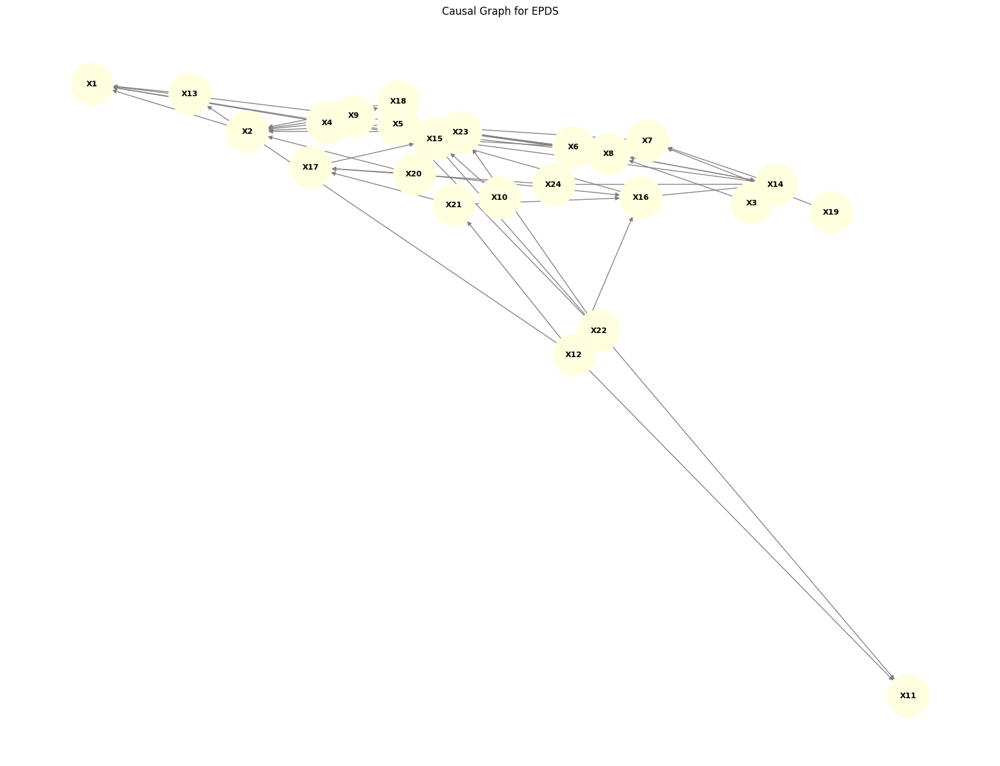


Direct causes of EPDS_Depressed:

Dot-Arrow Table:
From → To
X2 → X1
X3 → X8
X3 → X14
X4 → X1
X4 → X2
X4 → X8
X5 → X2
X6 → X5
X6 → X14
X6 → X15
X7 → X5
X8 → X5
X9 → X1
X9 → X2
X9 → X8
X9 → X18
X10 → X15
X12 → X11
X12 → X13
X12 → X16
X12 → X21
X13 → X1
X14 → X7
X14 → X8
X15 → X1
X15 → X14
X16 → X14
X16 → X15
X17 → X15
X18 → X2
X18 → X5
X19 → X7
X20 → X2
X20 → X16
X20 → X17
X21 → X16
X21 → X17
X22 → X5
X22 → X11
X22 → X18
X22 → X23
X23 → X2
X23 → X8
X24 → X14
X24 → X17

Adjacency Matrix:
     X1  X2  X3  X4  X5  X6  X7  X8  X9  X10  ...  X15  X16  X17  X18  X19  \
X1    0   0   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X2    1   0   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X3    0   0   0   0   0   0   0   1   0    0  ...    0    0    0    0    0   
X4    1   1   0   0   0   0   0   1   0    0  ...    0    0    0    0    0   
X5    0   1   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X6    0   0   0   0   1   0   0   0   0 

C:\Users\user1\AppData\Local\Temp\ipykernel_25304\400862737.py:59: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



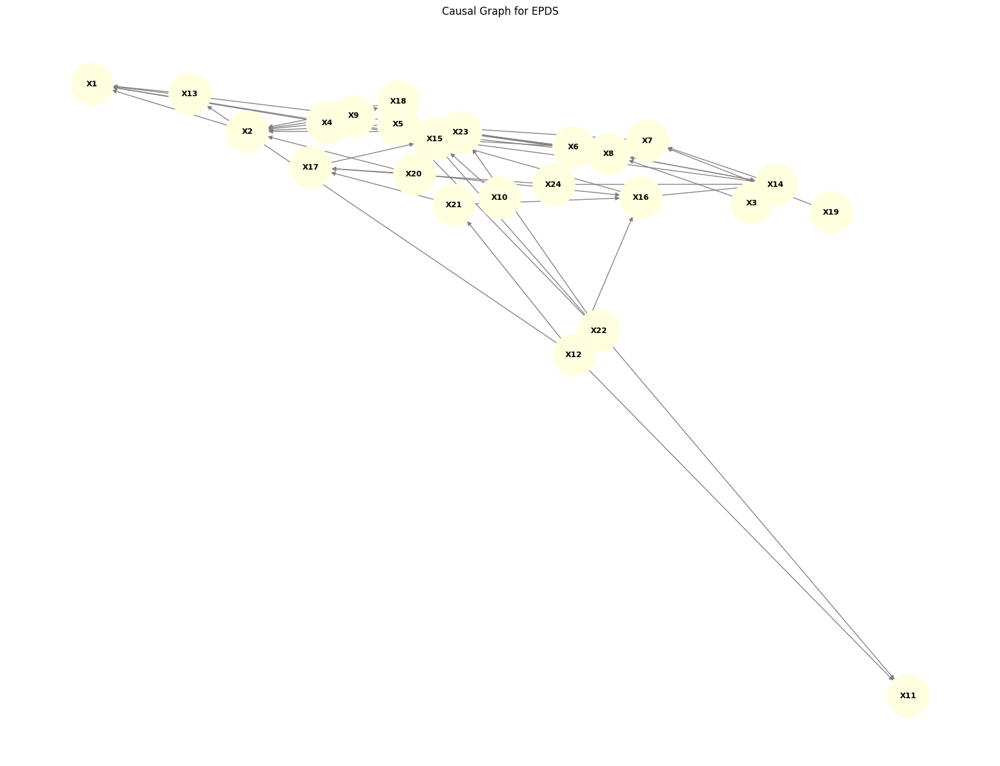


Direct causes of EPDS_Depressed:

Dot-Arrow Table:
From → To
X2 → X1
X3 → X8
X3 → X14
X4 → X1
X4 → X2
X4 → X8
X5 → X2
X6 → X5
X6 → X14
X6 → X15
X7 → X5
X8 → X5
X9 → X1
X9 → X2
X9 → X8
X9 → X18
X10 → X15
X12 → X11
X12 → X13
X12 → X16
X12 → X21
X13 → X1
X14 → X7
X14 → X8
X15 → X1
X15 → X14
X16 → X14
X16 → X15
X17 → X15
X18 → X2
X18 → X5
X19 → X7
X20 → X2
X20 → X16
X20 → X17
X21 → X16
X21 → X17
X22 → X5
X22 → X11
X22 → X18
X22 → X23
X23 → X2
X23 → X8
X24 → X14
X24 → X17

Adjacency Matrix:
     X1  X2  X3  X4  X5  X6  X7  X8  X9  X10  ...  X15  X16  X17  X18  X19  \
X1    0   0   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X2    1   0   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X3    0   0   0   0   0   0   0   1   0    0  ...    0    0    0    0    0   
X4    1   1   0   0   0   0   0   1   0    0  ...    0    0    0    0    0   
X5    0   1   0   0   0   0   0   0   0    0  ...    0    0    0    0    0   
X6    0   0   0   0   1   0   0   0   0 

In [22]:
# === 1. Imports ===
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.cit import fisherz

# === 2. Load Your Dataset ===
df = pd.read_csv('PPD_dataset_cleaned.csv')

# === 3. Create Binary Targets ===
df['PHQ9_Depressed'] = df[['PHQ9 Result_Moderate', 'PHQ9 Result_Moderately Severe', 'PHQ9 Result_Severe']].max(axis=1)
df['EPDS_Depressed'] = df['EPDS Result_medium']

# === 4. Define Feature Sets ===
phq9_columns = [
    'Age', 'Residence', 'Marital status', 'Family type',
    'Major changes or losses during pregnancy',
    'Trust and share feelings', 'Pregnancy plan', 'Regular checkups',
    'Fear of pregnancy', 'Breastfeed', 'Newborn illness',
    'Depression before pregnancy', 'Depression during pregnancy',
    'Relax/sleep when the newborn is asleep', 'Angry after latest child birth',
    'Occupation before latest pregnancy_Housewife',
    'Current monthly income_Less than 5000',
    'Relationship with husband_Poor',
    'Feeling about motherhood_Sad',
    'Recieved Support_Low',
    'Need for Support_Medium',
    'Abuse_Yes',
    'Diseases during pregnancy_Chronic disease',
    'Feeling for regular activities_Tired',
    'PHQ9_Depressed'
]

# === 5. Plot Graph Utility ===
def plot_causal_graph(cg, labels, title="Causal Graph"):
    G = nx.DiGraph()
    name_to_label = {str(i): label for i, label in enumerate(labels)}

    for node in cg.G.get_nodes():
        G.add_node(node.get_name())
    for edge in cg.G.get_graph_edges():
        i, j = edge.get_node1().get_name(), edge.get_node2().get_name()
        ep1, ep2 = edge.get_endpoint1(), edge.get_endpoint2()
        if ep1 == 'TAIL' and ep2 == 'ARROW':
            G.add_edge(i, j)
        elif ep1 == 'ARROW' and ep2 == 'TAIL':
            G.add_edge(j, i)
        else:
            G.add_edge(i, j)

    G = nx.relabel_nodes(G, name_to_label)
    pos = nx.spring_layout(G, seed=42)
    plt.figure(figsize=(16, 12))
    nx.draw(G, pos, with_labels=True, node_color='lightyellow', edge_color='gray',
            node_size=2400, font_size=9, font_weight='bold', arrows=True)
    plt.title(title)
    plt.tight_layout()
    plt.savefig(f"{title.replace(' ', '_')}.png", dpi=600)
    plt.show()
    return G

# === 6. Sankey Diagram ===
def plot_sankey_diagram(G, title="Causal Sankey Diagram"):
    edges = list(G.edges())
    if not edges:
        print(f"No edges found in {title}")
        return
    labels = sorted(set([src for src, _ in edges] + [dst for _, dst in edges]))
    label_to_idx = {label: idx for idx, label in enumerate(labels)}
    source = [label_to_idx[src] for src, dst in edges]
    target = [label_to_idx[dst] for src, dst in edges]
    value = [1 for _ in edges]

    fig = go.Figure(data=[go.Sankey(
        node=dict(pad=15, thickness=20, label=labels, color="lightblue"),
        link=dict(source=source, target=target, value=value, color="gray")
    )])
    fig.update_layout(title_text=title, font_size=10)
    fig.show()

# === 7. Adjacency Matrix + Dot Arrow Table ===
def analyze_graph(G, target_name):
    print(f"\nDirect causes of {target_name}:")
    for src, dst in G.edges():
        if dst == target_name:
            print(f" • {src} → {dst}")
    print(f"\nDot-Arrow Table:")
    print("From → To")
    for src, dst in G.edges():
        print(f"{src} → {dst}")
    print("\nAdjacency Matrix:")
    adj = nx.to_pandas_adjacency(G, dtype=int)
    print(adj)
    return adj

# === 8. Run for PHQ9 ===
df_phq9 = df[phq9_columns].dropna()
cg_phq9 = pc(df_phq9.to_numpy(), alpha=0.05, ci_test=fisherz)
G_phq9 = plot_causal_graph(cg_phq9, df_phq9.columns.tolist(), "Causal Graph for PHQ9")
adj_phq9 = analyze_graph(G_phq9, "PHQ9_Depressed")
plot_sankey_diagram(G_phq9, "Causal Sankey Diagram - PHQ9")

# === 9. Run for EPDS ===
epds_columns.append("EPDS_Depressed")
# === Clean EPDS Data for FisherZ ===
df_epds_cleaned = df[epds_columns].dropna().copy()

# Remove constant columns
df_epds_cleaned = df_epds_cleaned.loc[:, df_epds_cleaned.nunique() > 1]

# Remove duplicate columns
df_epds_cleaned = df_epds_cleaned.T.drop_duplicates().T

# Check again for singular matrix possibility
if df_epds_cleaned.shape[1] < 2:
    raise ValueError("Too few valid features after cleaning. Check dataset.")
    
# Now safe to run PC
cg_epds = pc(df_epds_cleaned.to_numpy(), alpha=0.05, ci_test=fisherz)
G_epds = plot_causal_graph(cg_epds, df_epds_cleaned.columns.tolist(), "Causal Graph for EPDS")
adj_epds = analyze_graph(G_epds, "EPDS_Depressed")
plot_sankey_diagram(G_epds, "Causal Sankey Diagram - EPDS")

G_epds = plot_causal_graph(cg_epds, df_epds.columns.tolist(), "Causal Graph for EPDS")
adj_epds = analyze_graph(G_epds, "EPDS_Depressed")
plot_sankey_diagram(G_epds, "Causal Sankey Diagram - EPDS")


C:\Users\user1\AppData\Local\Temp\ipykernel_25304\904785447.py:27: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.



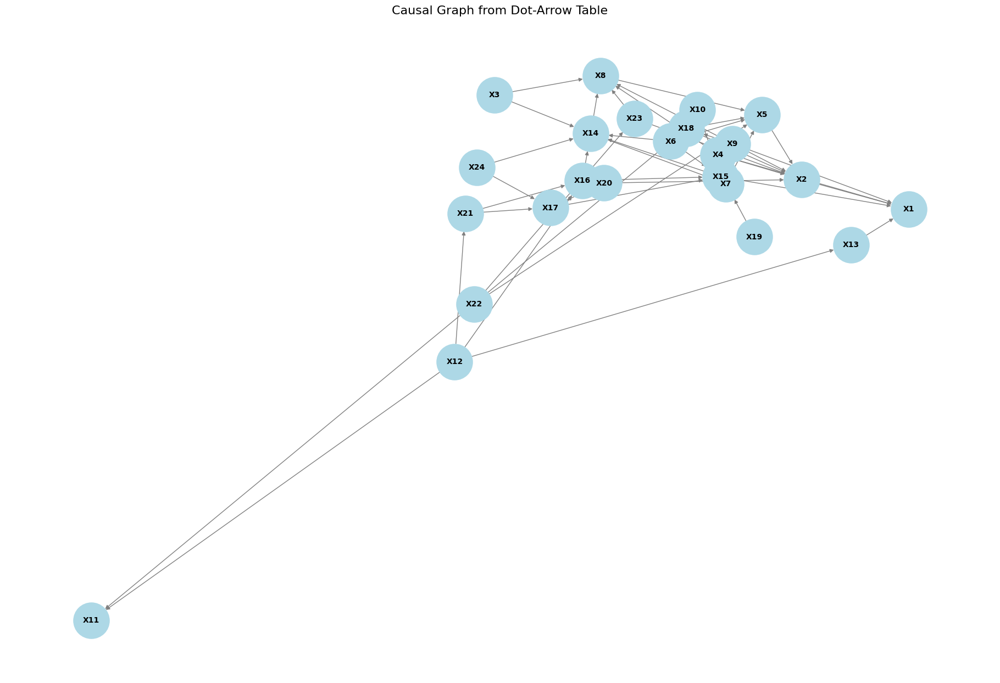

In [23]:
import matplotlib.pyplot as plt
import networkx as nx

# === 1. Dot-Arrow Relationships ===
dot_arrow_edges = [
    ("X2", "X1"), ("X3", "X8"), ("X3", "X14"), ("X4", "X1"), ("X4", "X2"), ("X4", "X8"),
    ("X5", "X2"), ("X6", "X5"), ("X6", "X14"), ("X6", "X15"), ("X7", "X5"), ("X8", "X5"),
    ("X9", "X1"), ("X9", "X2"), ("X9", "X8"), ("X9", "X18"), ("X10", "X15"), ("X12", "X11"),
    ("X12", "X13"), ("X12", "X16"), ("X12", "X21"), ("X13", "X1"), ("X14", "X7"), ("X14", "X8"),
    ("X15", "X1"), ("X15", "X14"), ("X16", "X14"), ("X16", "X15"), ("X17", "X15"),
    ("X18", "X2"), ("X18", "X5"), ("X19", "X7"), ("X20", "X2"), ("X20", "X16"), ("X20", "X17"),
    ("X21", "X16"), ("X21", "X17"), ("X22", "X5"), ("X22", "X11"), ("X22", "X18"),
    ("X22", "X23"), ("X23", "X2"), ("X23", "X8"), ("X24", "X14"), ("X24", "X17")
]

# === 2. Build and Visualize the Directed Graph ===
G = nx.DiGraph()
G.add_edges_from(dot_arrow_edges)

plt.figure(figsize=(18, 12))
pos = nx.spring_layout(G, seed=42)  # you can also try `kamada_kawai_layout`
nx.draw(G, pos, with_labels=True, arrows=True,
        node_color='lightblue', node_size=2200,
        edge_color='gray', font_size=10, font_weight='bold')

plt.title("Causal Graph from Dot-Arrow Table", fontsize=16)
plt.tight_layout()
plt.show()


In [24]:
import plotly.graph_objects as go

# === 1. Dot-Arrow Edges (Causal Relations) ===
edges = [
    ("X2", "X1"), ("X3", "X8"), ("X3", "X14"), ("X4", "X1"), ("X4", "X2"), ("X4", "X8"),
    ("X5", "X2"), ("X6", "X5"), ("X6", "X14"), ("X6", "X15"), ("X7", "X5"), ("X8", "X5"),
    ("X9", "X1"), ("X9", "X2"), ("X9", "X8"), ("X9", "X18"), ("X10", "X15"), ("X12", "X11"),
    ("X12", "X13"), ("X12", "X16"), ("X12", "X21"), ("X13", "X1"), ("X14", "X7"), ("X14", "X8"),
    ("X15", "X1"), ("X15", "X14"), ("X16", "X14"), ("X16", "X15"), ("X17", "X15"),
    ("X18", "X2"), ("X18", "X5"), ("X19", "X7"), ("X20", "X2"), ("X20", "X16"), ("X20", "X17"),
    ("X21", "X16"), ("X21", "X17"), ("X22", "X5"), ("X22", "X11"), ("X22", "X18"),
    ("X22", "X23"), ("X23", "X2"), ("X23", "X8"), ("X24", "X14"), ("X24", "X17")
]

# === 2. Create Node List and Index Mapping ===
nodes = sorted(set([src for src, tgt in edges] + [tgt for src, tgt in edges]))
node_indices = {node: i for i, node in enumerate(nodes)}

# === 3. Build Sankey Inputs ===
source_indices = [node_indices[src] for src, tgt in edges]
target_indices = [node_indices[tgt] for src, tgt in edges]
values = [1] * len(edges)  # Each edge has equal "strength"

# === 4. Sankey Diagram ===
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=15,
        thickness=20,
        line=dict(color="black", width=0.5),
        label=nodes,
        color="lightblue"
    ),
    link=dict(
        source=source_indices,
        target=target_indices,
        value=values,
        color="gray"
    ))])

fig.update_layout(title_text="Causal Sankey Diagram (Dot-Arrow Table)", font_size=12)
fig.show()


In [25]:
# === 11. SHAP Analysis for PHQ9 and EPDS ===
import shap
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Optional: make SHAP plots work in Jupyter
shap.initjs()

def run_shap_analysis(X, y, feature_names, target_label):
    # Split data
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Fit XGBoost classifier (SHAP-friendly)
    model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
    model.fit(X_train, y_train)

    # Classification report
    y_pred = model.predict(X_test)
    print(f"\nClassification Report for {target_label}:\n")
    print(classification_report(y_test, y_pred))

    # SHAP explainer
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_test)

    # Summary plot
    print(f"\nSHAP Summary Plot for {target_label}:")
    shap.summary_plot(shap_values, features=X_test, feature_names=feature_names)

# === SHAP for PHQ9_Depressed ===
print("\n" + "="*40 + "\nRunning SHAP Analysis for PHQ9_Depressed")
X_phq9 = df_phq9.drop(columns=['PHQ9_Depressed'])
y_phq9 = df_phq9['PHQ9_Depressed']
run_shap_analysis(X_phq9, y_phq9, X_phq9.columns.tolist(), target_label="PHQ9_Depressed")

# === SHAP for EPDS_Depressed ===
print("\n" + "="*40 + "\nRunning SHAP Analysis for EPDS_Depressed")
X_epds = df_epds.drop(columns=['EPDS_Depressed'])
y_epds = df_epds['EPDS_Depressed']
run_shap_analysis(X_epds, y_epds, X_epds.columns.tolist(), target_label="EPDS_Depressed")



Running SHAP Analysis for PHQ9_Depressed

Classification Report for PHQ9_Depressed:

              precision    recall  f1-score   support

           0       0.70      0.64      0.67        67
           1       0.76      0.81      0.78        93

    accuracy                           0.74       160
   macro avg       0.73      0.72      0.73       160
weighted avg       0.74      0.74      0.74       160



[22:12:10] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.



UnicodeDecodeError: 'utf-8' codec can't decode byte 0x8c in position 1743: invalid start byte

In [27]:
import shap
import matplotlib.pyplot as plt

# Select a model and target variable to explain
selected_model_key = max(cv_results, key=lambda k: cv_results[k]['Accuracy'])  # Best model by accuracy
selected_model = best_models[selected_model_key]
selected_target = selected_model_key[1]

print(f"\nExplaining model: {selected_model_key[0]} on target: {selected_target}")

# Use a subset of data for faster SHAP explanation
X_explain = X_train_engineered.copy()

# Initialize SHAP explainer based on model type
if selected_model_key[0] in ['RandomForest', 'DecisionTree']:
    explainer = shap.TreeExplainer(selected_model)
elif selected_model_key[0] == 'XGBoost':
    explainer = shap.TreeExplainer(selected_model)
elif selected_model_key[0] in ['LogisticRegression', 'SVM']:
    explainer = shap.LinearExplainer(selected_model, X_explain, feature_dependence="independent")
else:
    explainer = shap.Explainer(selected_model.predict, X_explain)

# Compute SHAP values
shap_values = explainer.shap_values(X_explain)


# === Summary plot (Bar chart) ===
shap.plots.bar(shap_values, max_display=15)
plt.title(f"Top Features Influencing {selected_target} ({selected_model_key[0]})")
plt.show()

# === Summary plot (Beeswarm) ===
shap.summary_plot(shap_values, X_explain, max_display=15)



Explaining model: XGBoost on target: PHQ9 Result_Moderate


UnicodeDecodeError: 'utf-8' codec can't decode byte 0xbd in position 6650: invalid start byte

In [28]:
import shap
import matplotlib.pyplot as plt

# Select best model
selected_model_key = max(cv_results, key=lambda k: cv_results[k]['Accuracy'])
selected_model = best_models[selected_model_key]
selected_target = selected_model_key[1]

print(f"\nExplaining model: {selected_model_key[0]} on target: {selected_target}")

X_explain = X_train_engineered.copy()

# Initialize explainer
if selected_model_key[0] == 'XGBoost':
    explainer = shap.TreeExplainer(selected_model)
    shap_values = explainer.shap_values(X_explain)

elif selected_model_key[0] in ['RandomForest', 'DecisionTree']:
    explainer = shap.TreeExplainer(selected_model)
    shap_values = explainer.shap_values(X_explain)

elif selected_model_key[0] in ['LogisticRegression', 'SVM']:
    explainer = shap.LinearExplainer(selected_model, X_explain, feature_dependence="independent")
    shap_values = explainer.shap_values(X_explain)

else:
    explainer = shap.Explainer(selected_model.predict, X_explain)
    shap_values = explainer(X_explain)

# === SHAP Summary Bar Plot ===
shap.summary_plot(shap_values, X_explain, max_display=15)



Explaining model: XGBoost on target: PHQ9 Result_Moderate


UnicodeDecodeError: 'utf-8' codec can't decode byte 0xbd in position 6650: invalid start byte


Explaining model: RandomForest on target: PHQ9 Result_Minimal


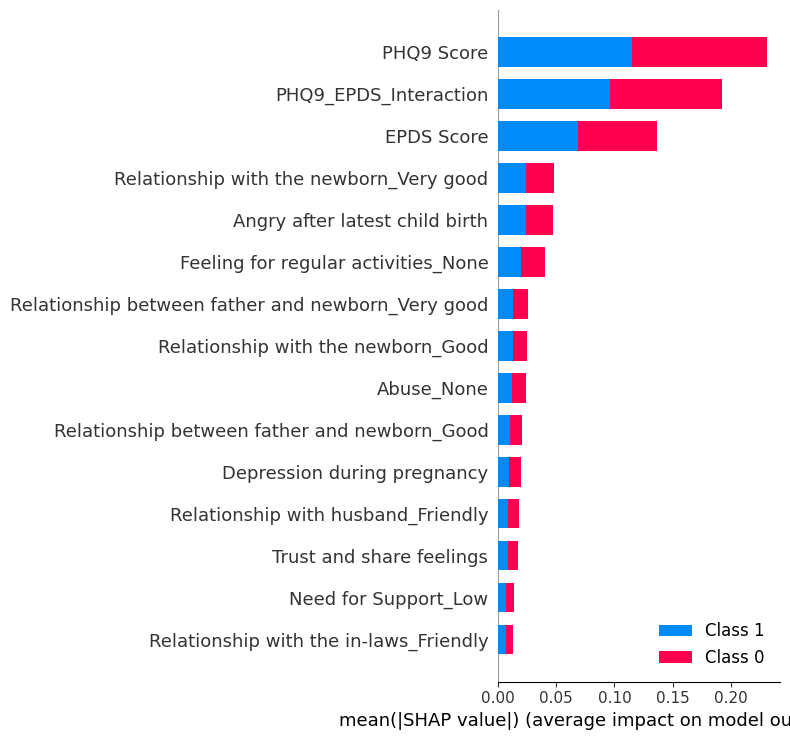


Explaining model: SVM on target: PHQ9 Result_Minimal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


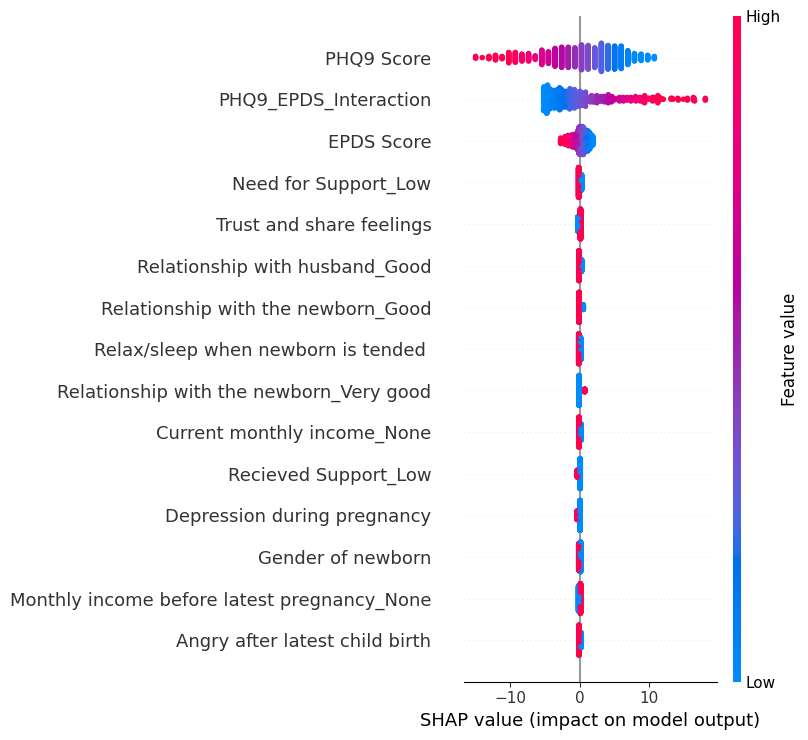


Explaining model: XGBoost on target: PHQ9 Result_Minimal
❌ Error explaining XGBoost on PHQ9 Result_Minimal: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Minimal


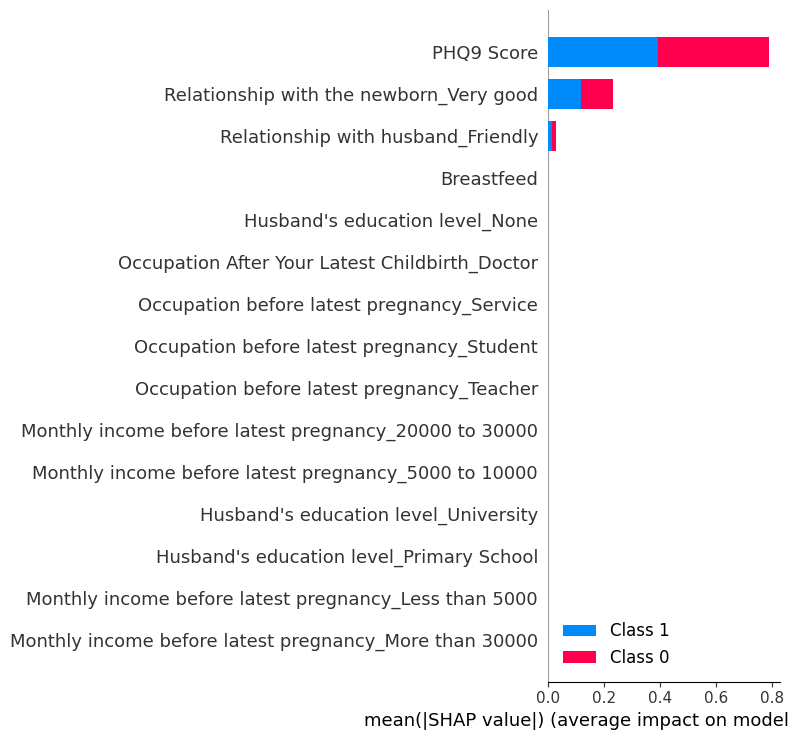


Explaining model: LogisticRegression on target: PHQ9 Result_Minimal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


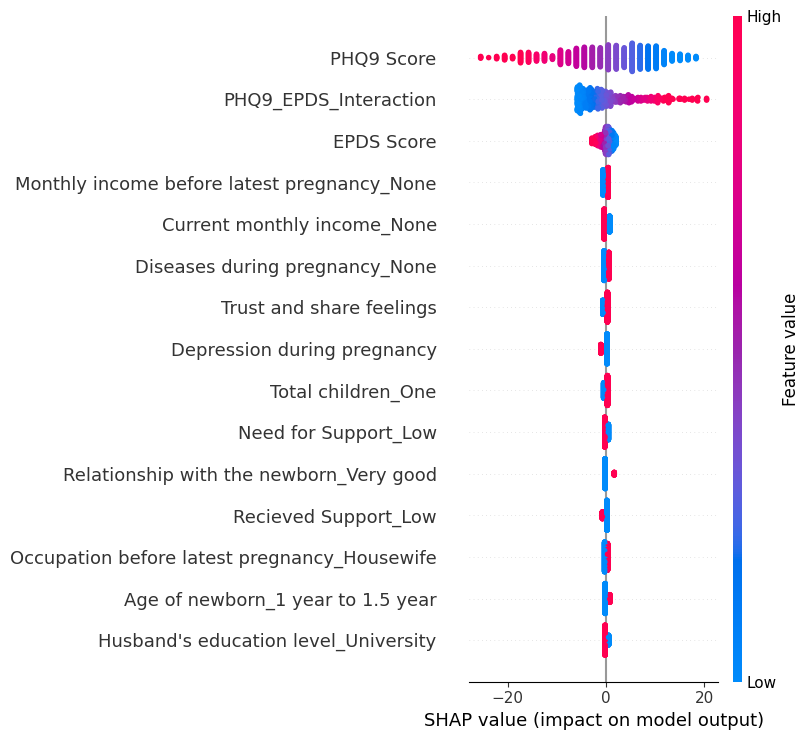


Explaining model: GradientBoosting on target: PHQ9 Result_Minimal


PermutationExplainer explainer: 640it [00:31, 15.91it/s]                                                               


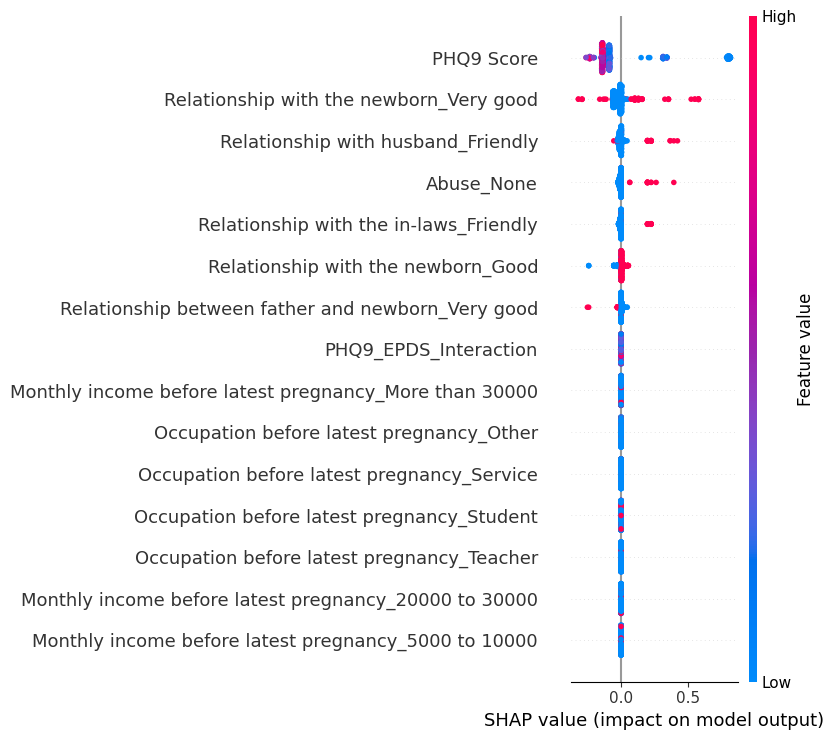


Explaining model: RandomForest on target: PHQ9 Result_Moderate


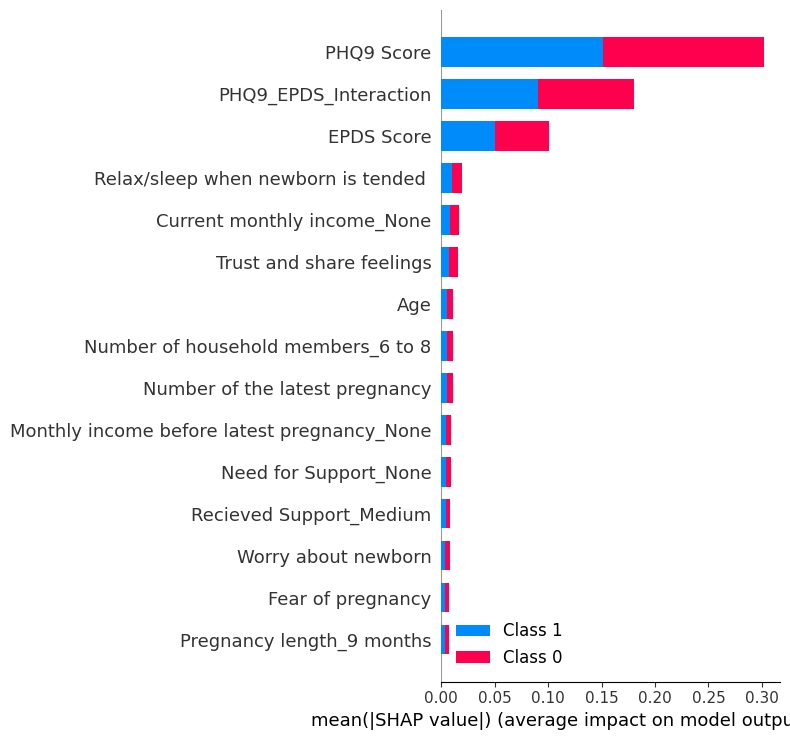


Explaining model: SVM on target: PHQ9 Result_Moderate
❌ Error explaining SVM on PHQ9 Result_Moderate: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Moderate
❌ Error explaining XGBoost on PHQ9 Result_Moderate: 'utf-8' codec can't decode byte 0xbd in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Moderate


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


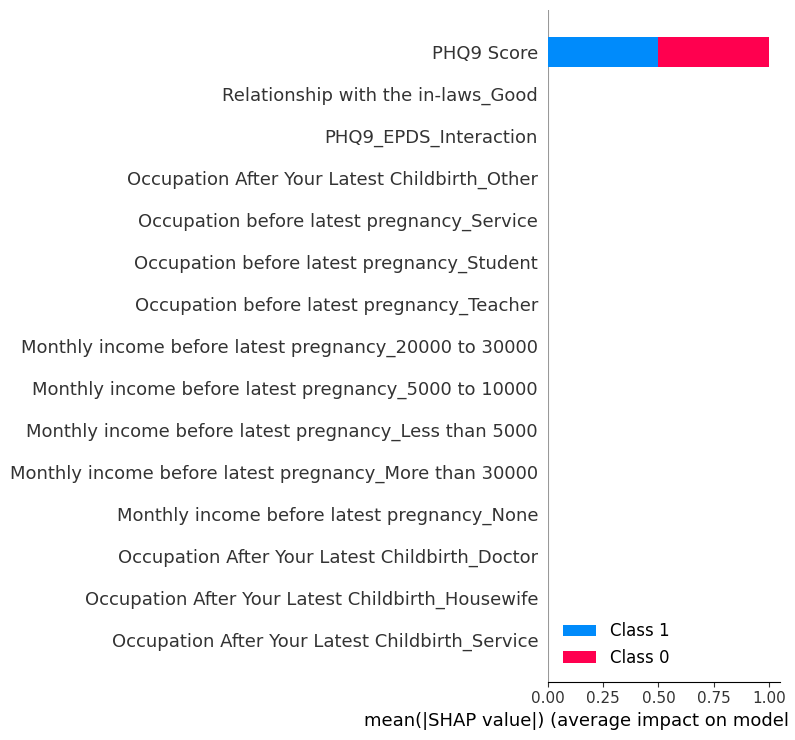


Explaining model: LogisticRegression on target: PHQ9 Result_Moderate


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


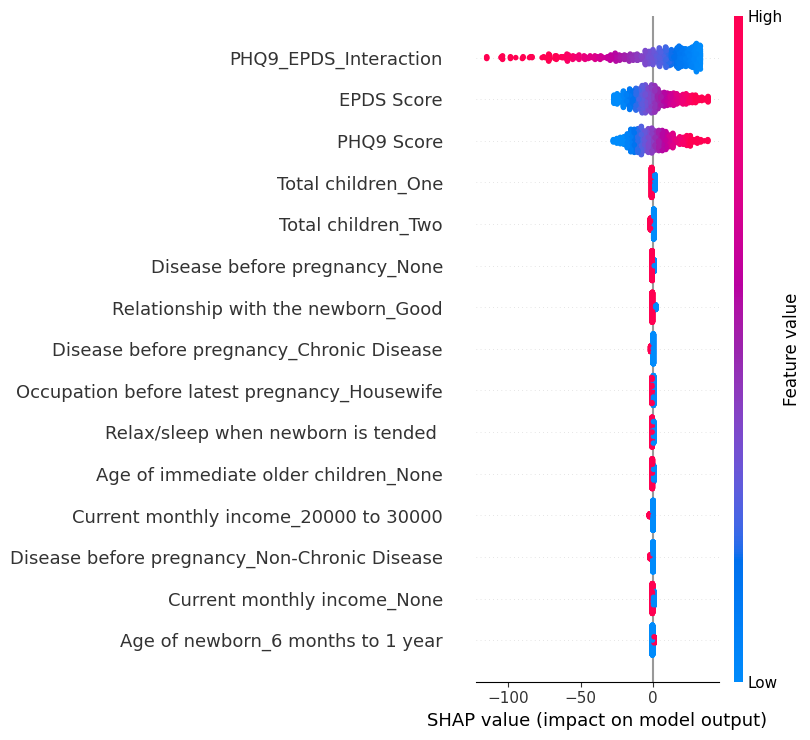


Explaining model: GradientBoosting on target: PHQ9 Result_Moderate


PermutationExplainer explainer: 640it [00:23, 16.11it/s]                                                               


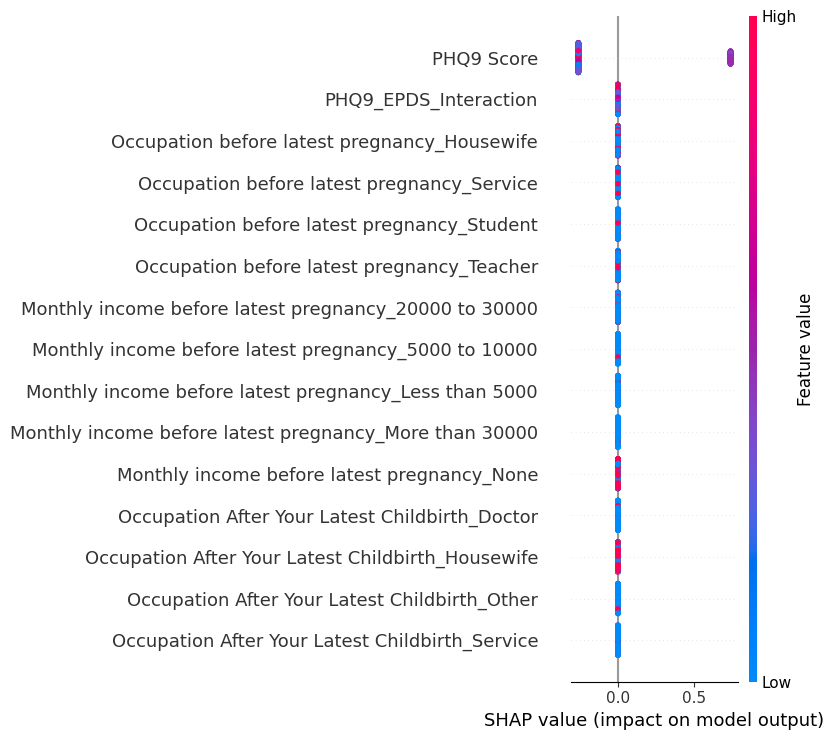


Explaining model: RandomForest on target: PHQ9 Result_Moderately Severe


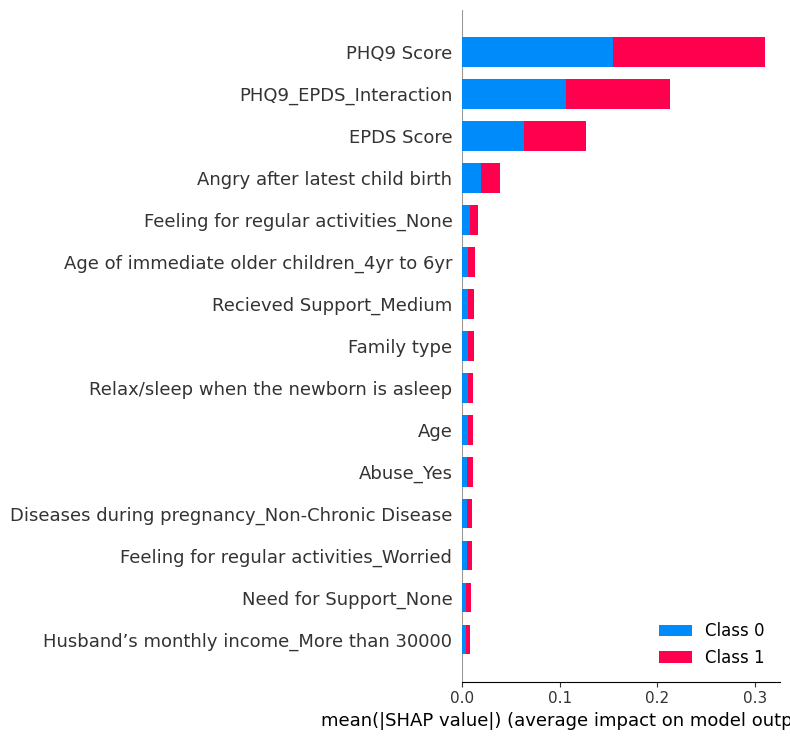


Explaining model: SVM on target: PHQ9 Result_Moderately Severe
❌ Error explaining SVM on PHQ9 Result_Moderately Severe: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Moderately Severe
❌ Error explaining XGBoost on PHQ9 Result_Moderately Severe: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Moderately Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


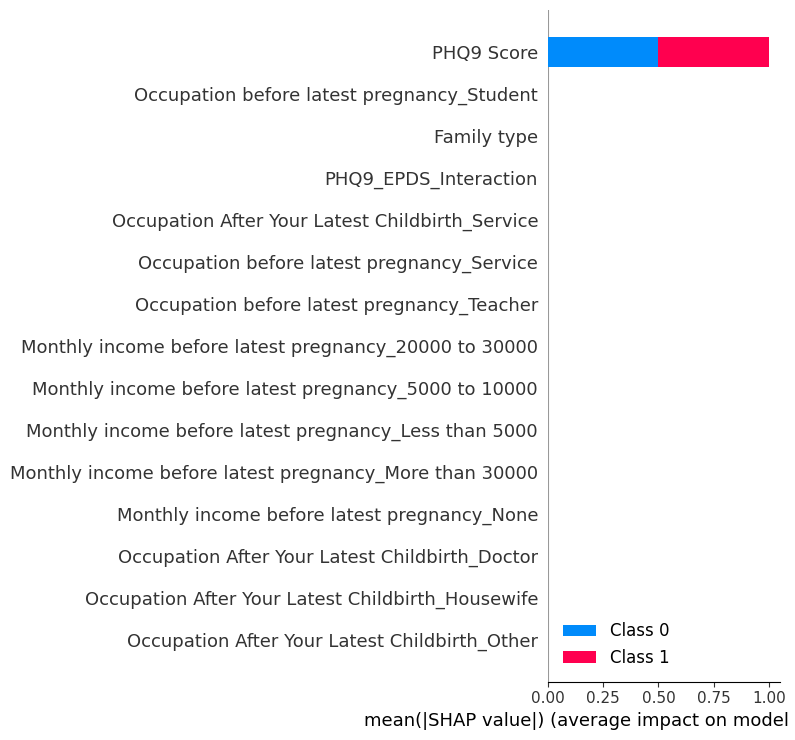


Explaining model: LogisticRegression on target: PHQ9 Result_Moderately Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


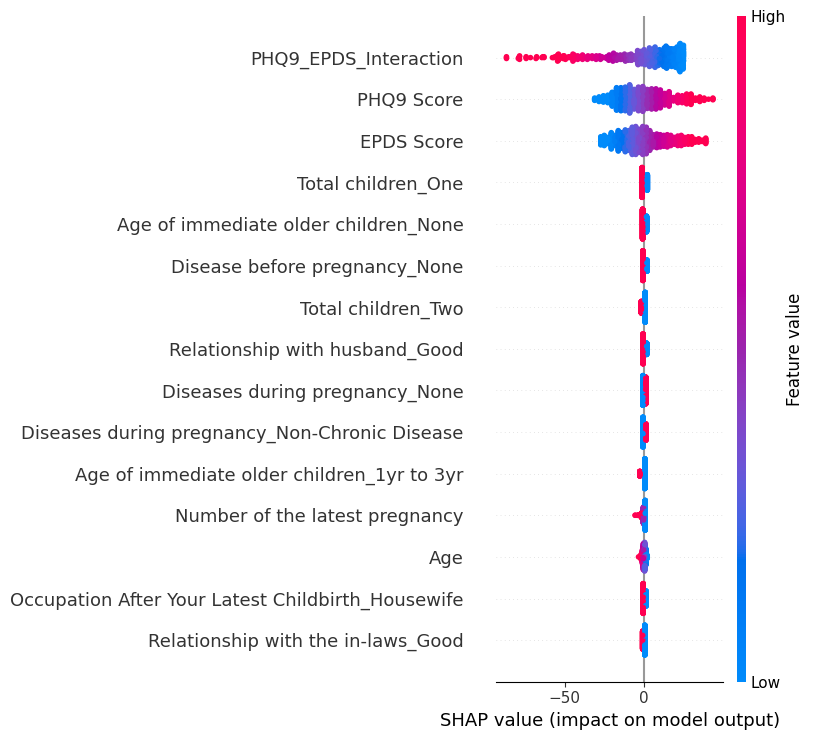


Explaining model: GradientBoosting on target: PHQ9 Result_Moderately Severe


PermutationExplainer explainer: 640it [00:22, 16.35it/s]                                                               


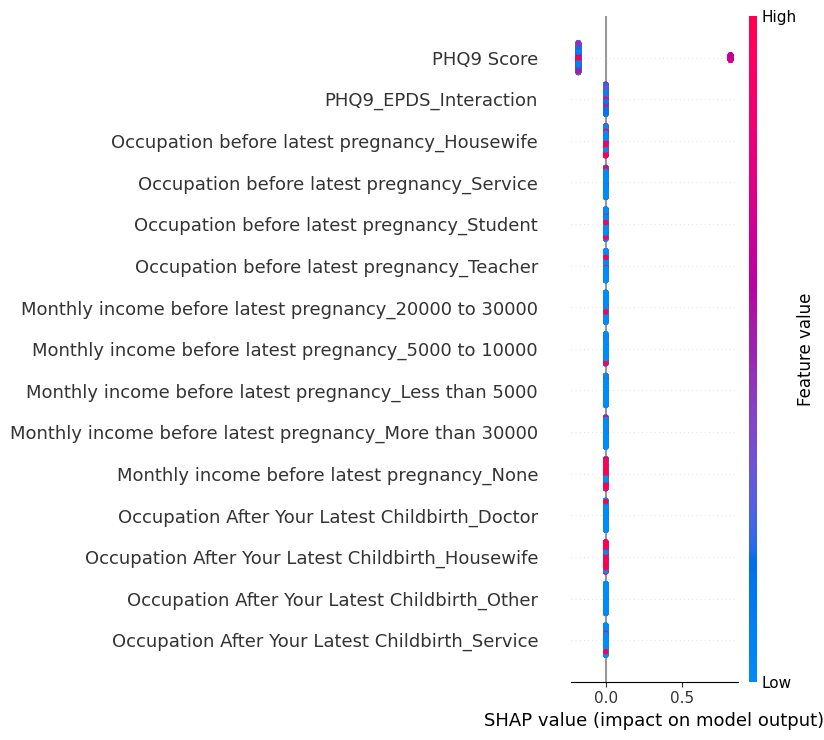


Explaining model: RandomForest on target: PHQ9 Result_Normal


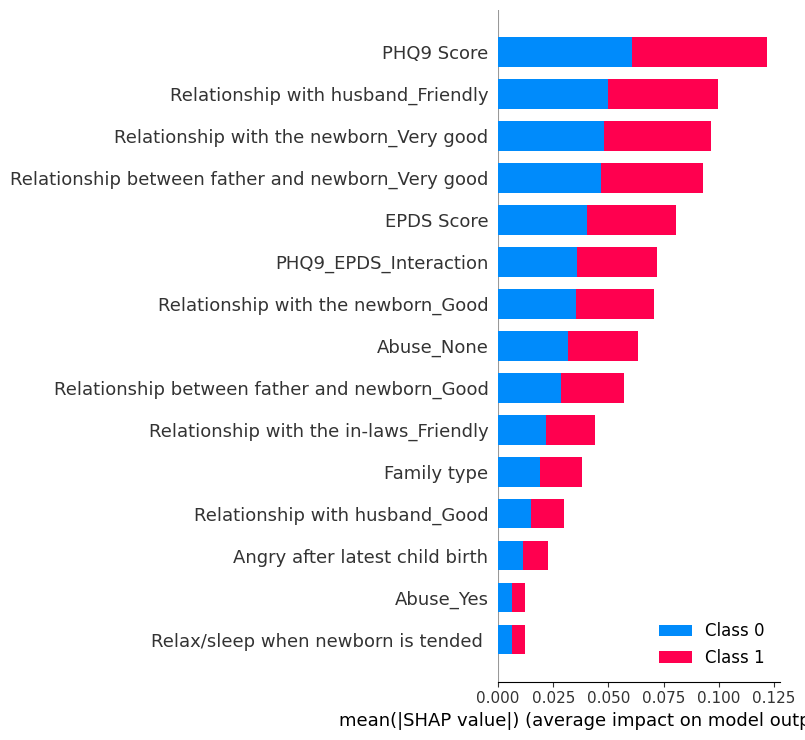


Explaining model: SVM on target: PHQ9 Result_Normal
❌ Error explaining SVM on PHQ9 Result_Normal: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Normal
❌ Error explaining XGBoost on PHQ9 Result_Normal: 'utf-8' codec can't decode byte 0xbf in position 6795: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Normal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


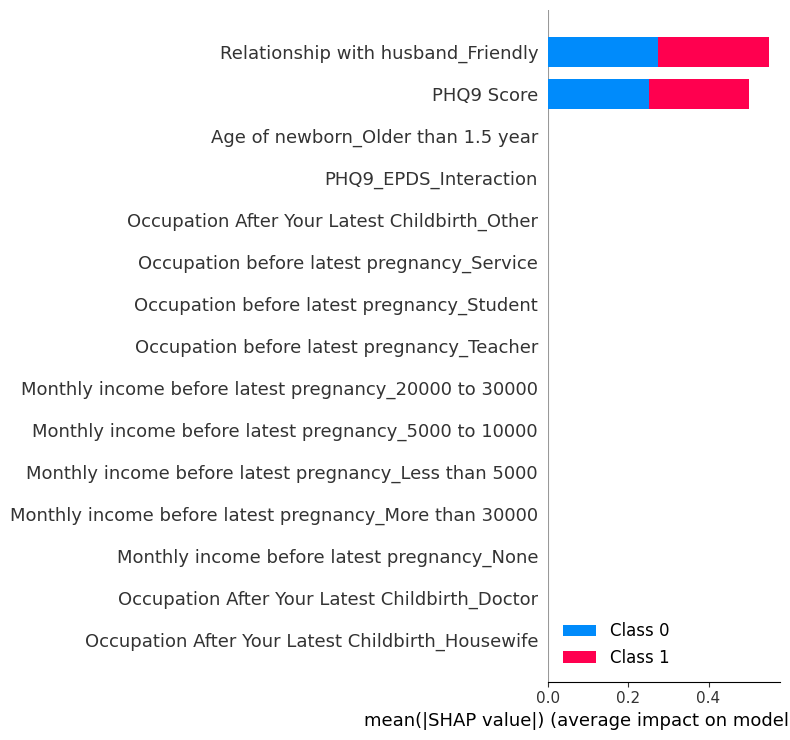


Explaining model: LogisticRegression on target: PHQ9 Result_Normal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


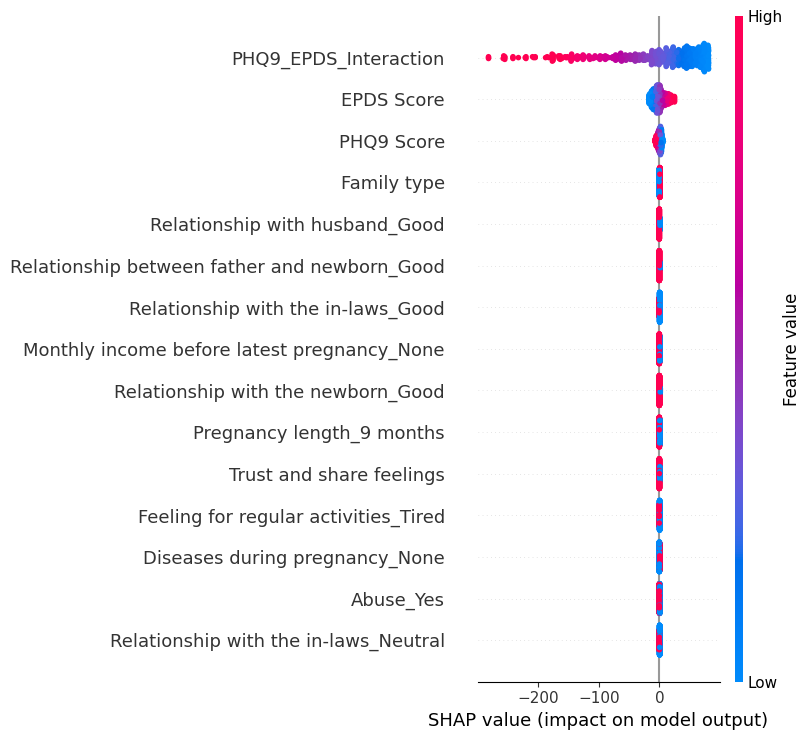


Explaining model: GradientBoosting on target: PHQ9 Result_Normal


PermutationExplainer explainer: 640it [00:21, 16.26it/s]                                                               


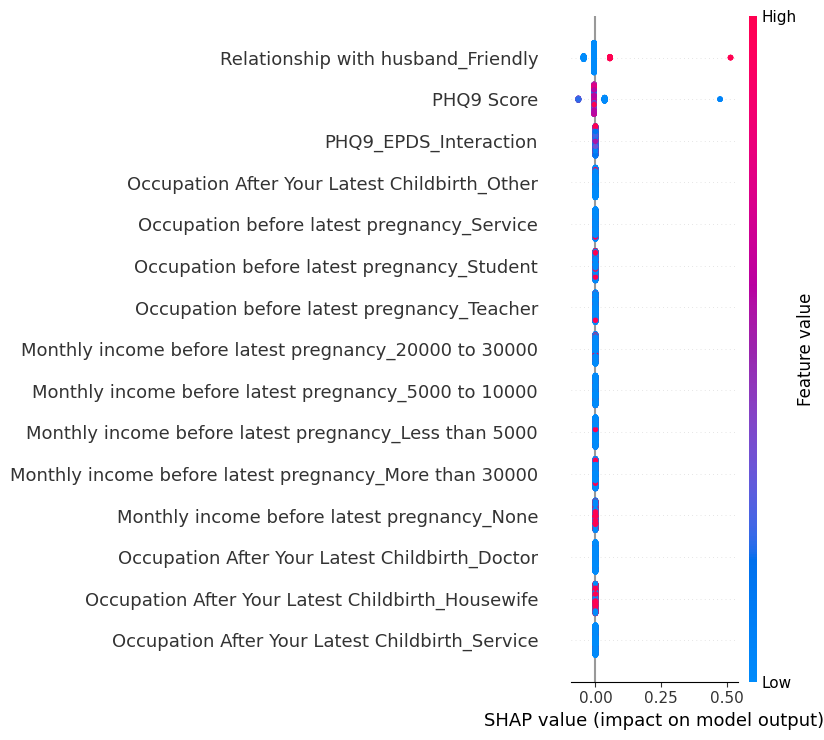


Explaining model: RandomForest on target: PHQ9 Result_Severe


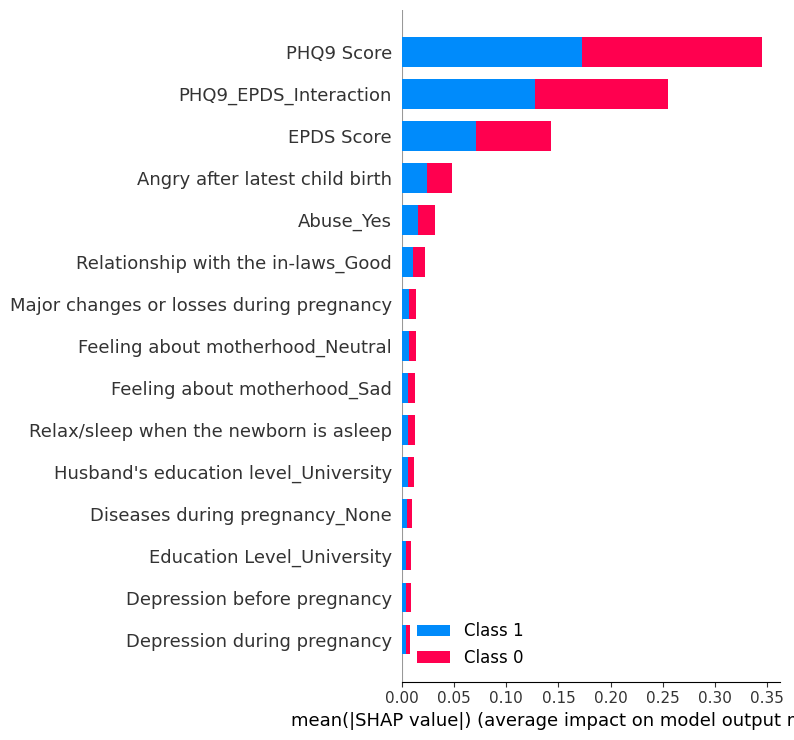


Explaining model: SVM on target: PHQ9 Result_Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


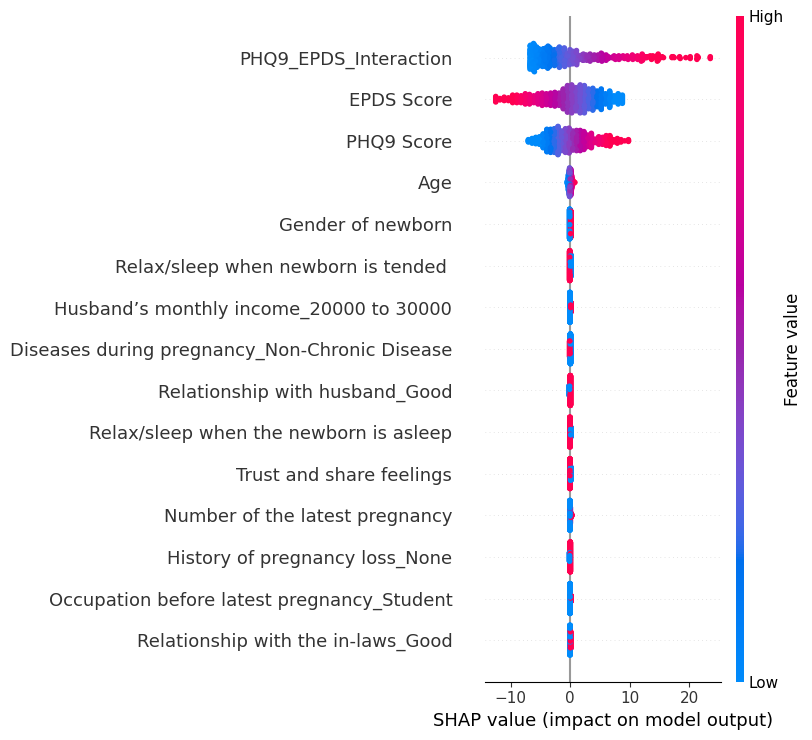


Explaining model: XGBoost on target: PHQ9 Result_Severe
❌ Error explaining XGBoost on PHQ9 Result_Severe: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Severe


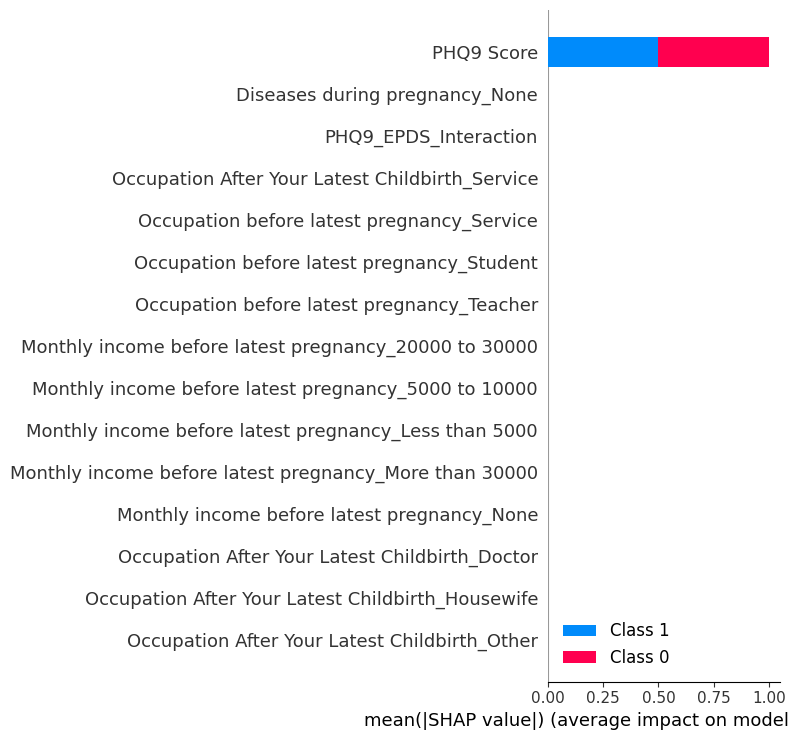


Explaining model: LogisticRegression on target: PHQ9 Result_Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


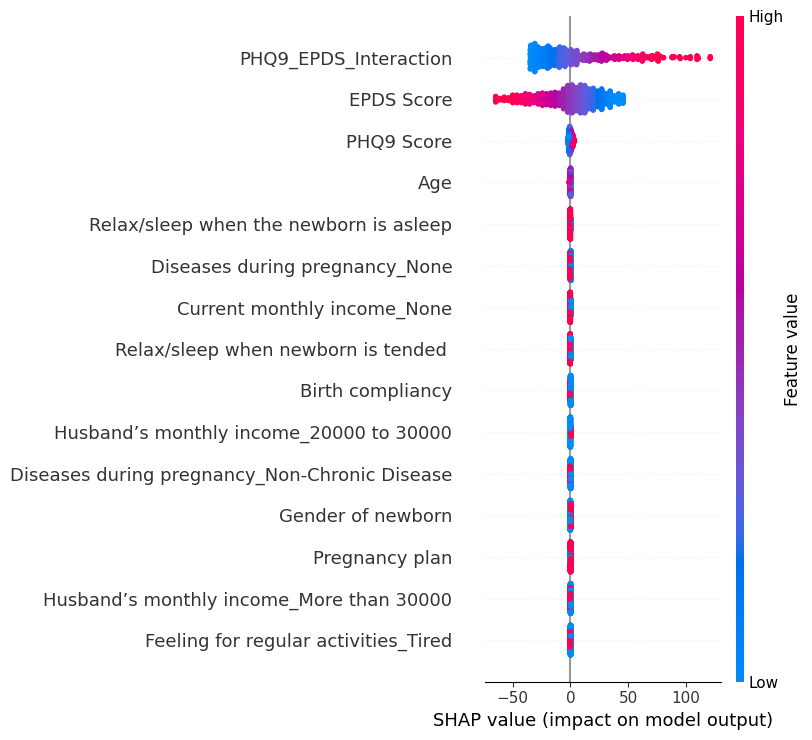


Explaining model: GradientBoosting on target: PHQ9 Result_Severe


PermutationExplainer explainer: 640it [00:21, 16.28it/s]                                                               


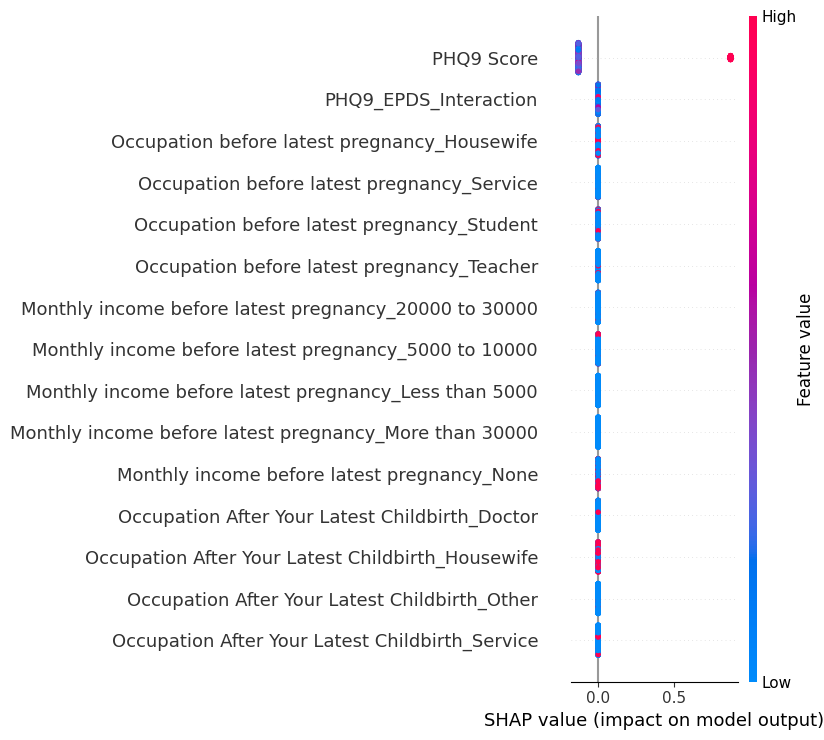


Explaining model: RandomForest on target: EPDS Result_low


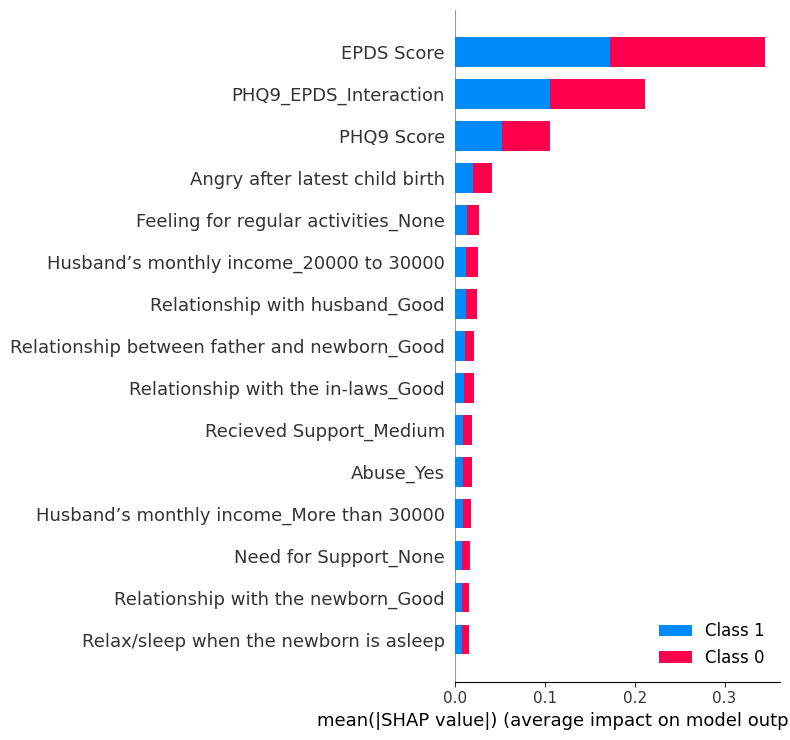


Explaining model: SVM on target: EPDS Result_low
❌ Error explaining SVM on EPDS Result_low: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: EPDS Result_low
❌ Error explaining XGBoost on EPDS Result_low: 'utf-8' codec can't decode byte 0x84 in position 6303: invalid start byte

Explaining model: DecisionTree on target: EPDS Result_low


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


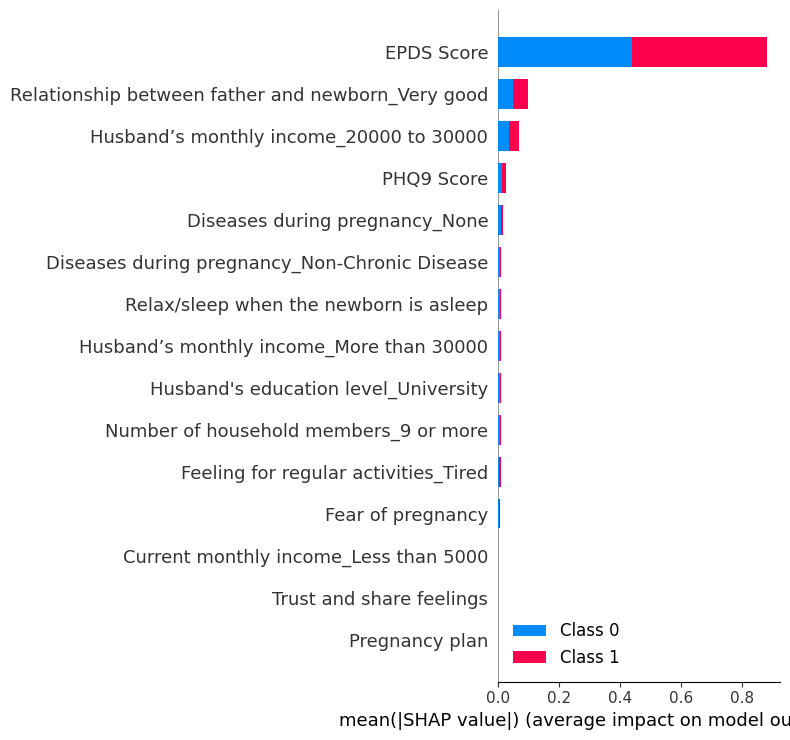


Explaining model: LogisticRegression on target: EPDS Result_low


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


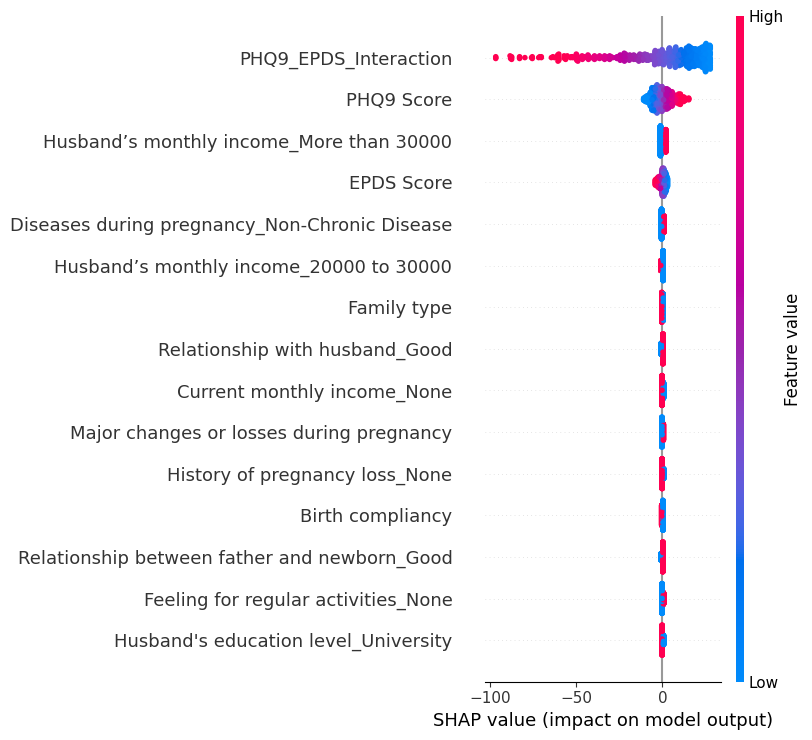


Explaining model: GradientBoosting on target: EPDS Result_low


PermutationExplainer explainer: 640it [00:28, 15.08it/s]                                                               


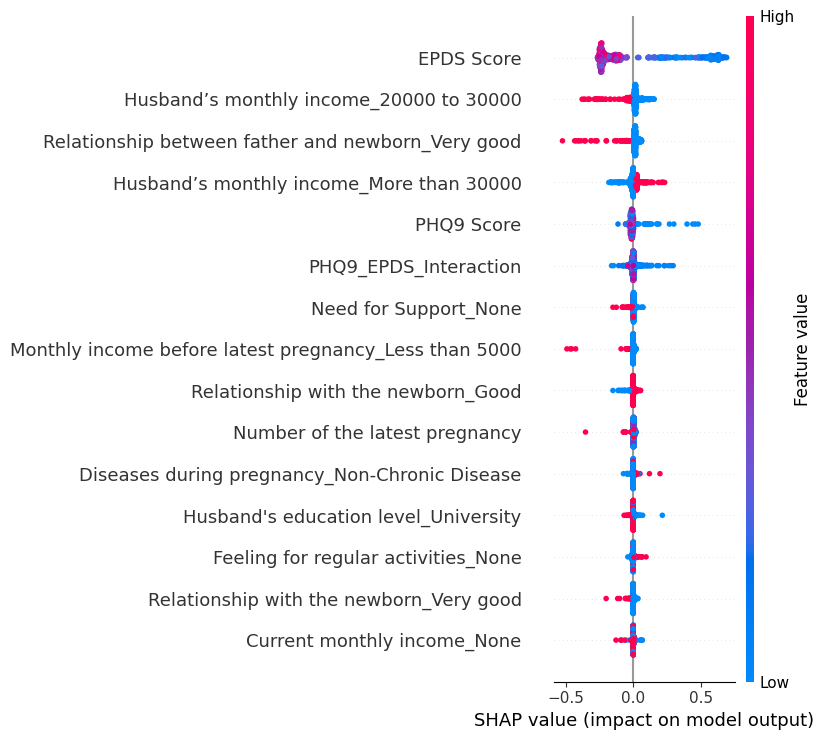


Explaining model: RandomForest on target: EPDS Result_medium


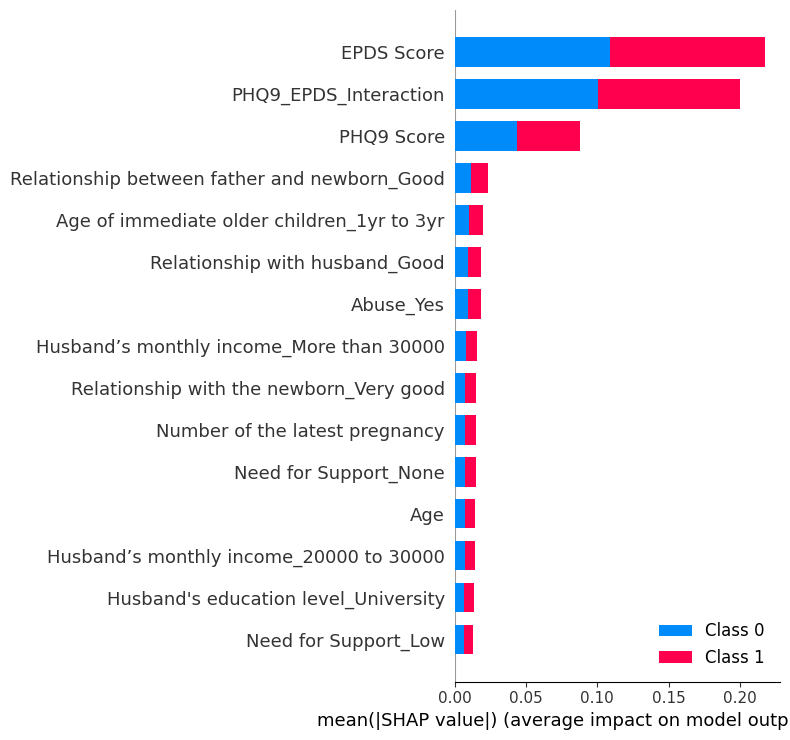


Explaining model: SVM on target: EPDS Result_medium
❌ Error explaining SVM on EPDS Result_medium: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: EPDS Result_medium
❌ Error explaining XGBoost on EPDS Result_medium: 'utf-8' codec can't decode byte 0xbe in position 6786: invalid start byte

Explaining model: DecisionTree on target: EPDS Result_medium


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


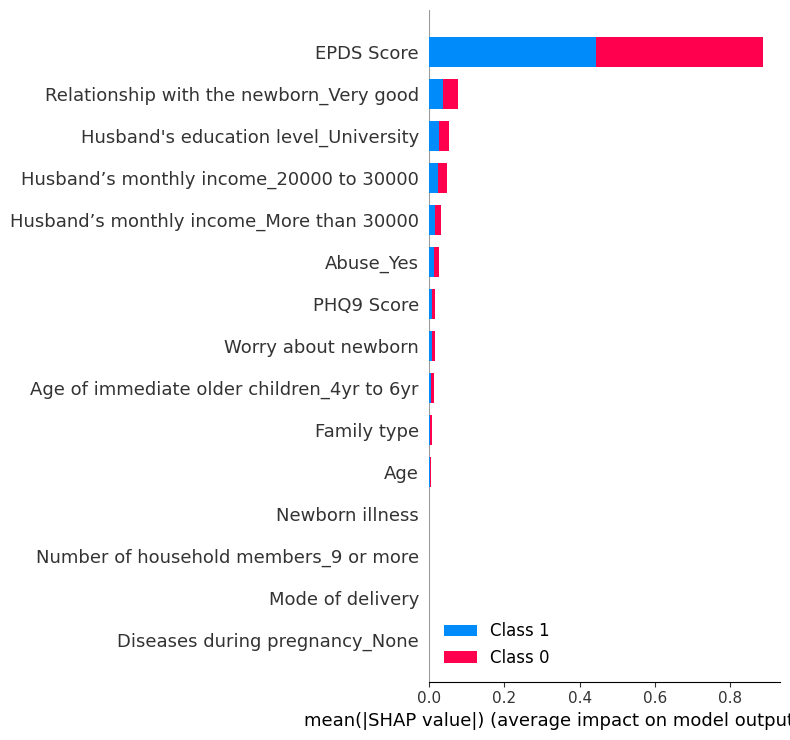


Explaining model: LogisticRegression on target: EPDS Result_medium


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


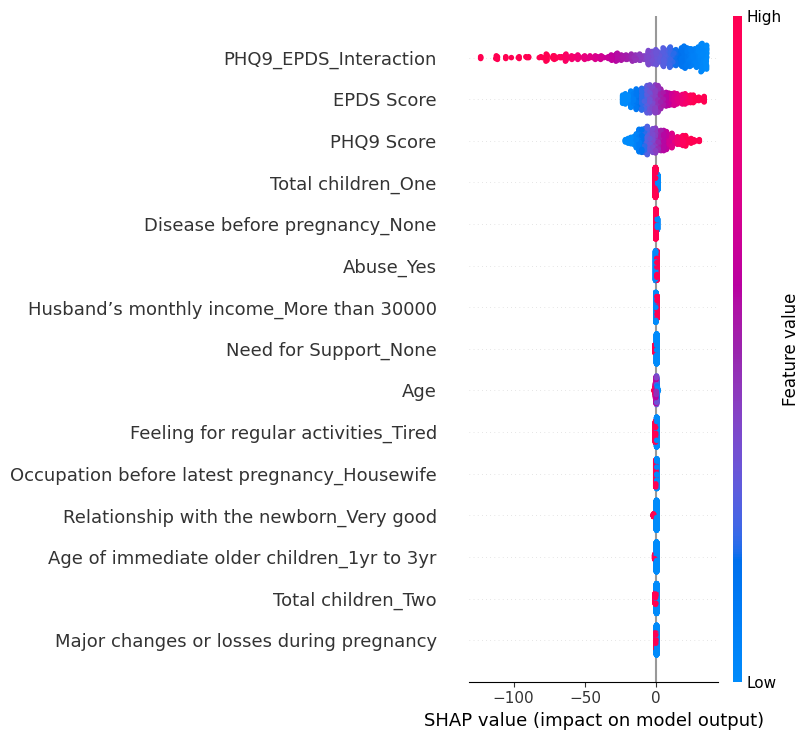


Explaining model: GradientBoosting on target: EPDS Result_medium


PermutationExplainer explainer: 640it [00:36, 13.07it/s]                                                               


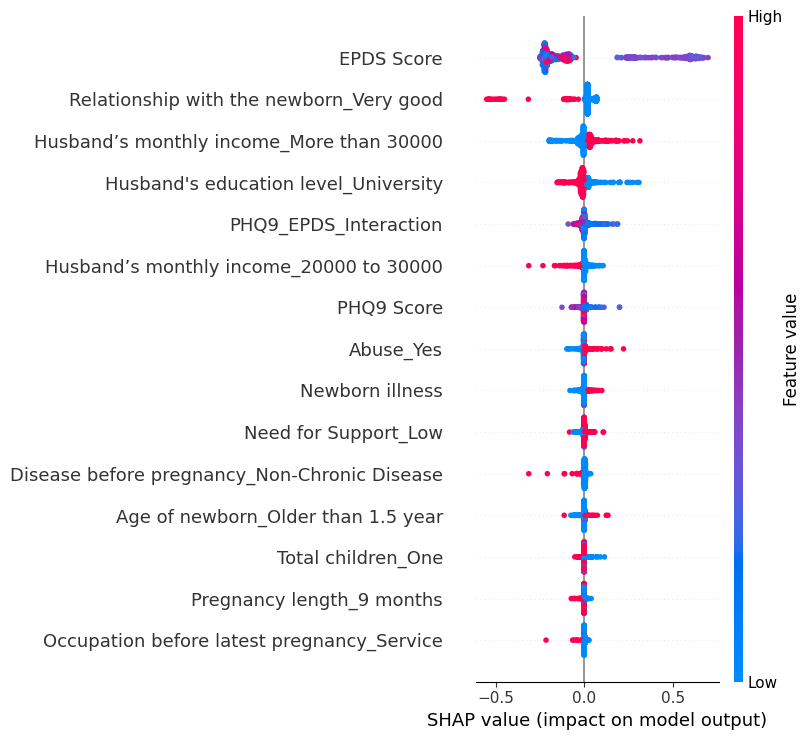

In [29]:
import shap
import matplotlib.pyplot as plt

for (model_name, target_variable), model in best_models.items():
    print(f"\nExplaining model: {model_name} on target: {target_variable}")
    
    try:
        X_explain = X_train_engineered.copy()

        # Add interaction term if used
        if 'PHQ9 Score' in X_explain.columns and 'EPDS Score' in X_explain.columns:
            X_explain['PHQ9_EPDS_Interaction'] = X_explain['PHQ9 Score'] * X_explain['EPDS Score']
        
        # SHAP explainer setup
        if model_name == 'XGBoost':
            explainer = shap.TreeExplainer(model.get_booster())  # ✅ Use booster directly
            shap_values = explainer.shap_values(X_explain)
        
        elif model_name in ['RandomForest', 'DecisionTree']:
            explainer = shap.TreeExplainer(model)
            shap_values = explainer.shap_values(X_explain)

        elif model_name in ['LogisticRegression', 'SVM']:
            explainer = shap.LinearExplainer(model, X_explain, feature_perturbation="independent")
            shap_values = explainer.shap_values(X_explain)

        else:
            explainer = shap.Explainer(model.predict, X_explain)
            shap_values = explainer(X_explain)

        # Plot summary
        shap.summary_plot(shap_values, X_explain, max_display=15, show=True)

    except Exception as e:
        print(f"❌ Error explaining {model_name} on {target_variable}: {e}")


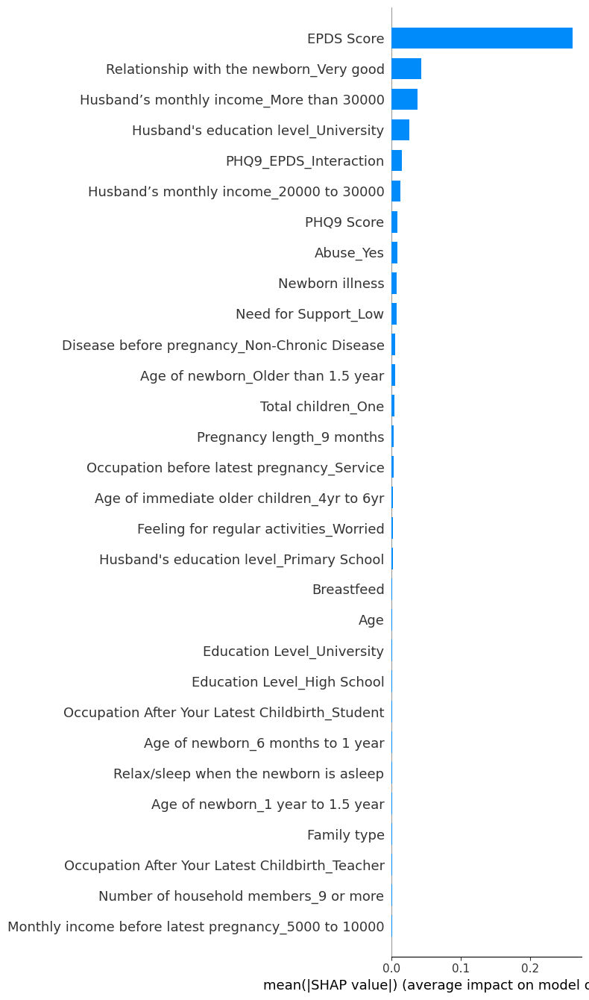

In [31]:
# Bar plot of mean(|SHAP|) values
shap.summary_plot(shap_values, X_explain, plot_type="bar", max_display=30)



Explaining model: RandomForest on target: PHQ9 Result_Minimal


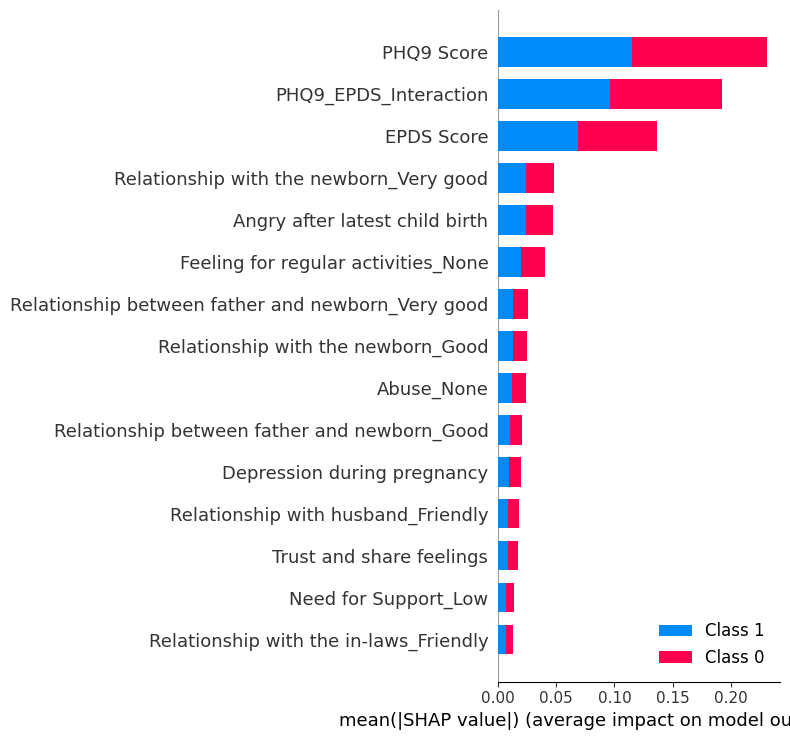

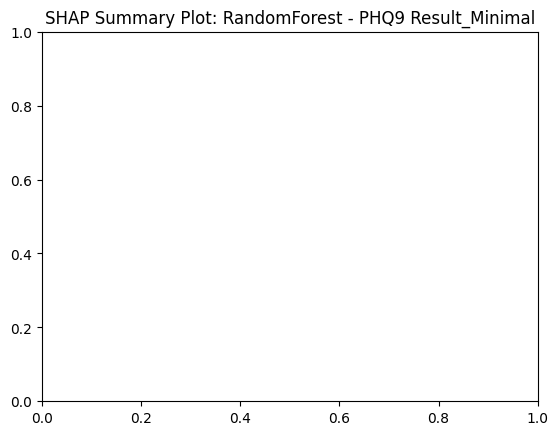

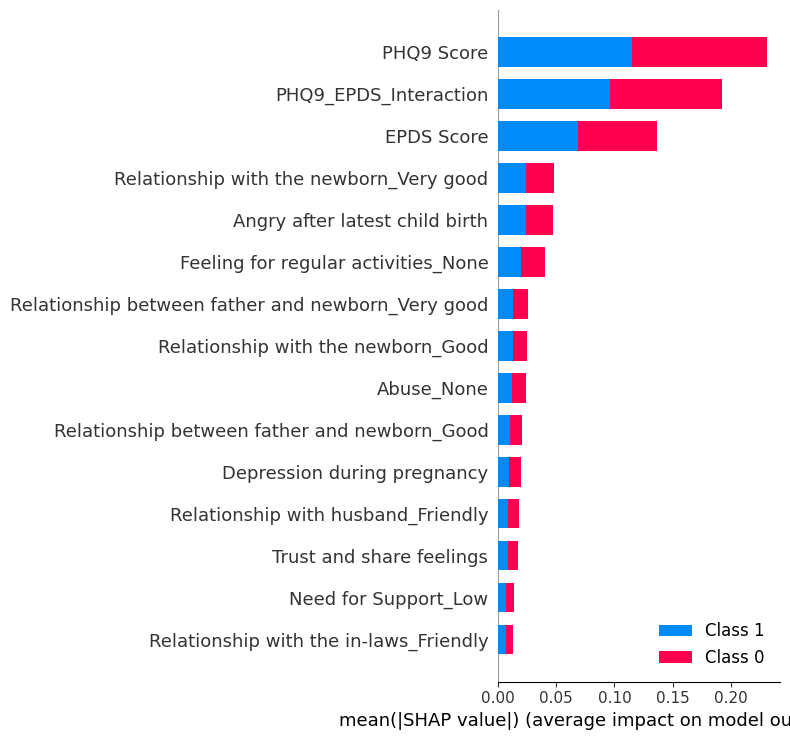

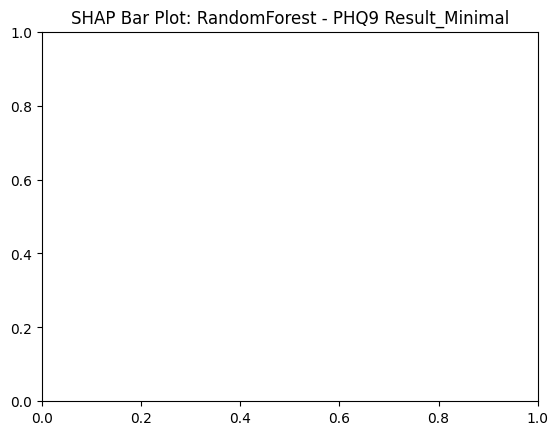

❌ Error explaining RandomForest on PHQ9 Result_Minimal: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: PHQ9 Result_Minimal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


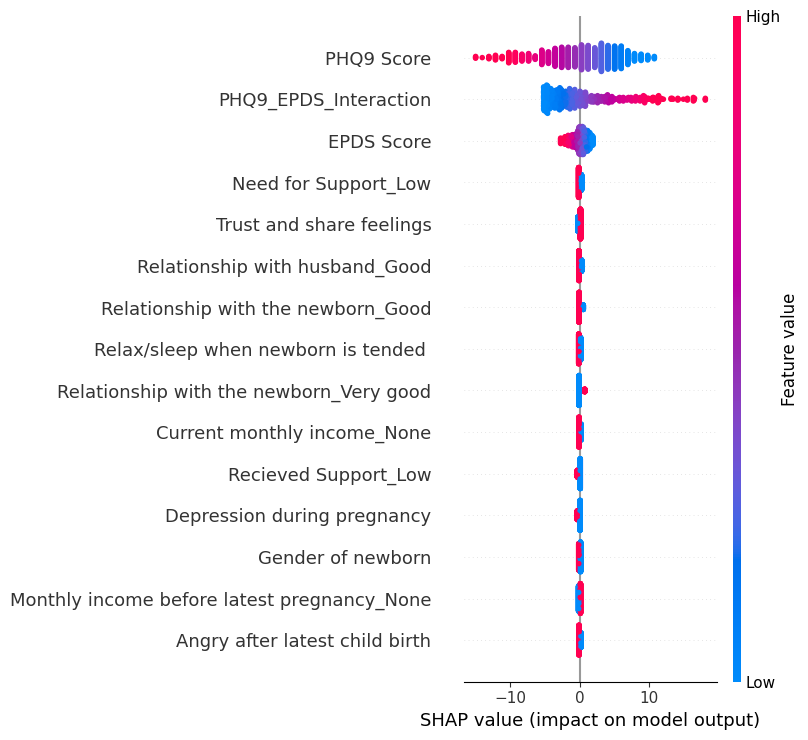

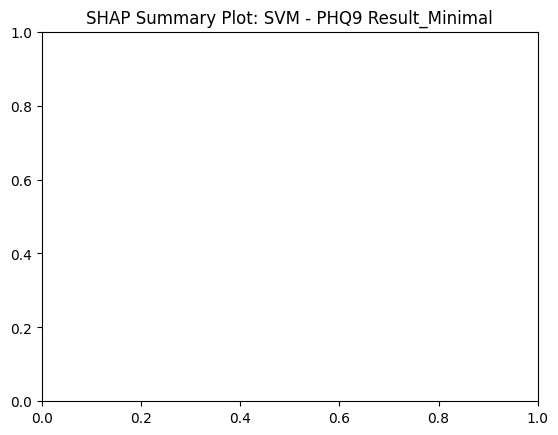

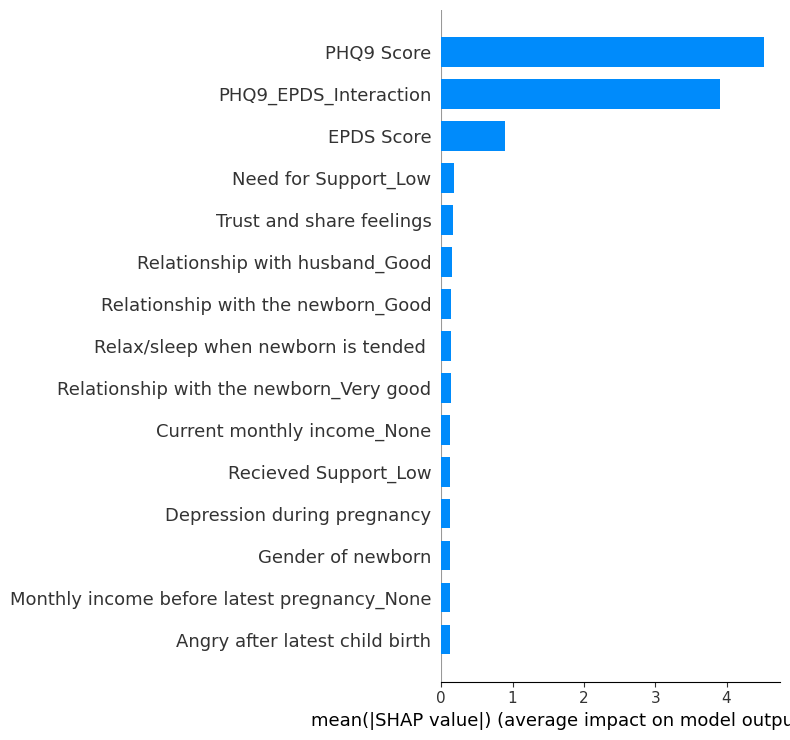

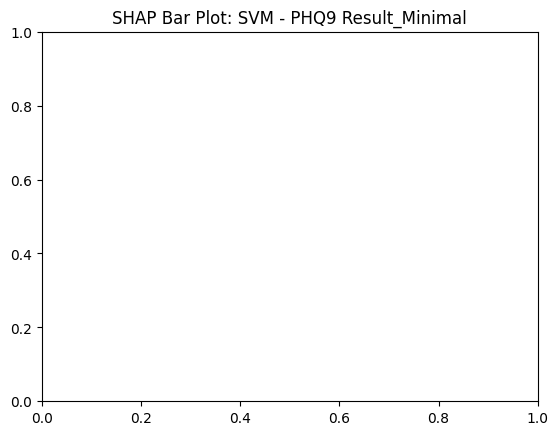

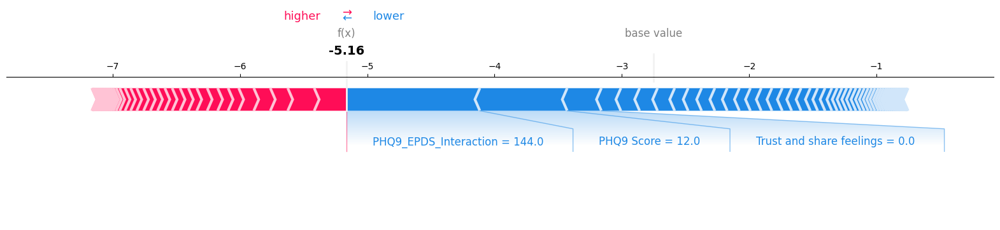

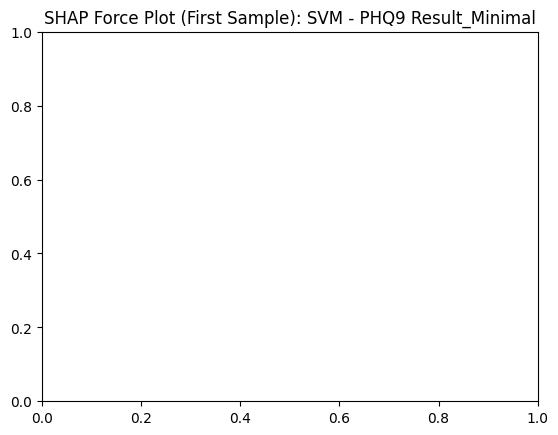


Explaining model: XGBoost on target: PHQ9 Result_Minimal
❌ Error explaining XGBoost on PHQ9 Result_Minimal: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Minimal


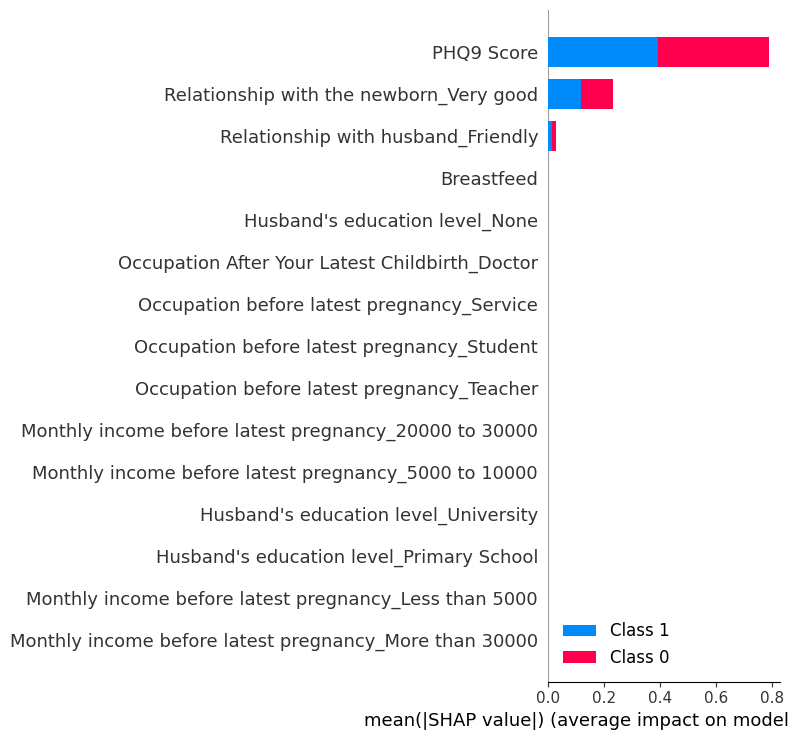

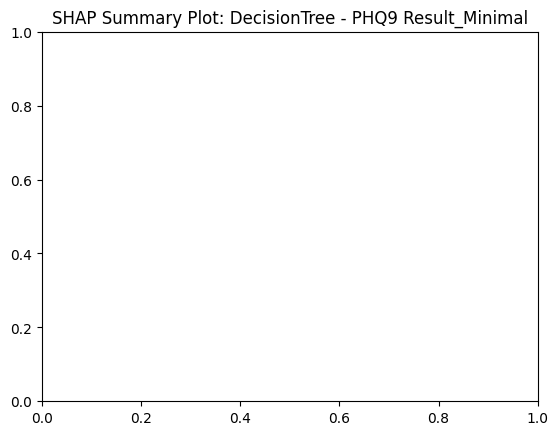

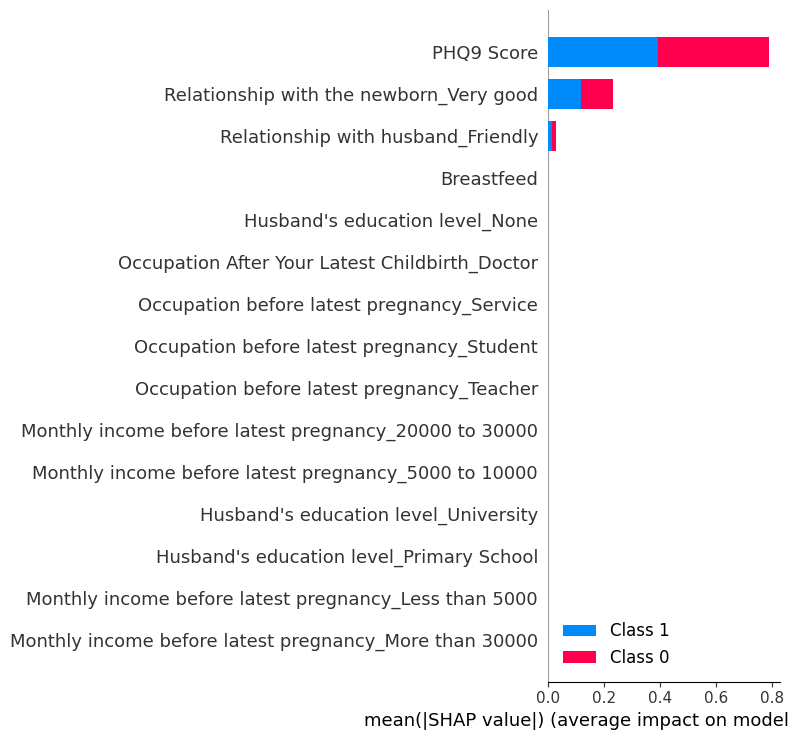

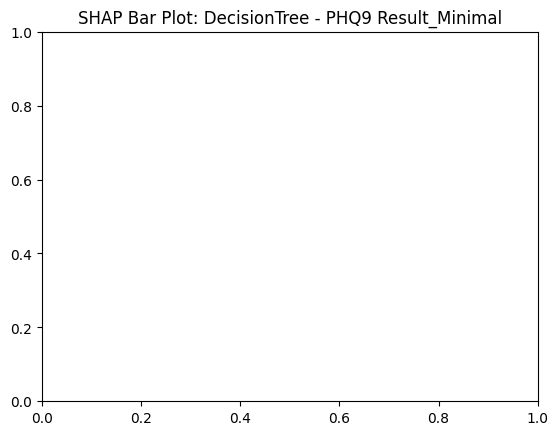

❌ Error explaining DecisionTree on PHQ9 Result_Minimal: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: PHQ9 Result_Minimal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


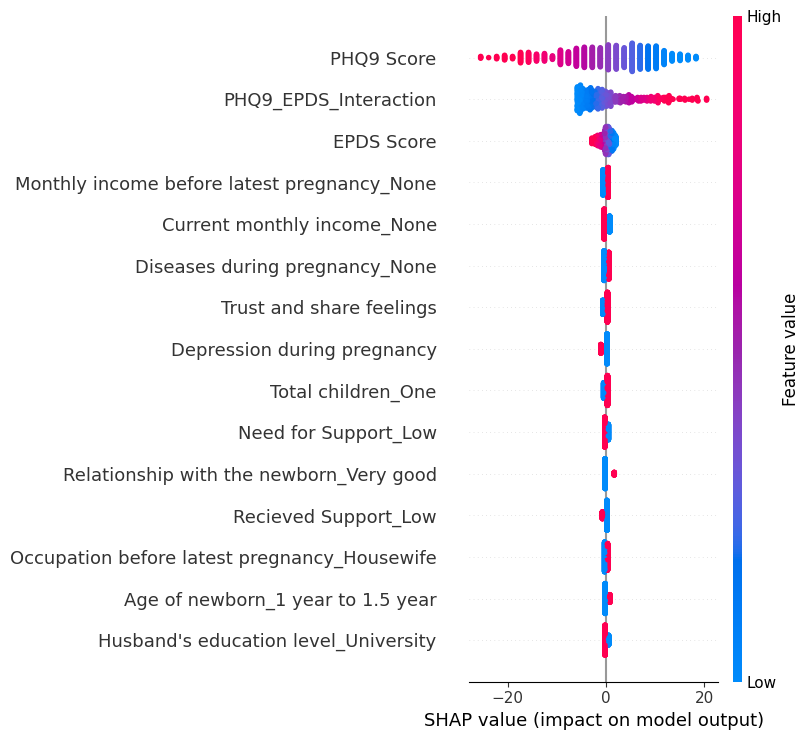

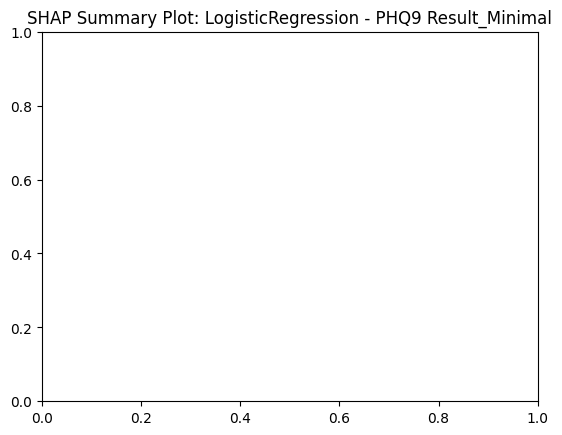

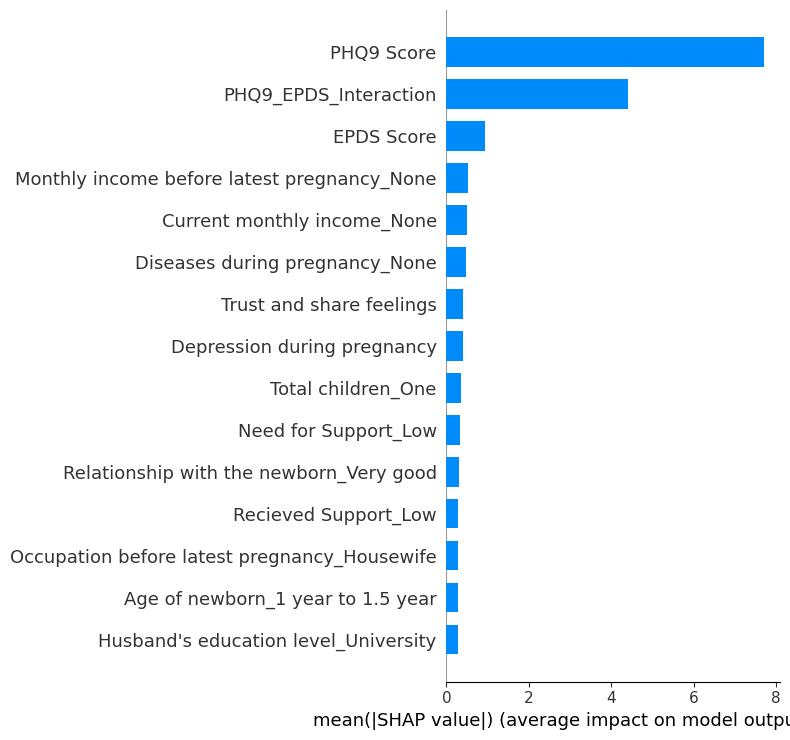

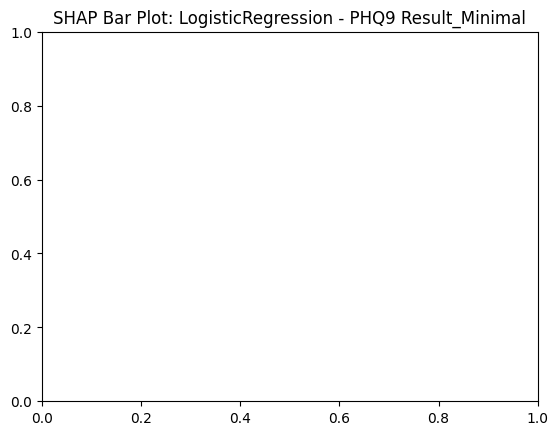

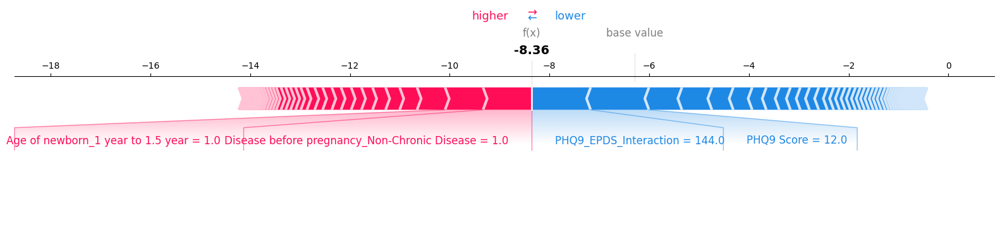

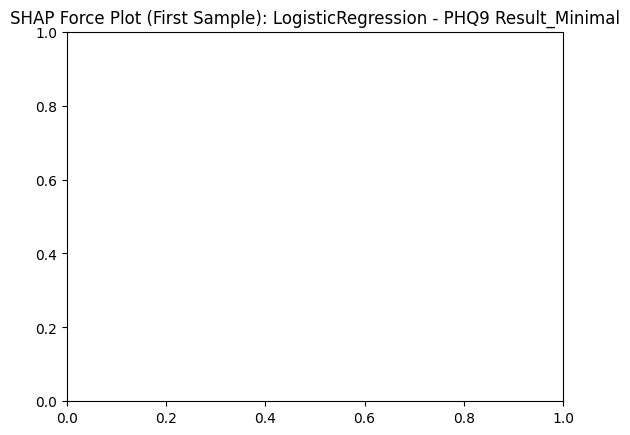


Explaining model: GradientBoosting on target: PHQ9 Result_Minimal


PermutationExplainer explainer: 640it [00:30, 14.37it/s]                                                               


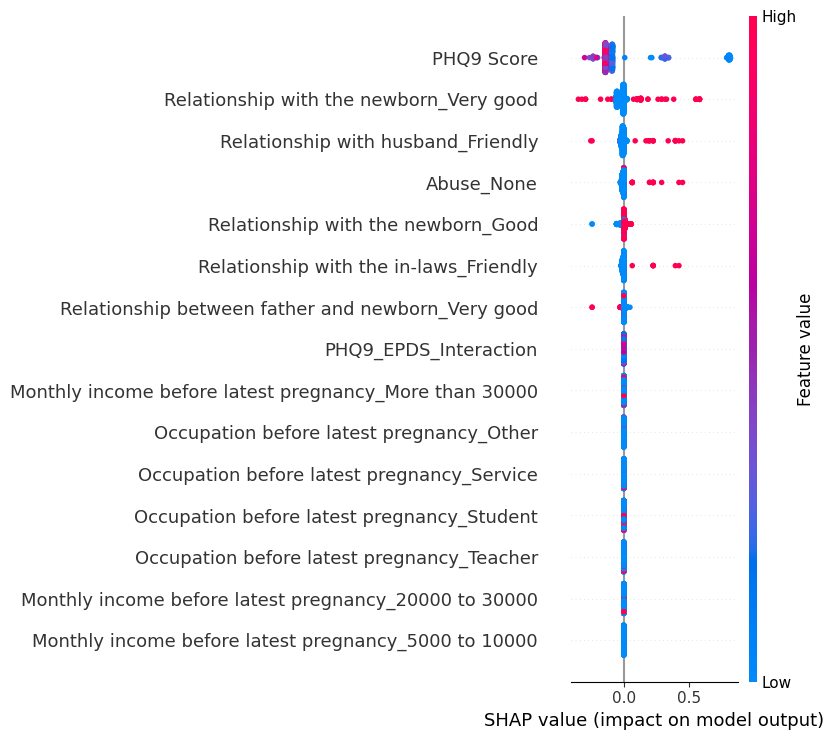

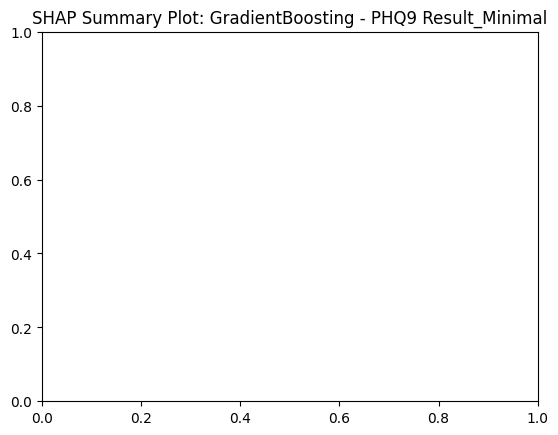

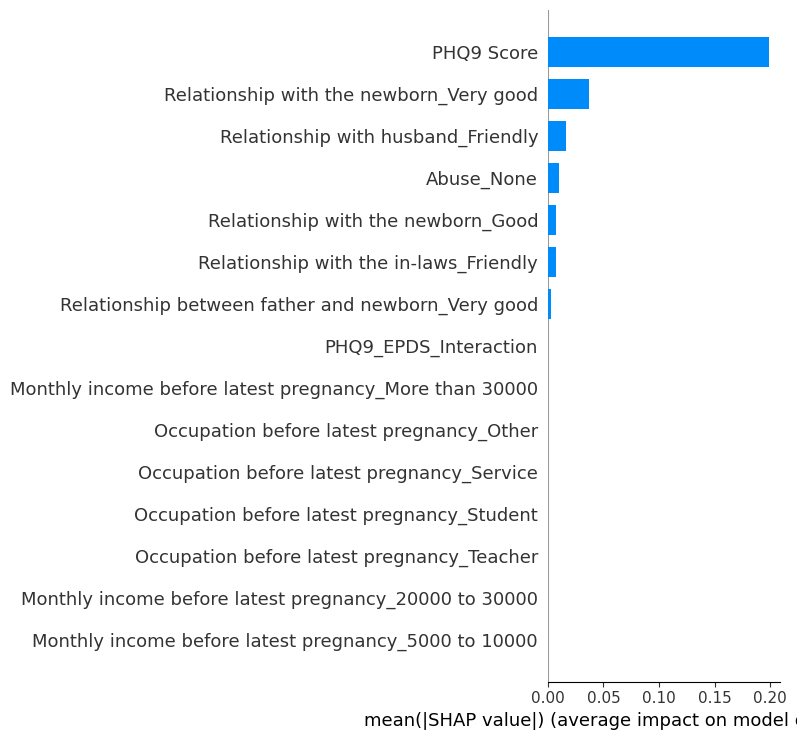

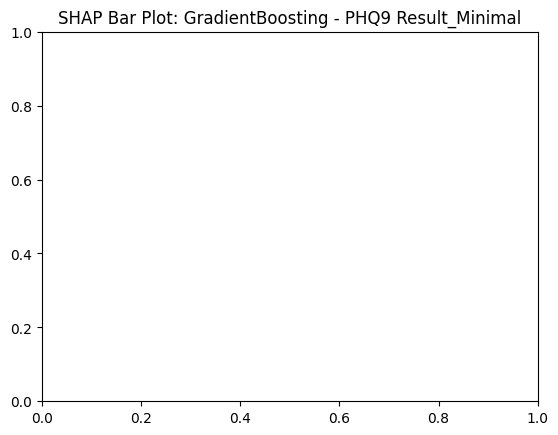

❌ Error explaining GradientBoosting on PHQ9 Result_Minimal: 'PermutationExplainer' object has no attribute 'expected_value'

Explaining model: RandomForest on target: PHQ9 Result_Moderate


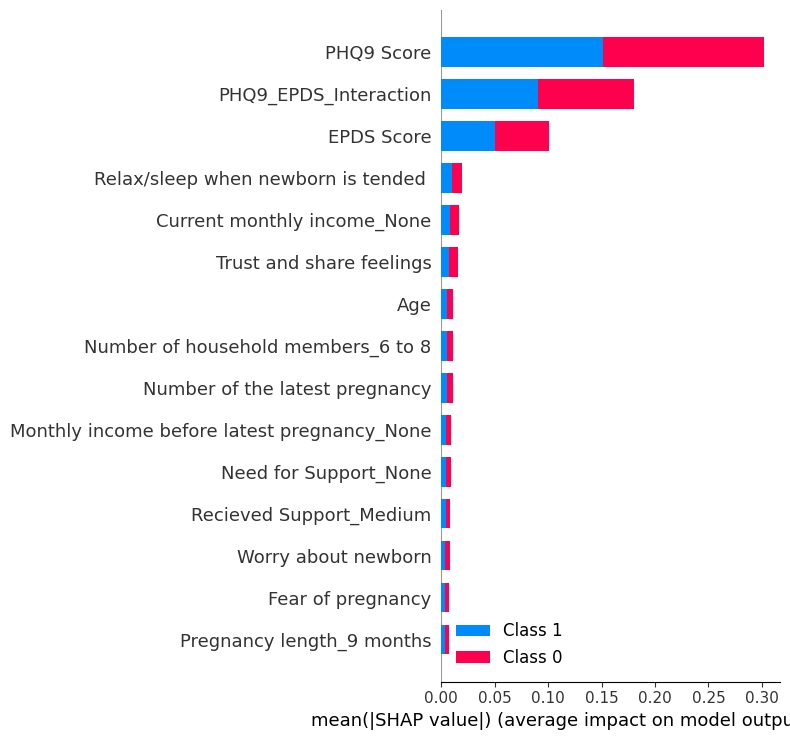

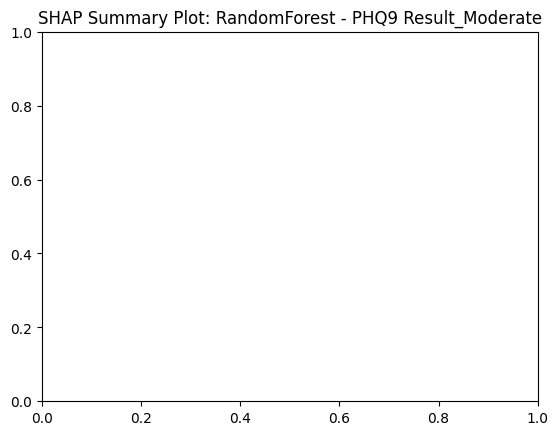

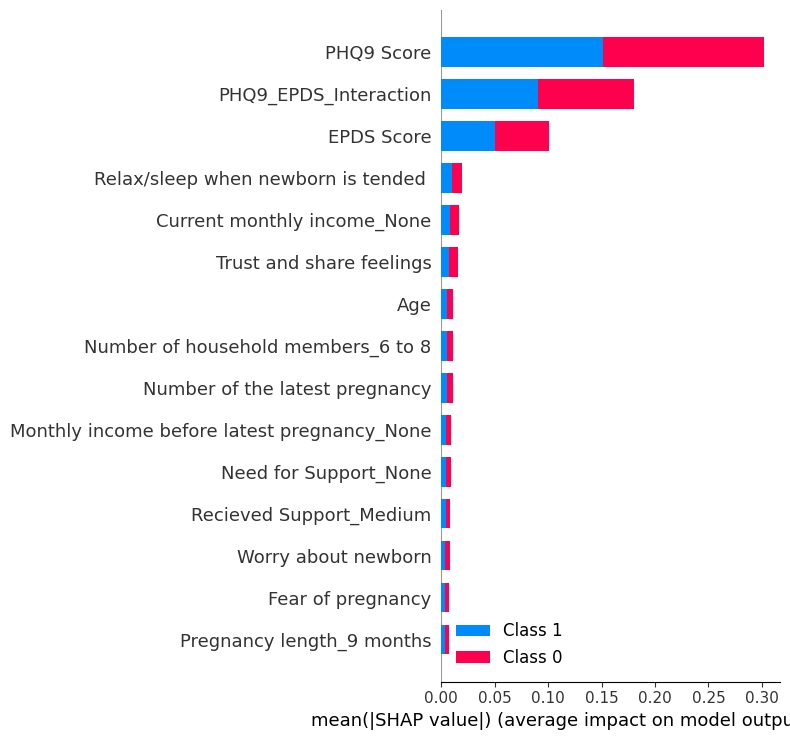

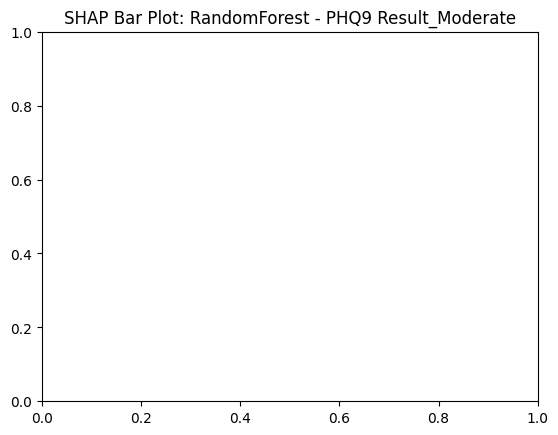

❌ Error explaining RandomForest on PHQ9 Result_Moderate: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: PHQ9 Result_Moderate
❌ Error explaining SVM on PHQ9 Result_Moderate: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Moderate
❌ Error explaining XGBoost on PHQ9 Result_Moderate: 'utf-8' codec can't decode byte 0xbd in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Moderate


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


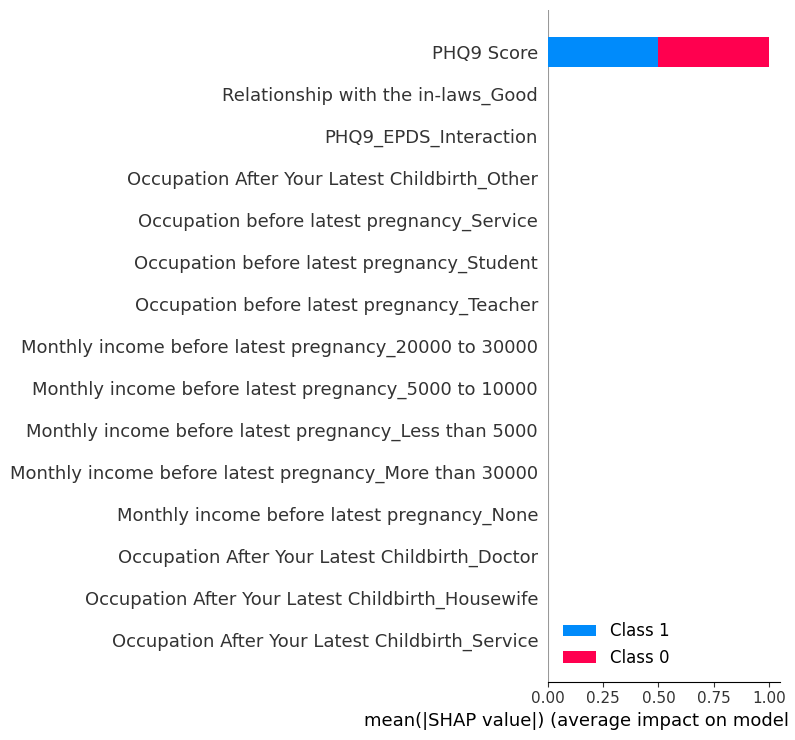

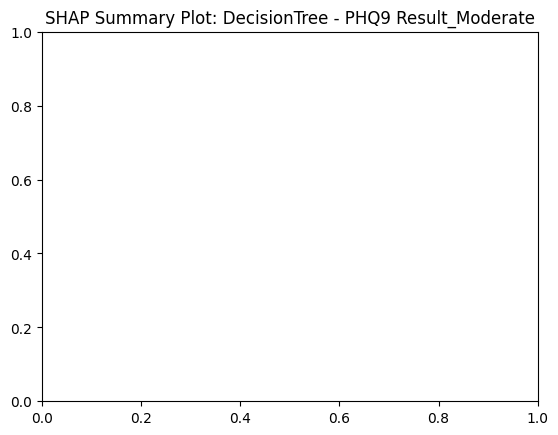

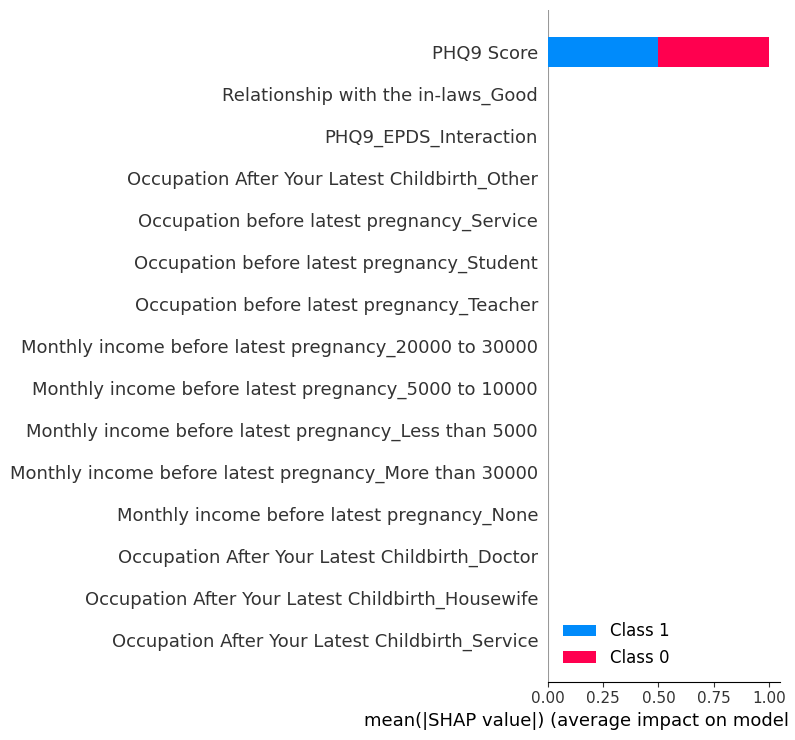

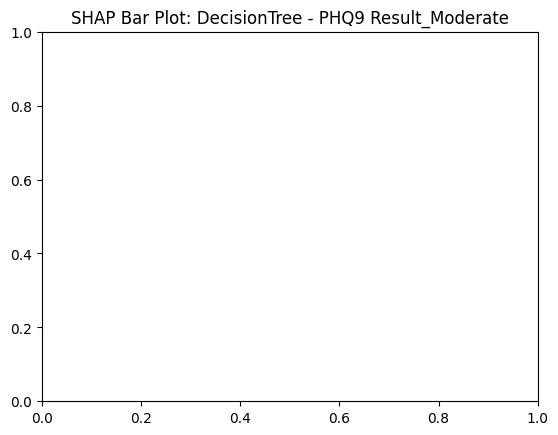

❌ Error explaining DecisionTree on PHQ9 Result_Moderate: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: PHQ9 Result_Moderate


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


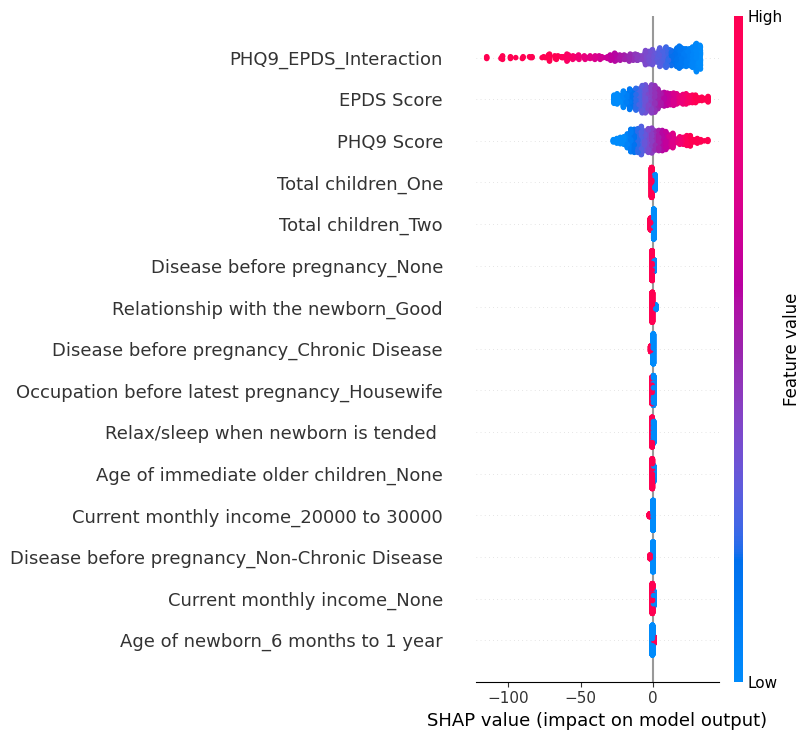

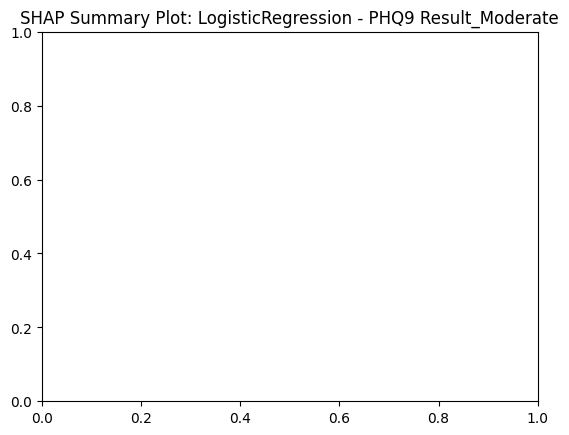

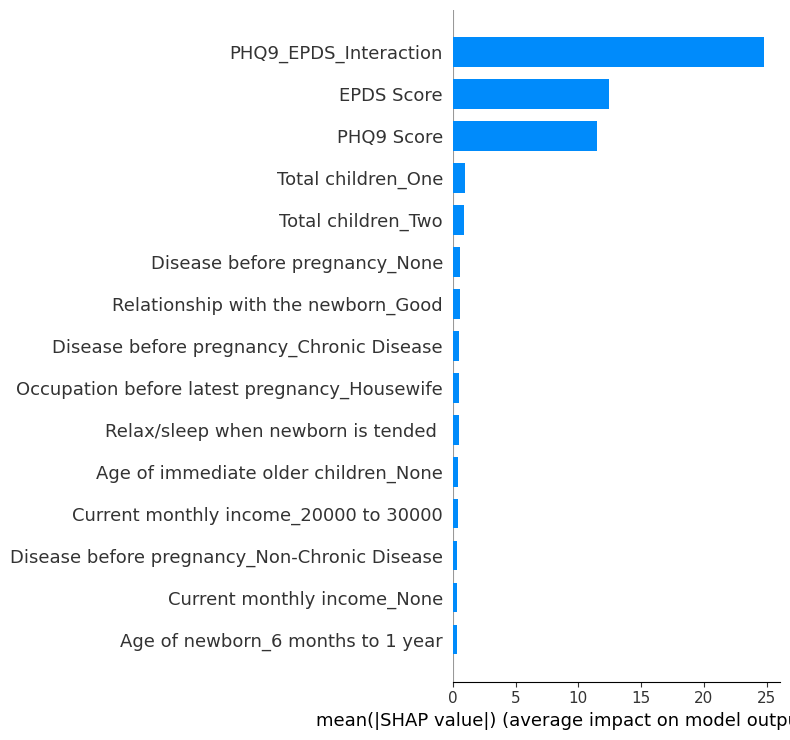

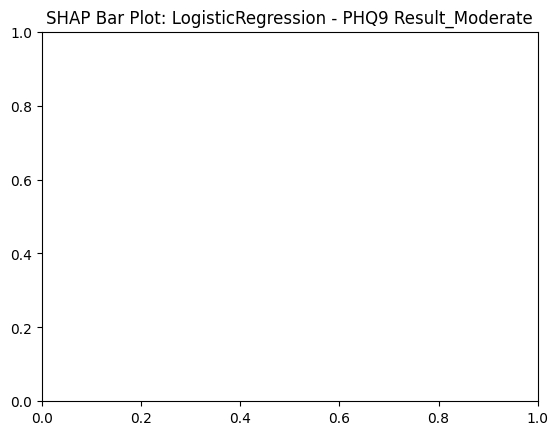

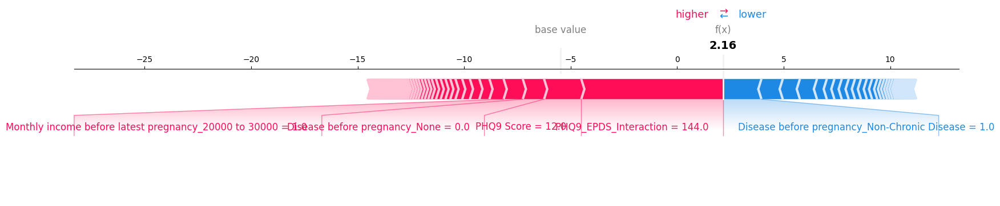

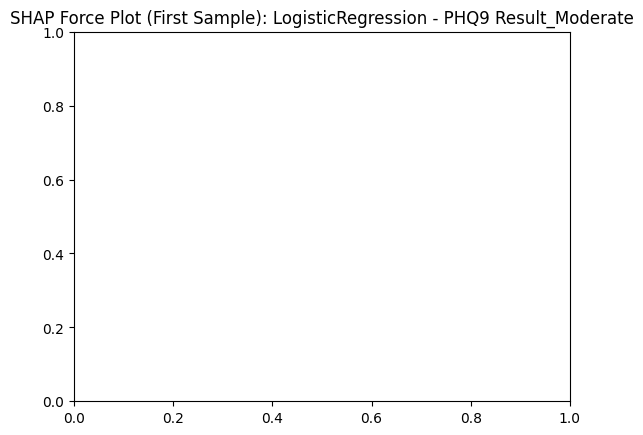


Explaining model: GradientBoosting on target: PHQ9 Result_Moderate


PermutationExplainer explainer: 640it [00:24, 15.77it/s]                                                               


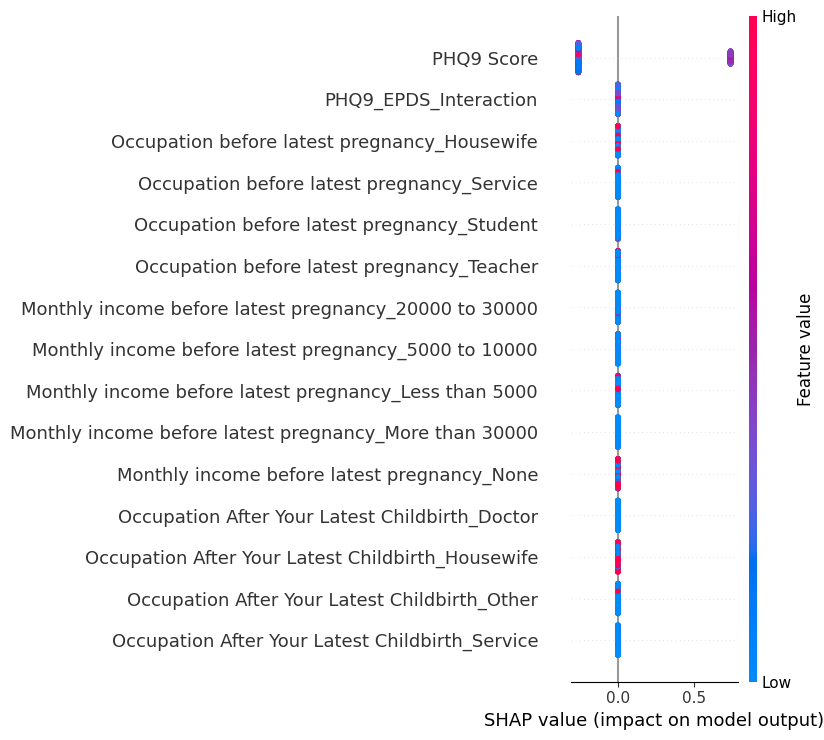

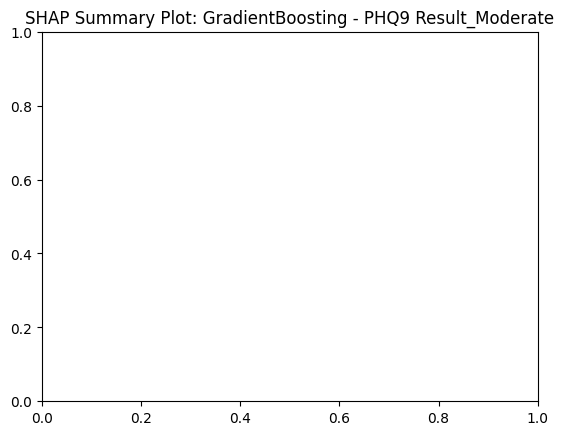

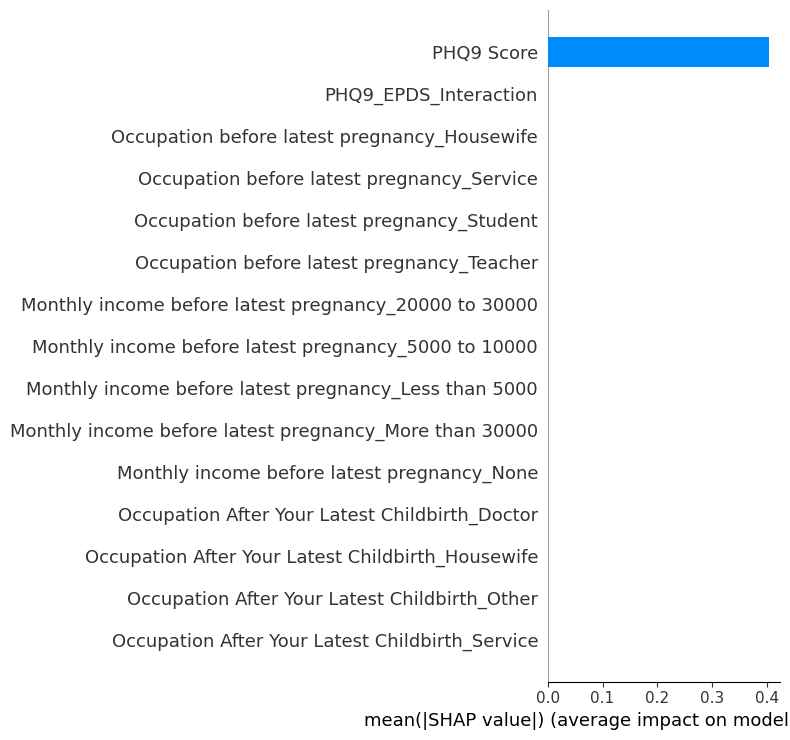

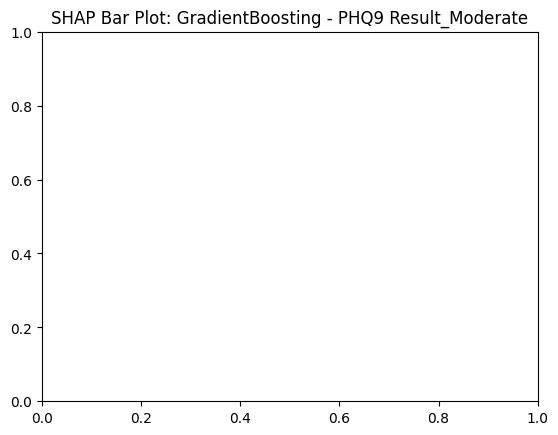

❌ Error explaining GradientBoosting on PHQ9 Result_Moderate: 'PermutationExplainer' object has no attribute 'expected_value'

Explaining model: RandomForest on target: PHQ9 Result_Moderately Severe


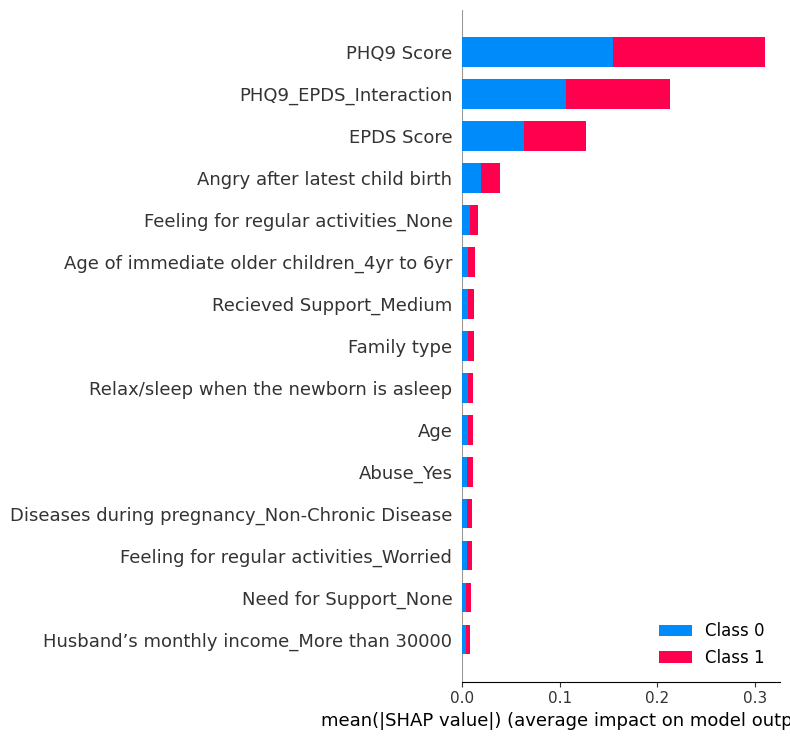

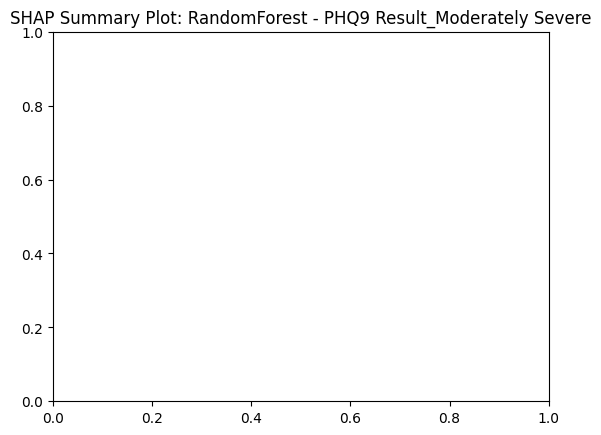

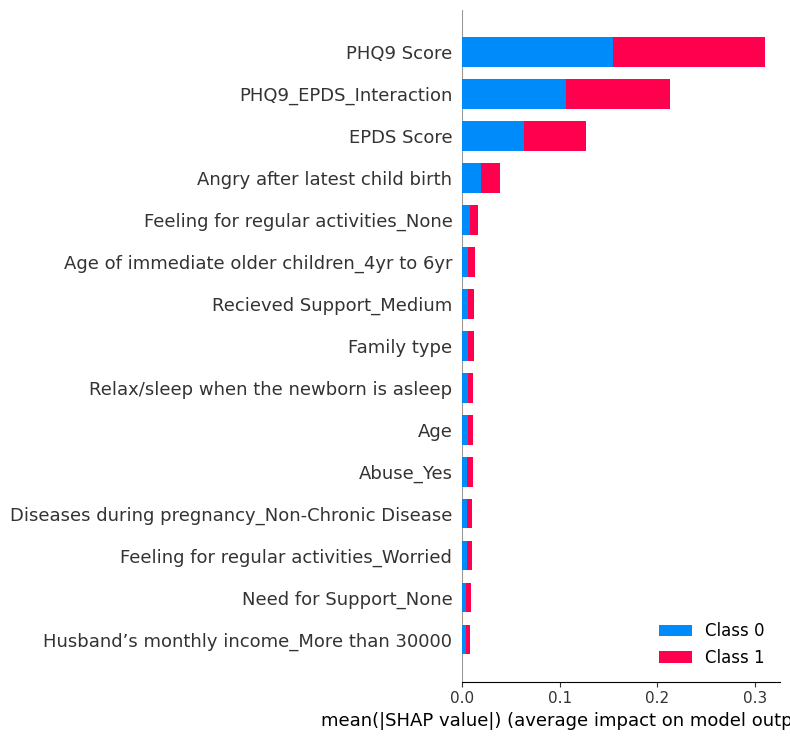

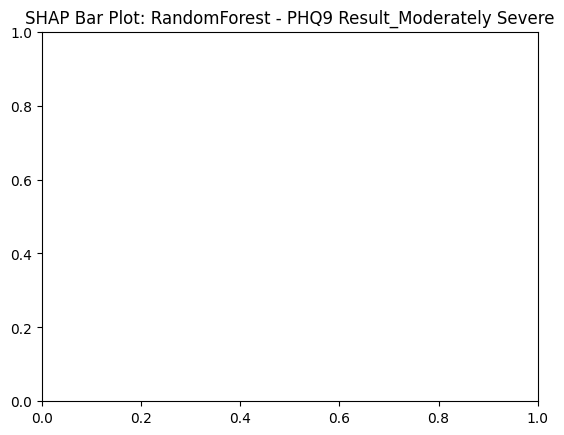

❌ Error explaining RandomForest on PHQ9 Result_Moderately Severe: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: PHQ9 Result_Moderately Severe
❌ Error explaining SVM on PHQ9 Result_Moderately Severe: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Moderately Severe
❌ Error explaining XGBoost on PHQ9 Result_Moderately Severe: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Moderately Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


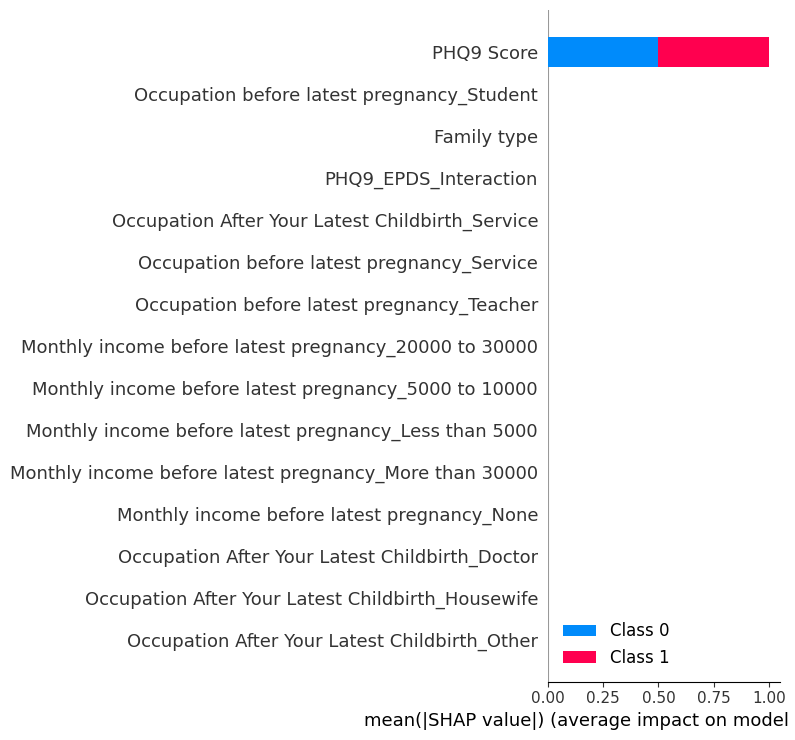

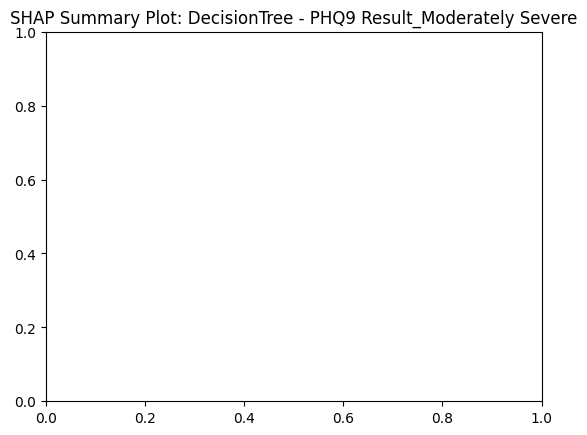

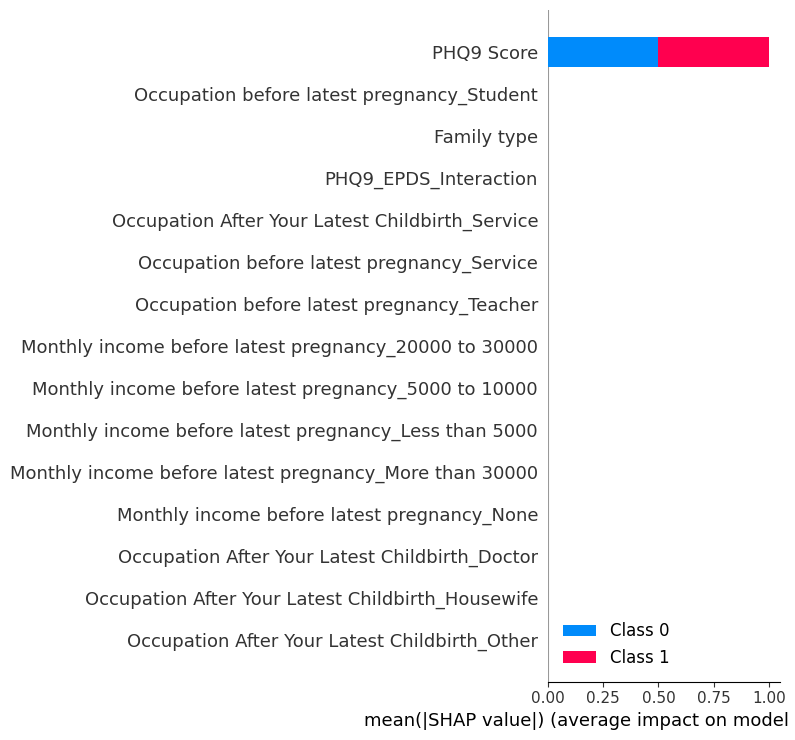

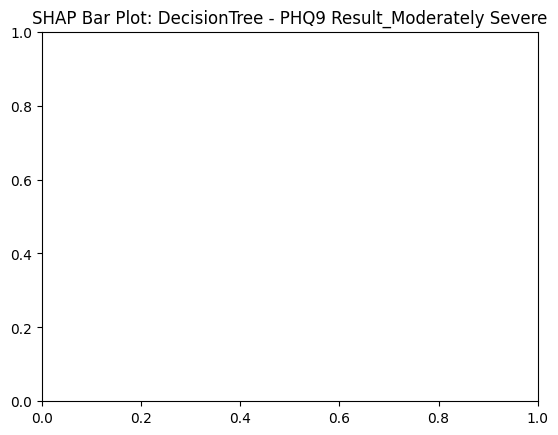

❌ Error explaining DecisionTree on PHQ9 Result_Moderately Severe: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: PHQ9 Result_Moderately Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


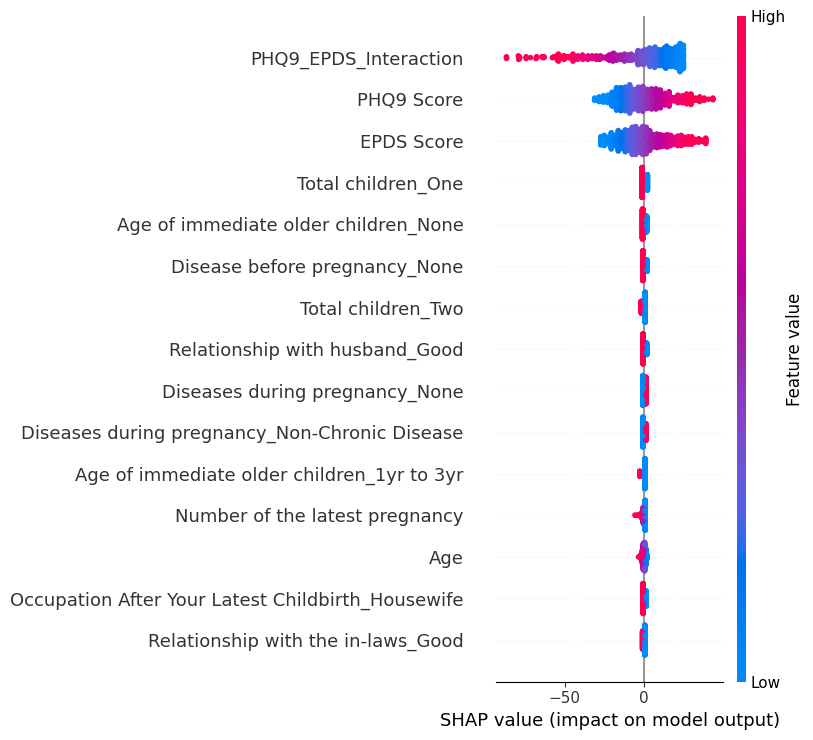

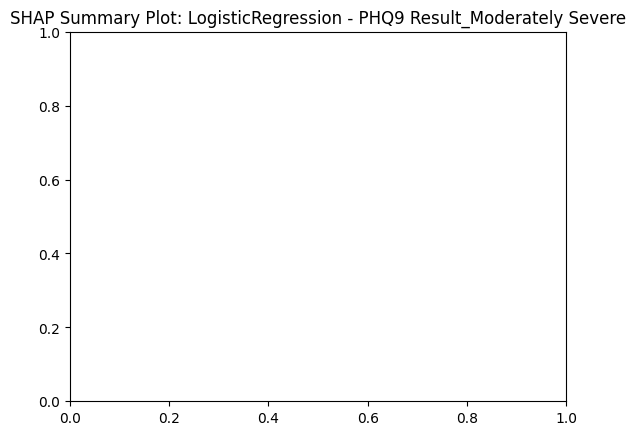

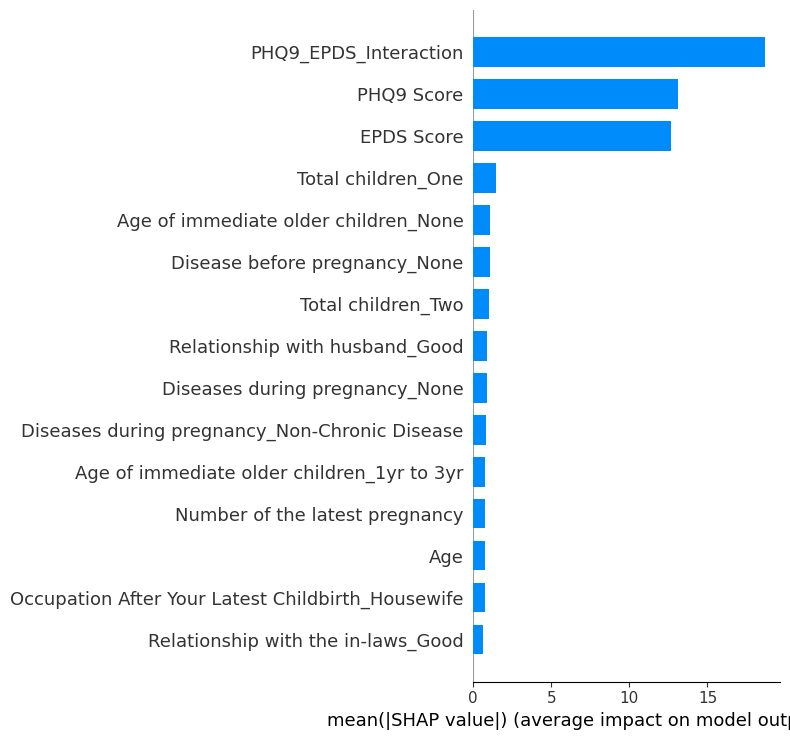

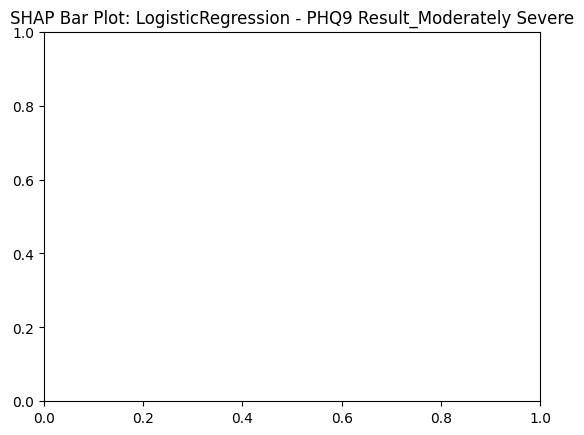

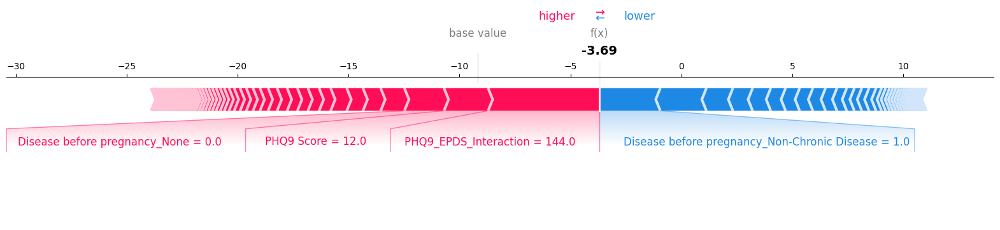

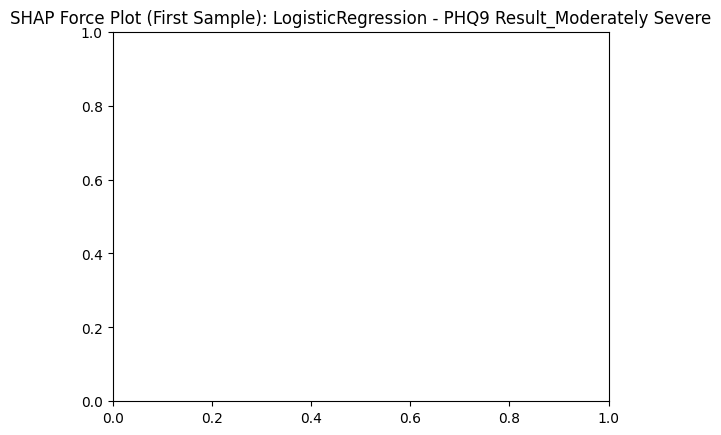


Explaining model: GradientBoosting on target: PHQ9 Result_Moderately Severe


PermutationExplainer explainer: 640it [00:24, 16.14it/s]                                                               


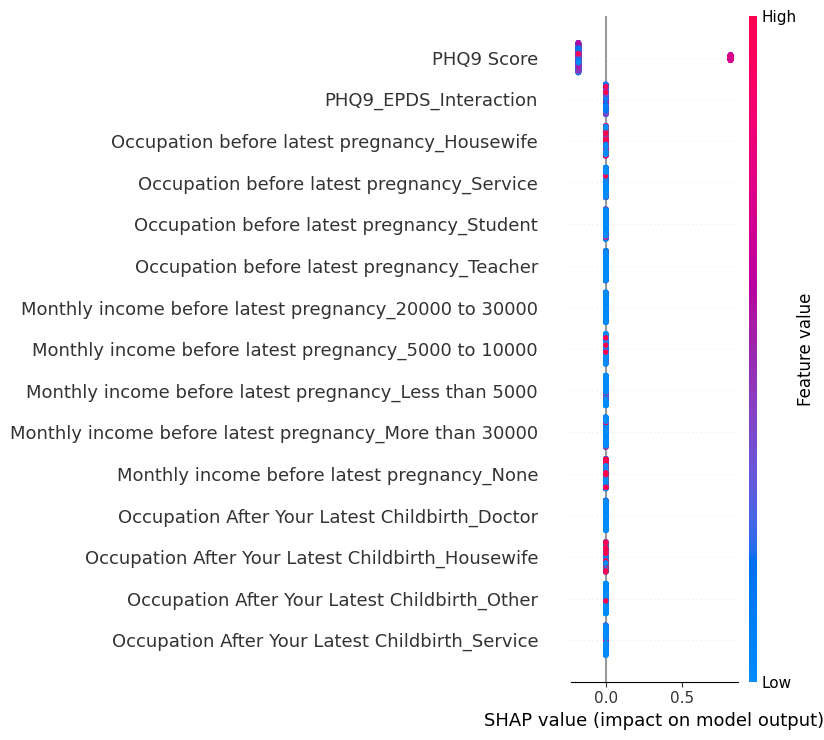

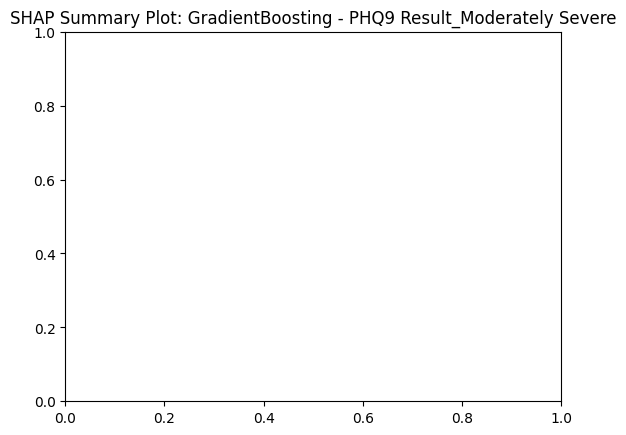

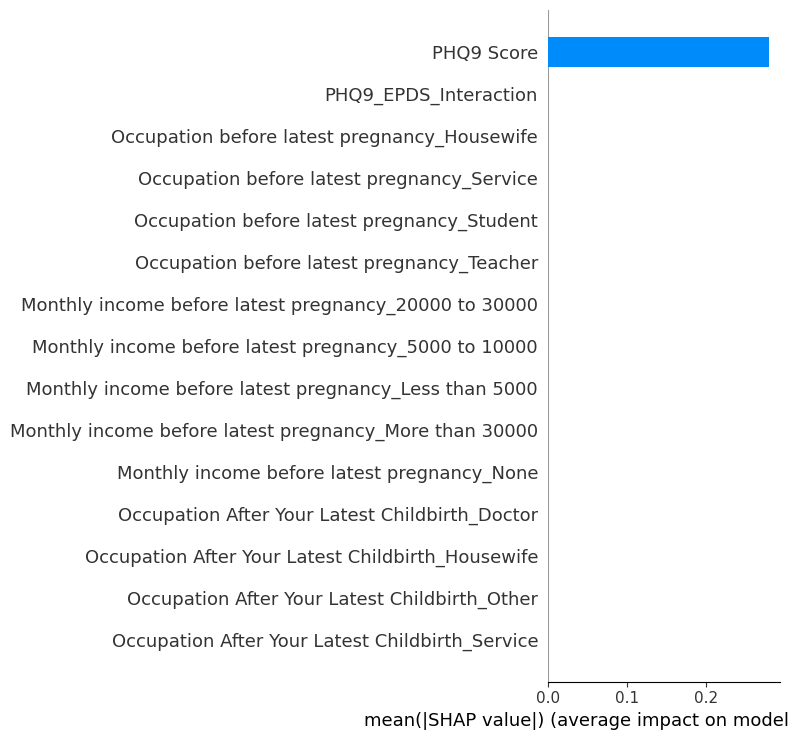

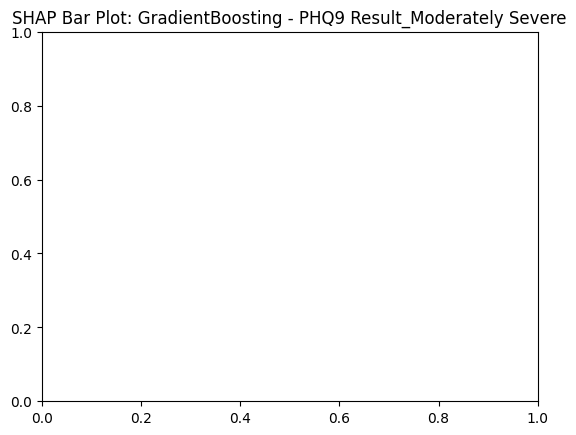

❌ Error explaining GradientBoosting on PHQ9 Result_Moderately Severe: 'PermutationExplainer' object has no attribute 'expected_value'

Explaining model: RandomForest on target: PHQ9 Result_Normal


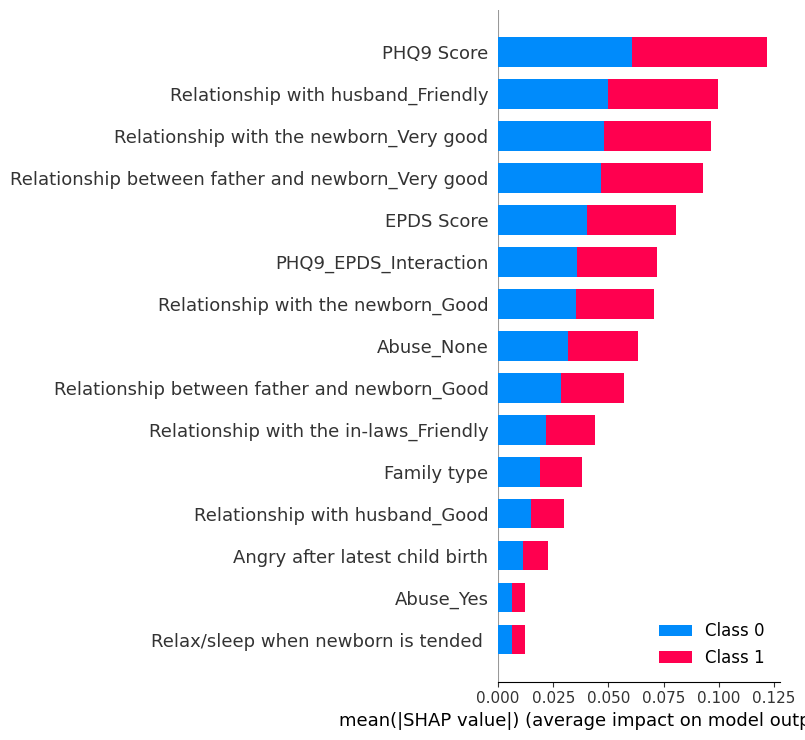

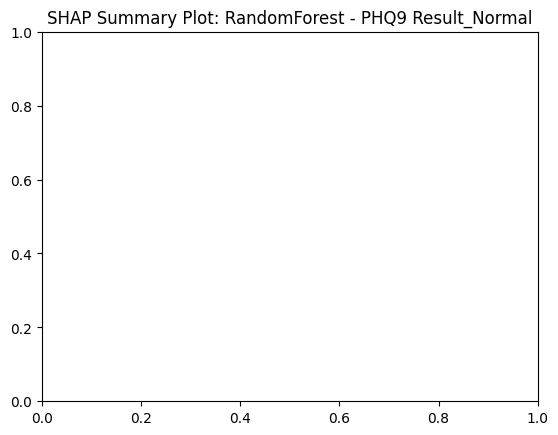

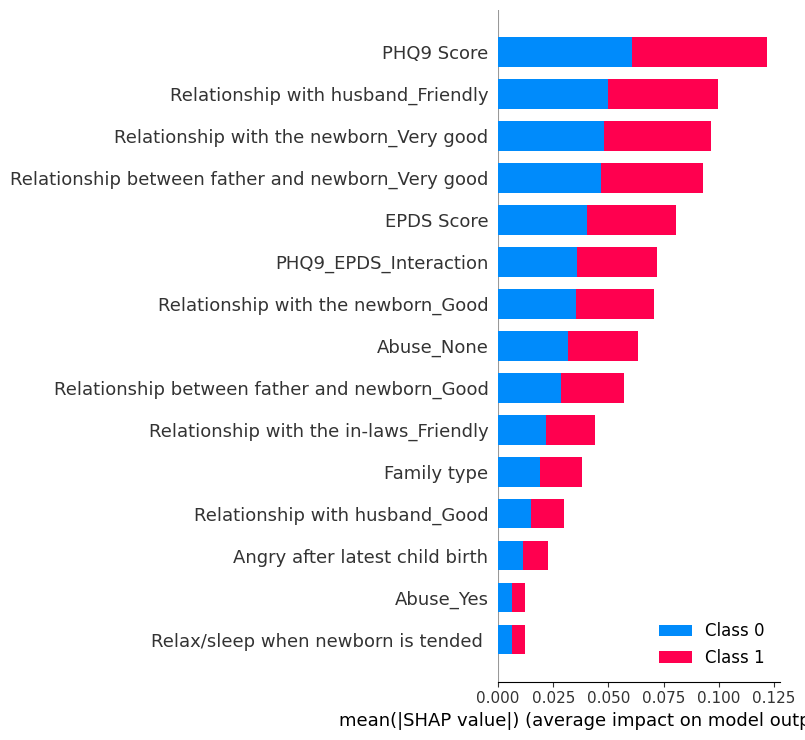

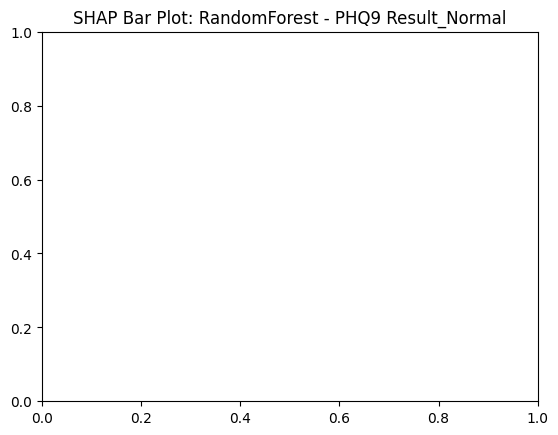

❌ Error explaining RandomForest on PHQ9 Result_Normal: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: PHQ9 Result_Normal
❌ Error explaining SVM on PHQ9 Result_Normal: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Normal
❌ Error explaining XGBoost on PHQ9 Result_Normal: 'utf-8' codec can't decode byte 0xbf in position 6795: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Normal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


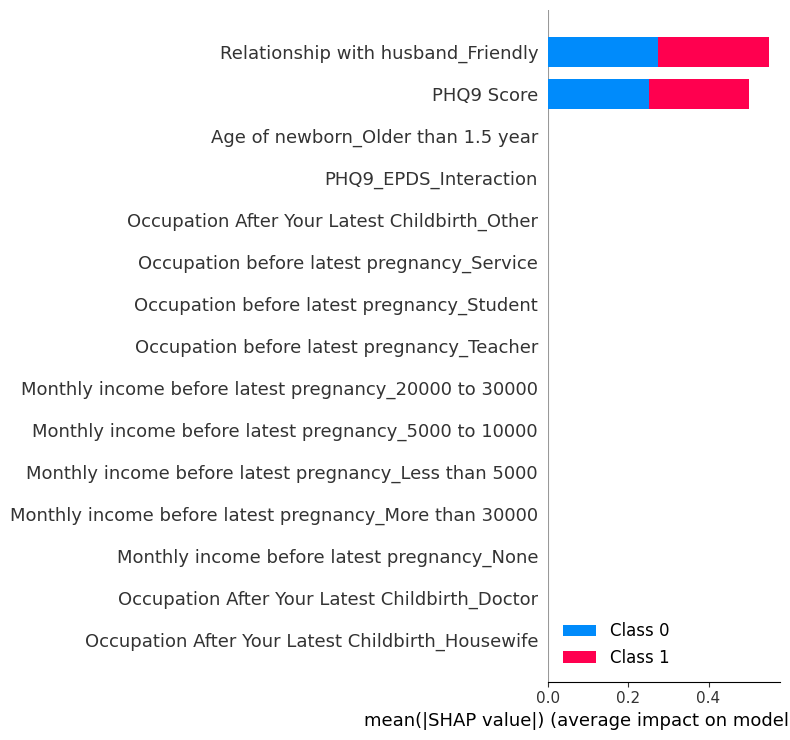

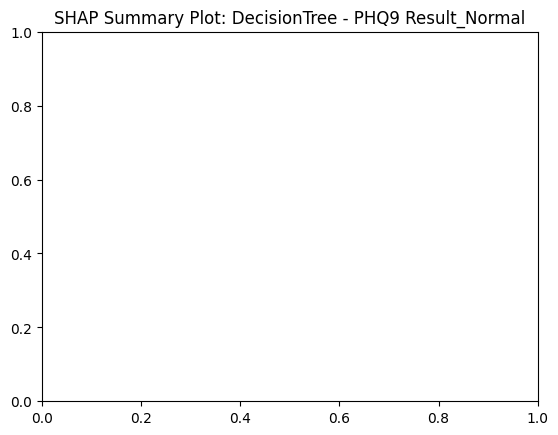

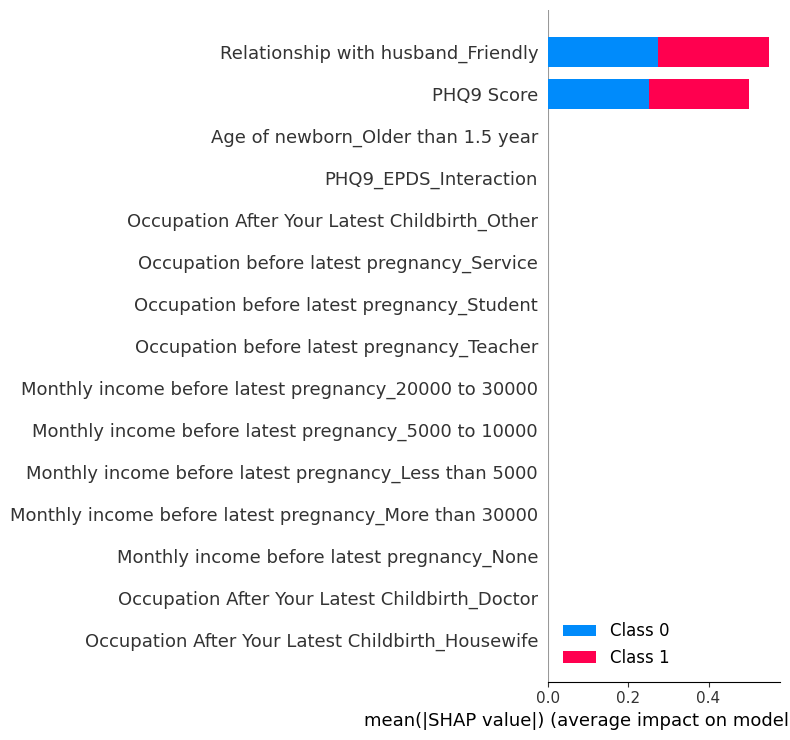

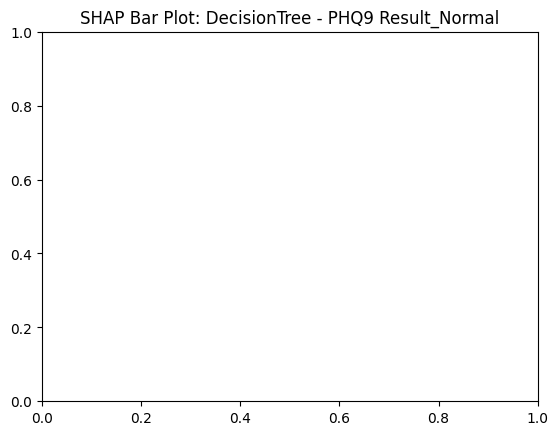

❌ Error explaining DecisionTree on PHQ9 Result_Normal: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: PHQ9 Result_Normal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


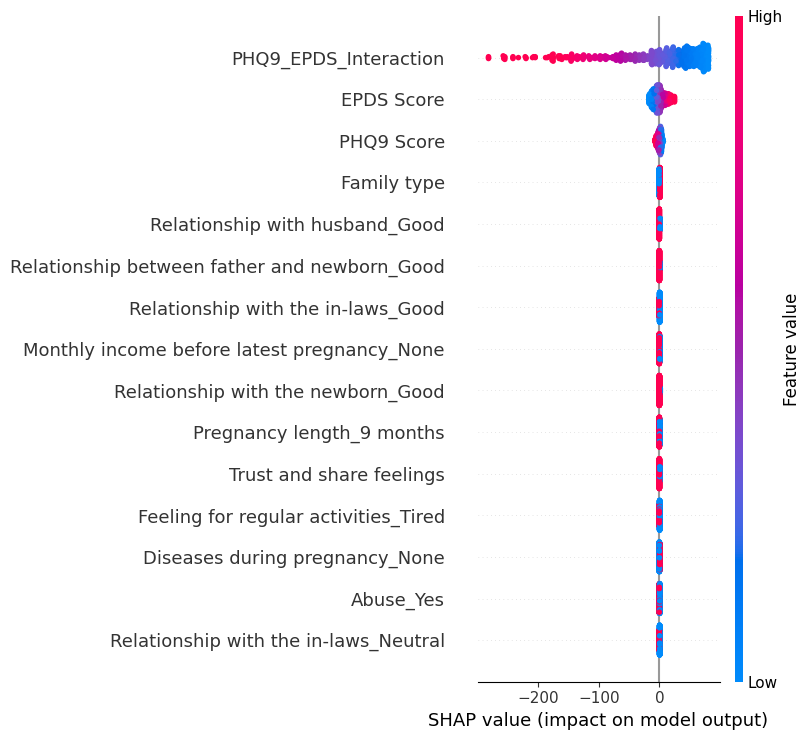

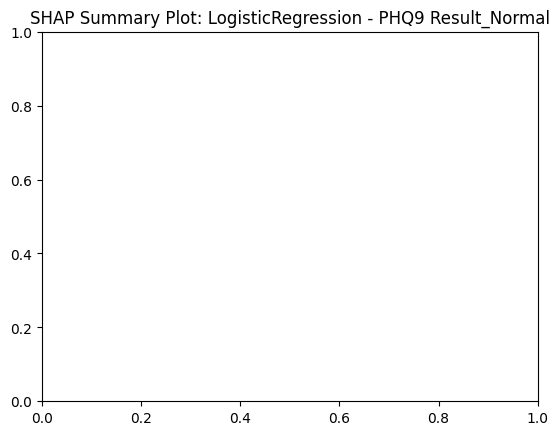

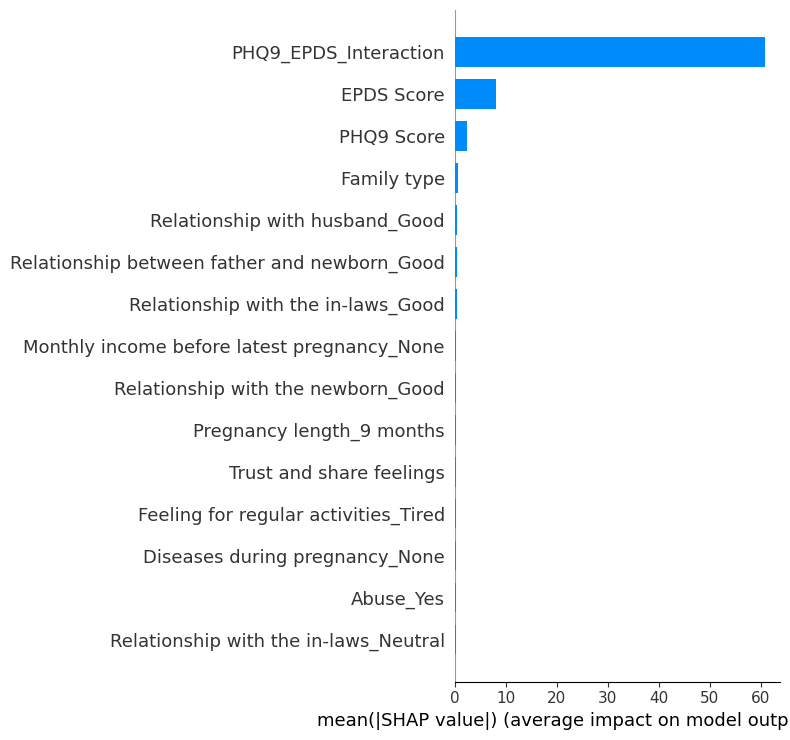

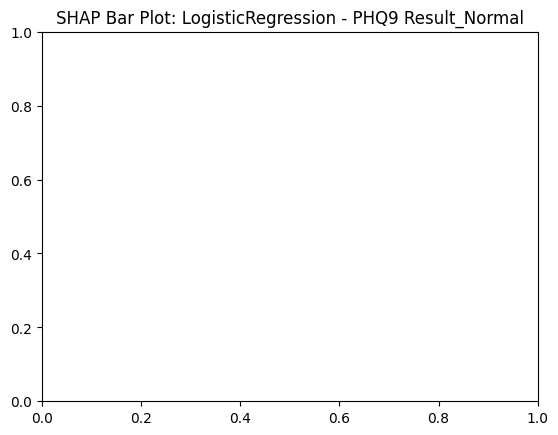

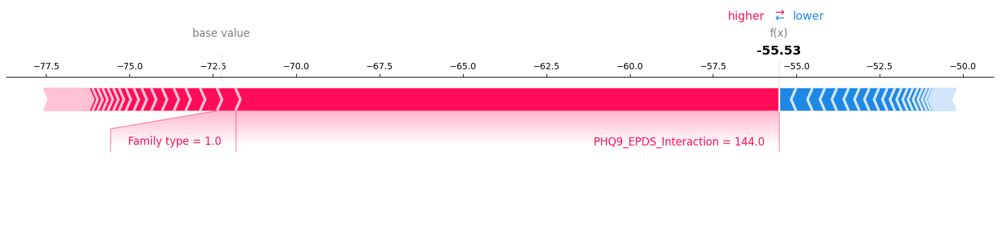

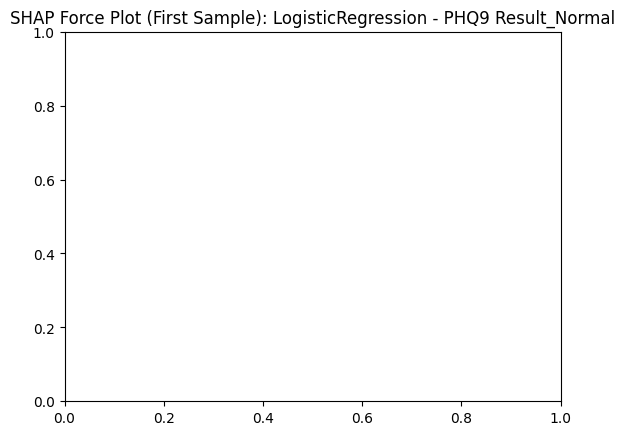


Explaining model: GradientBoosting on target: PHQ9 Result_Normal


PermutationExplainer explainer: 640it [00:23, 15.74it/s]                                                               


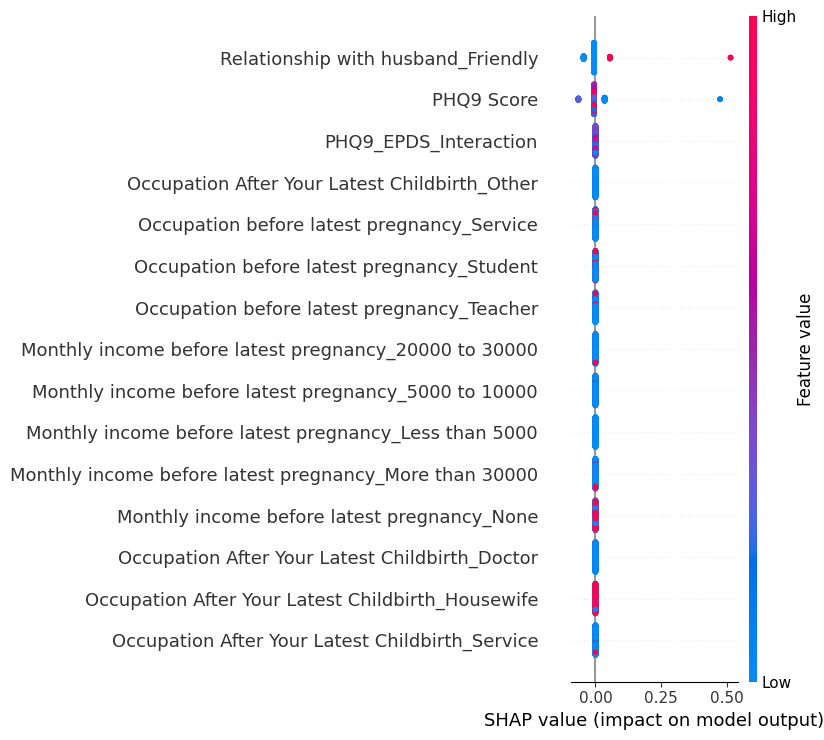

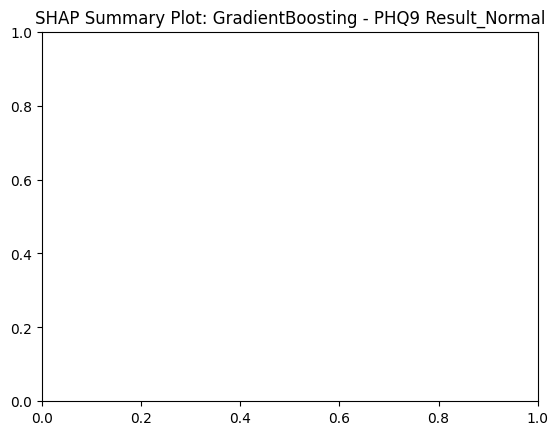

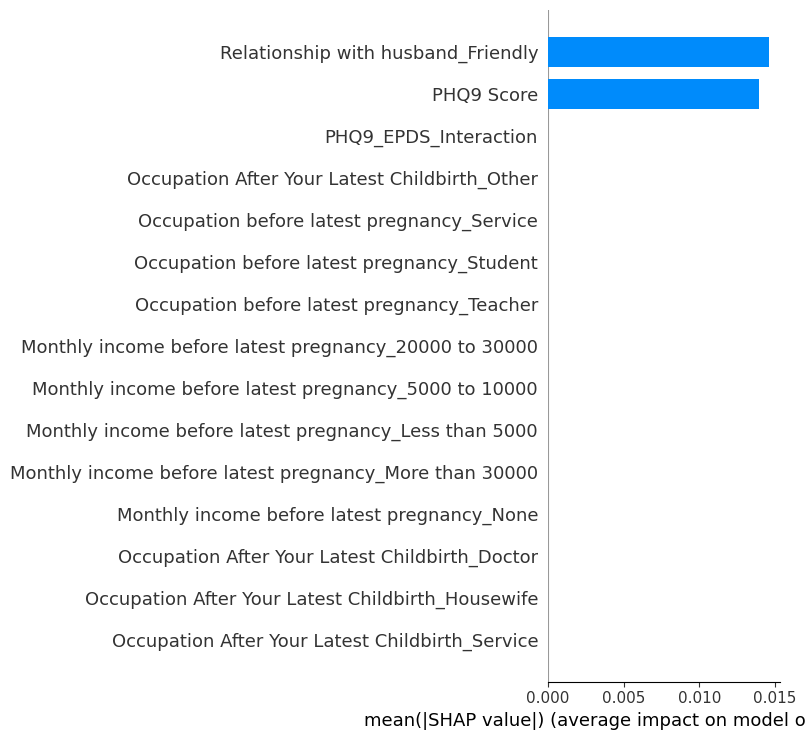

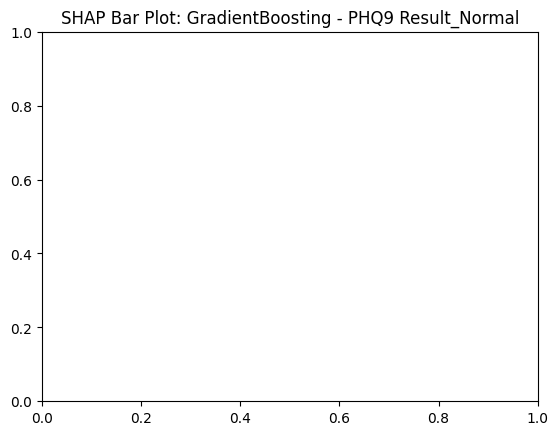

❌ Error explaining GradientBoosting on PHQ9 Result_Normal: 'PermutationExplainer' object has no attribute 'expected_value'

Explaining model: RandomForest on target: PHQ9 Result_Severe


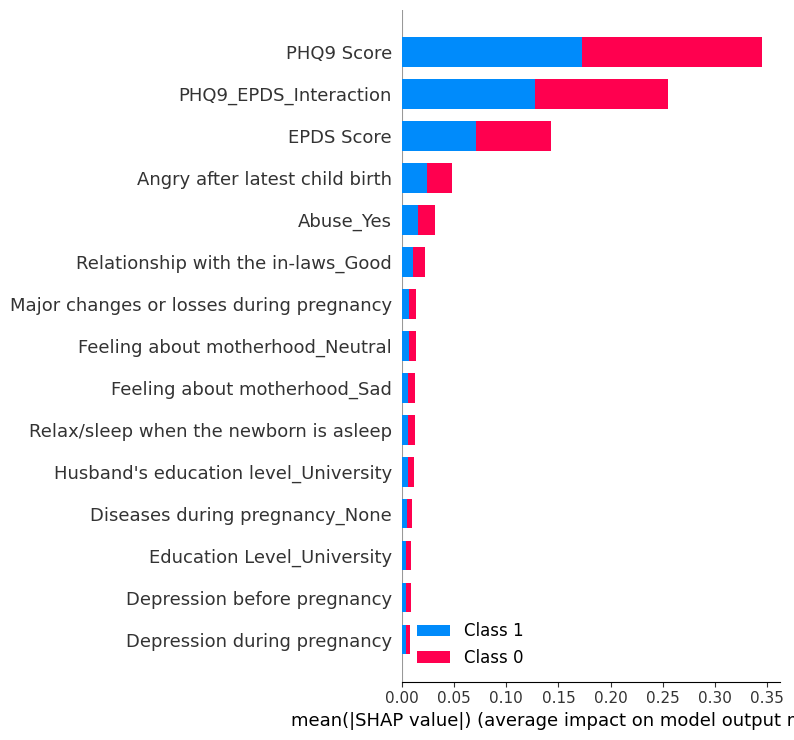

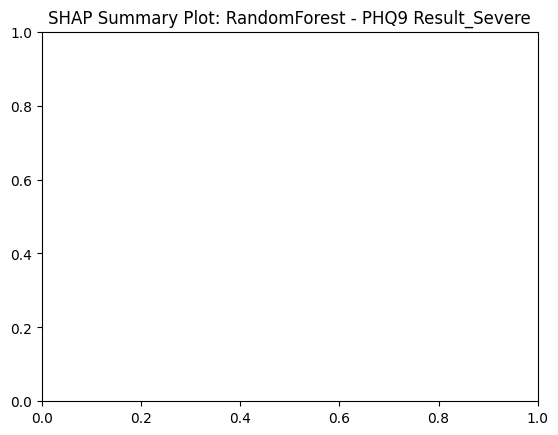

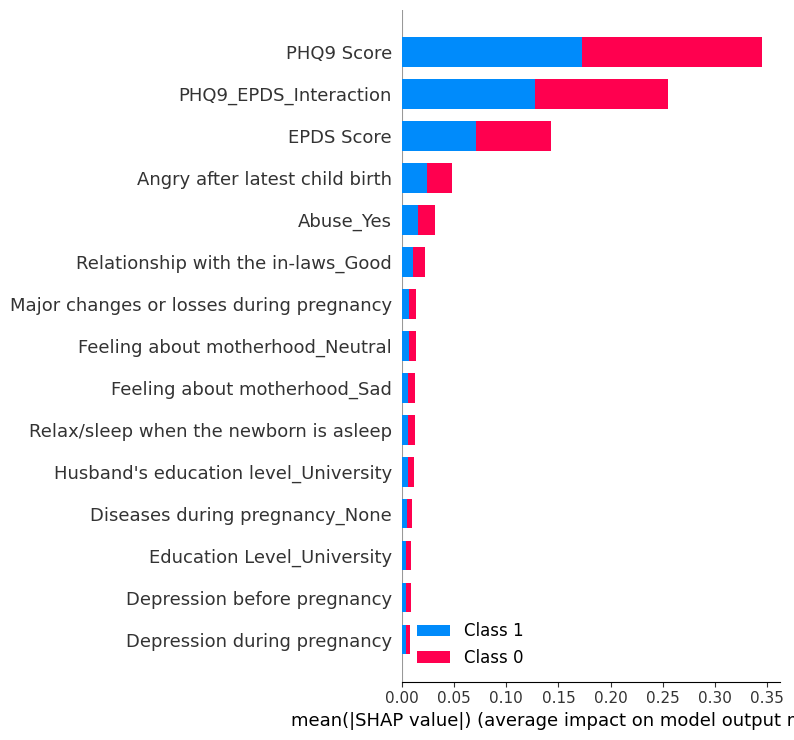

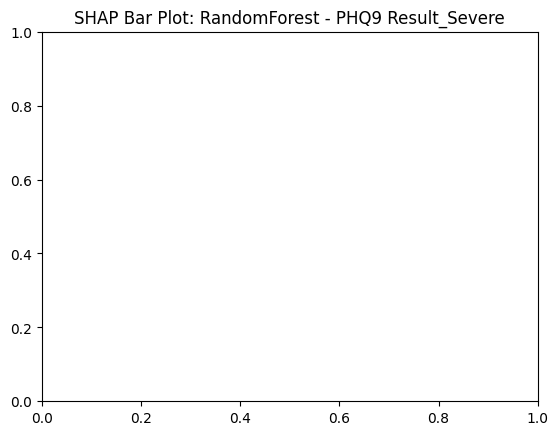

❌ Error explaining RandomForest on PHQ9 Result_Severe: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: PHQ9 Result_Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


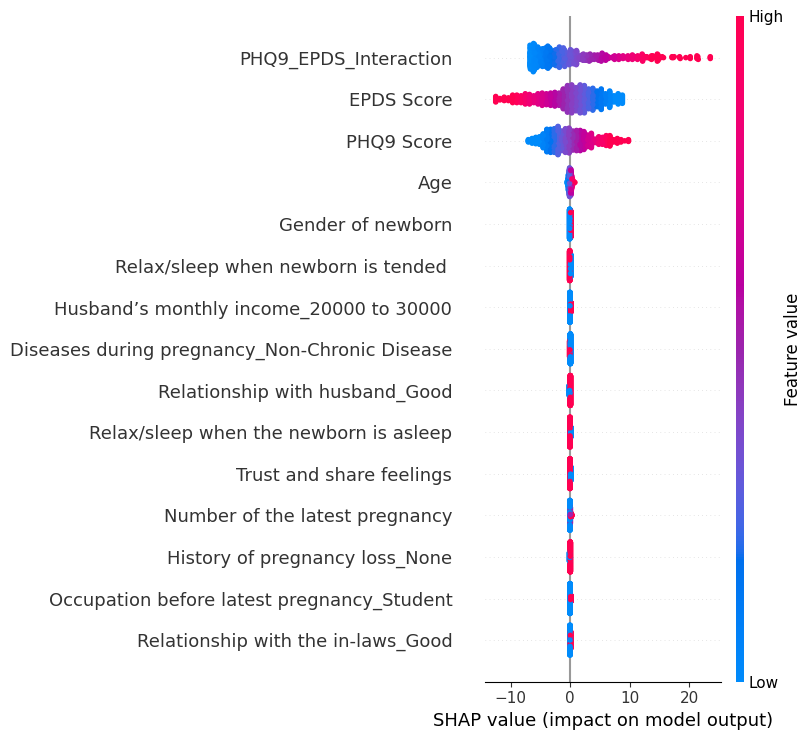

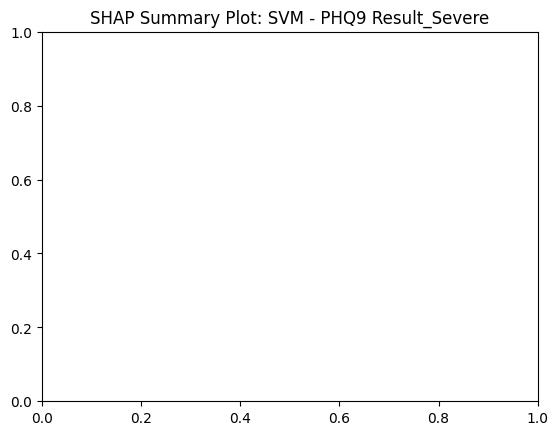

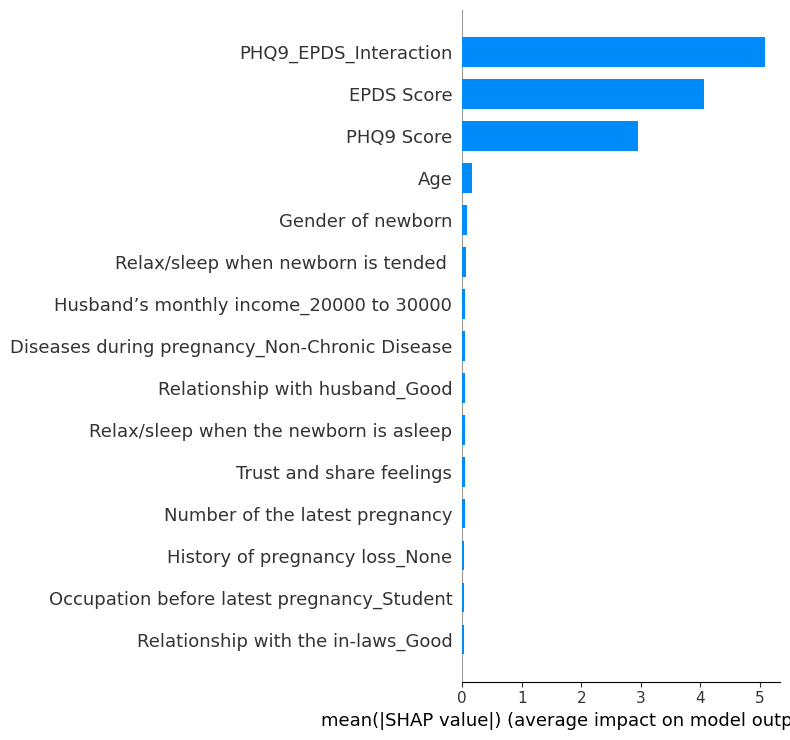

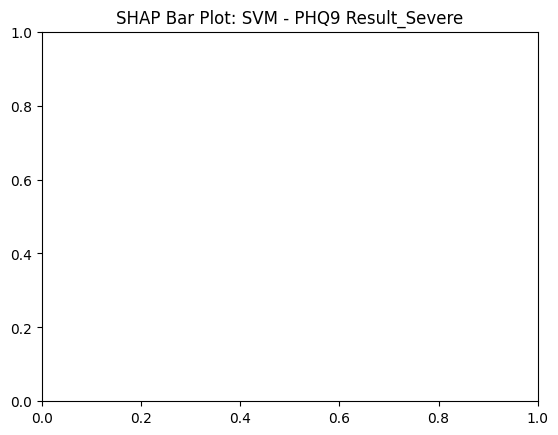

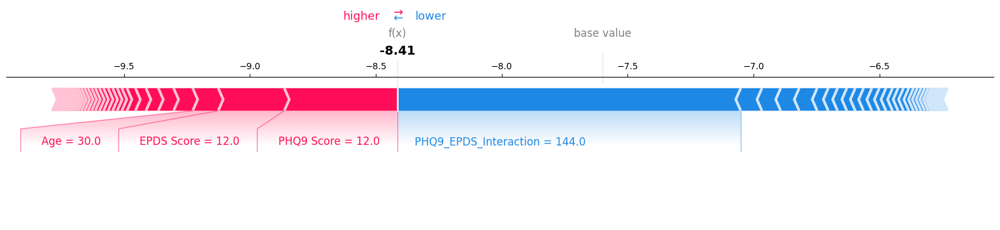

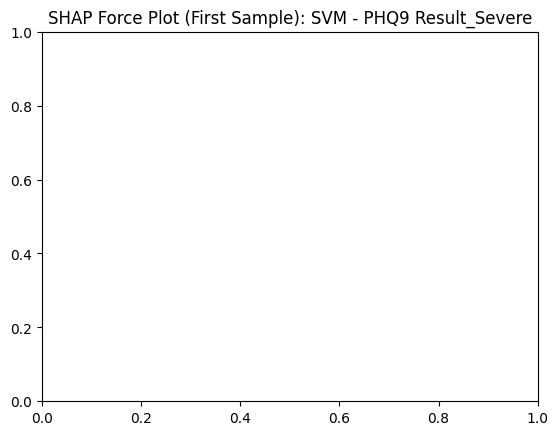


Explaining model: XGBoost on target: PHQ9 Result_Severe
❌ Error explaining XGBoost on PHQ9 Result_Severe: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Severe


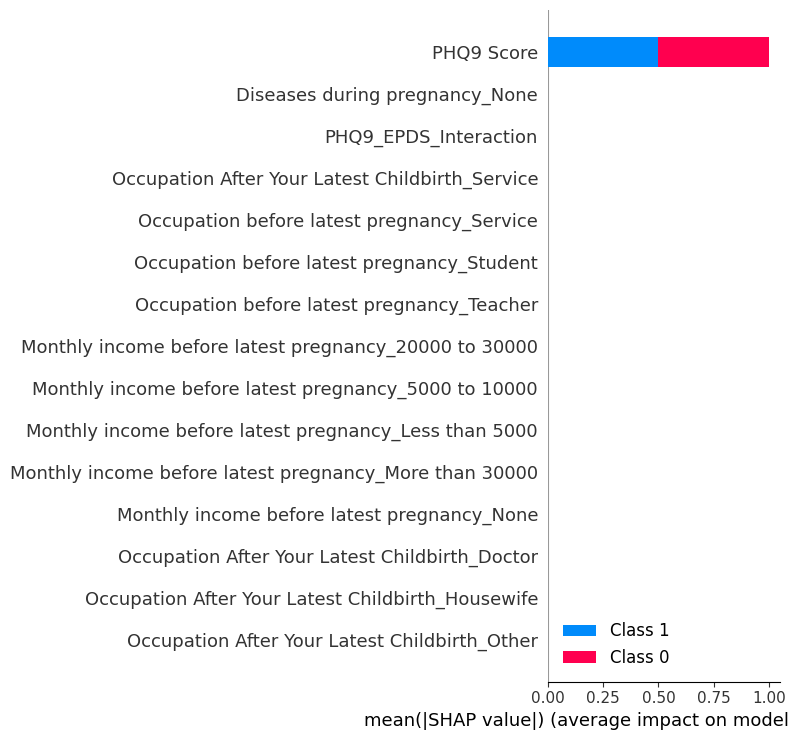

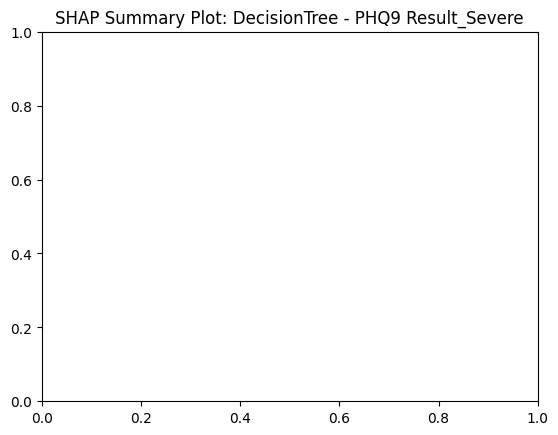

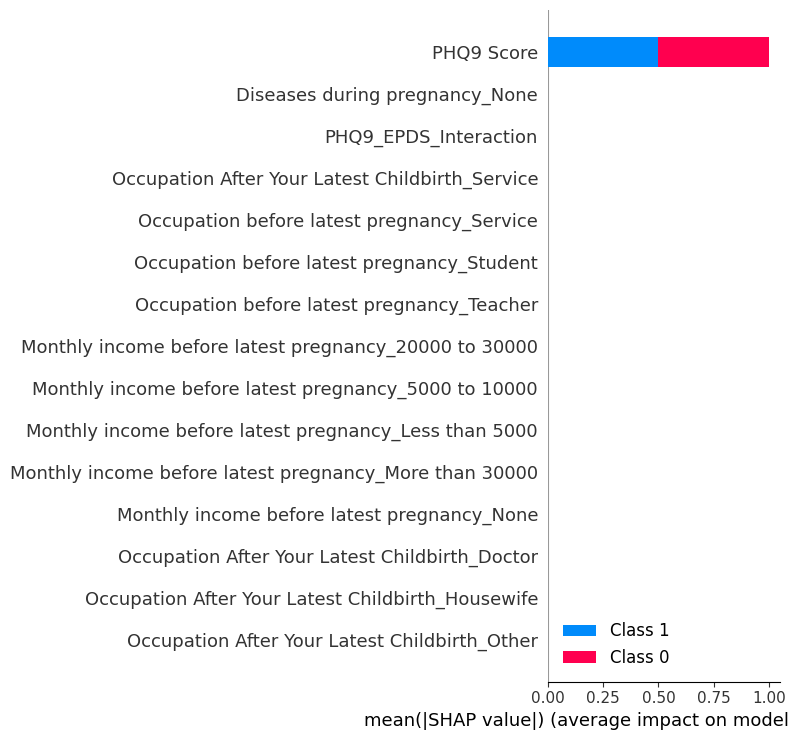

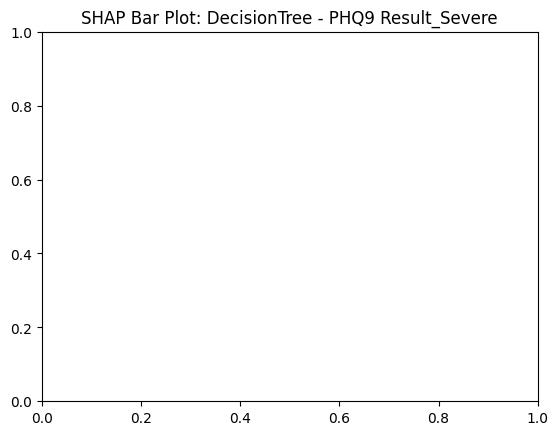

❌ Error explaining DecisionTree on PHQ9 Result_Severe: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: PHQ9 Result_Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


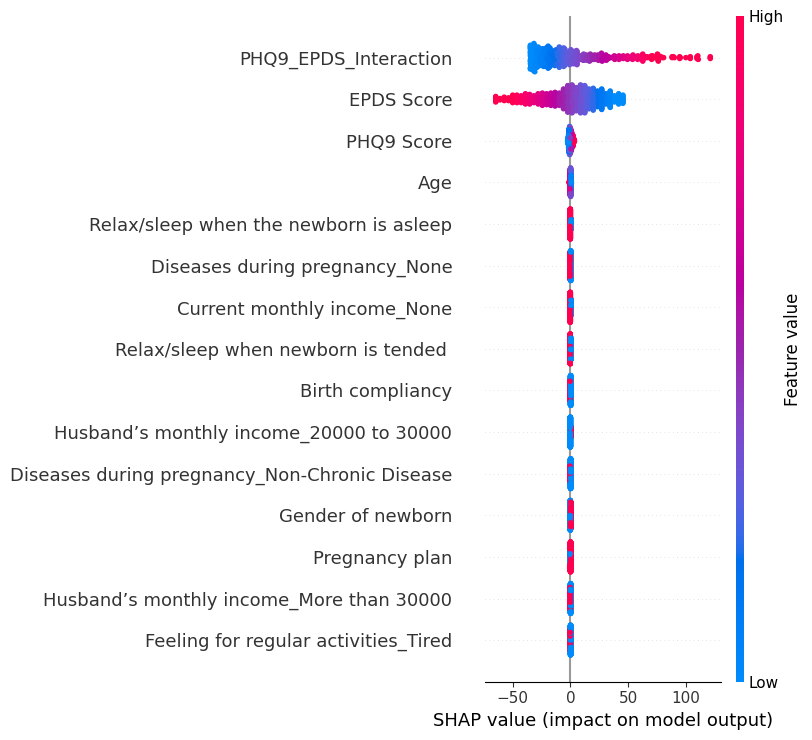

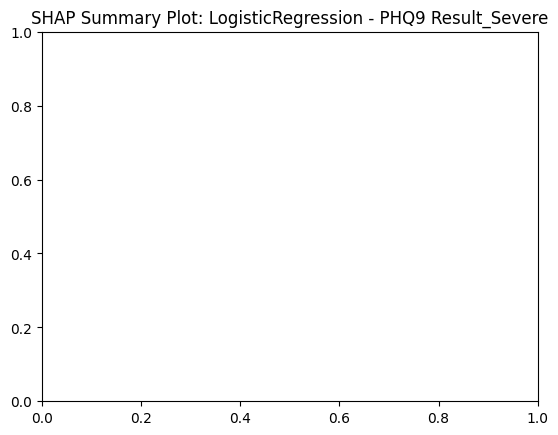

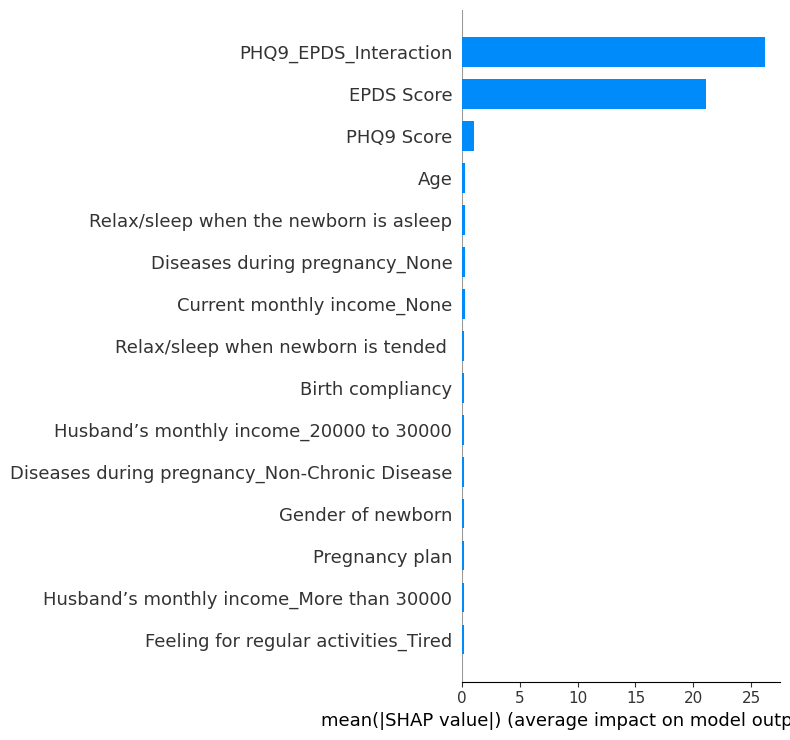

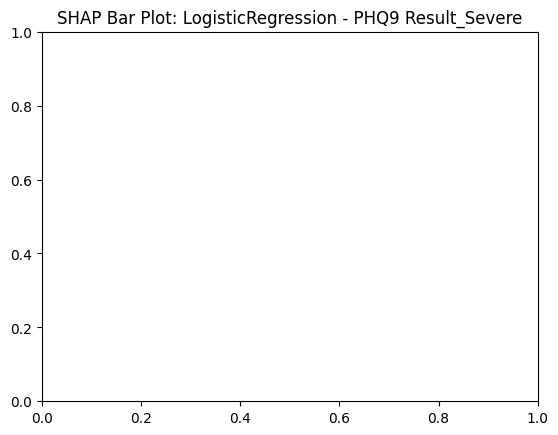

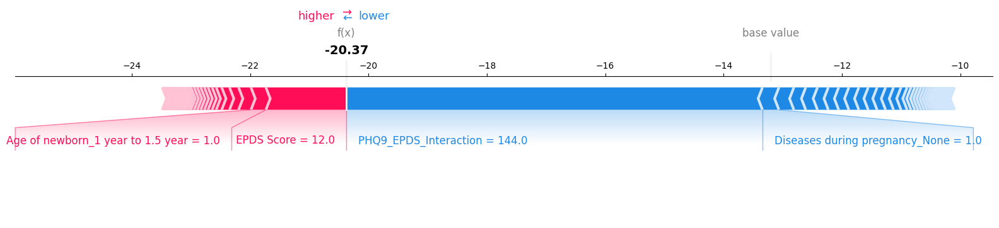

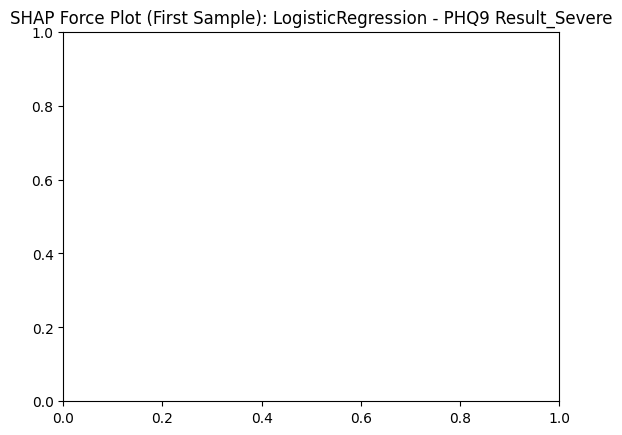


Explaining model: GradientBoosting on target: PHQ9 Result_Severe


PermutationExplainer explainer: 640it [00:23, 16.86it/s]                                                               


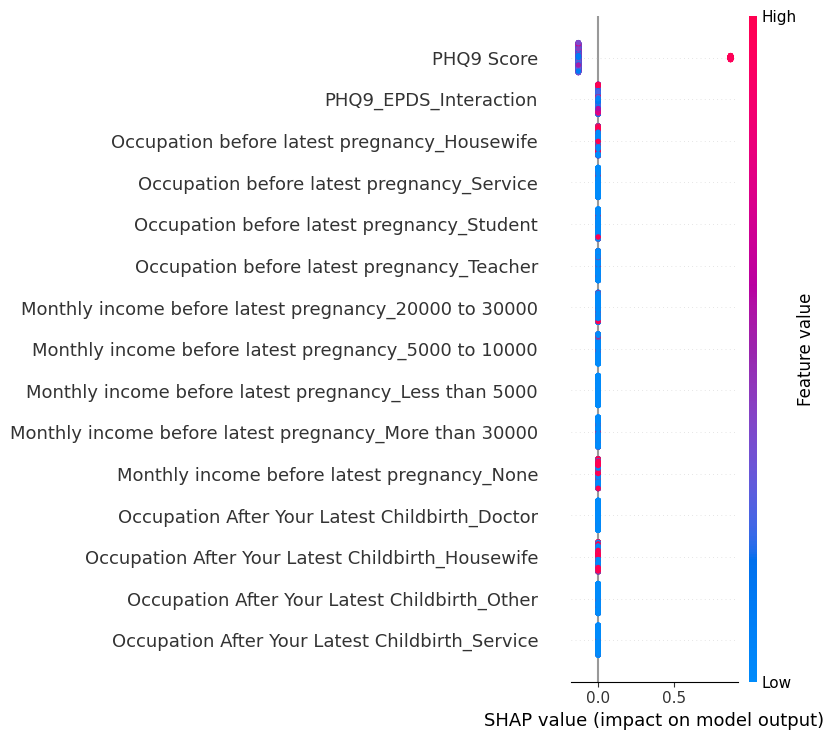

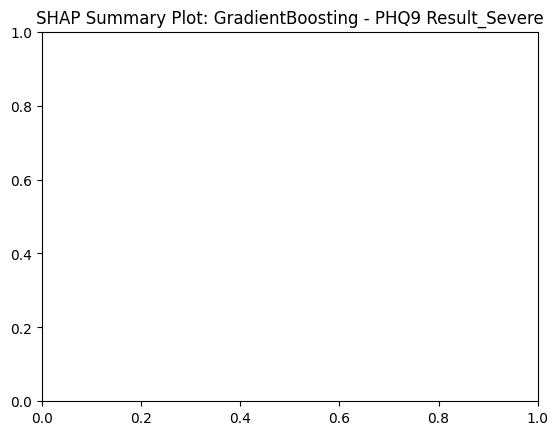

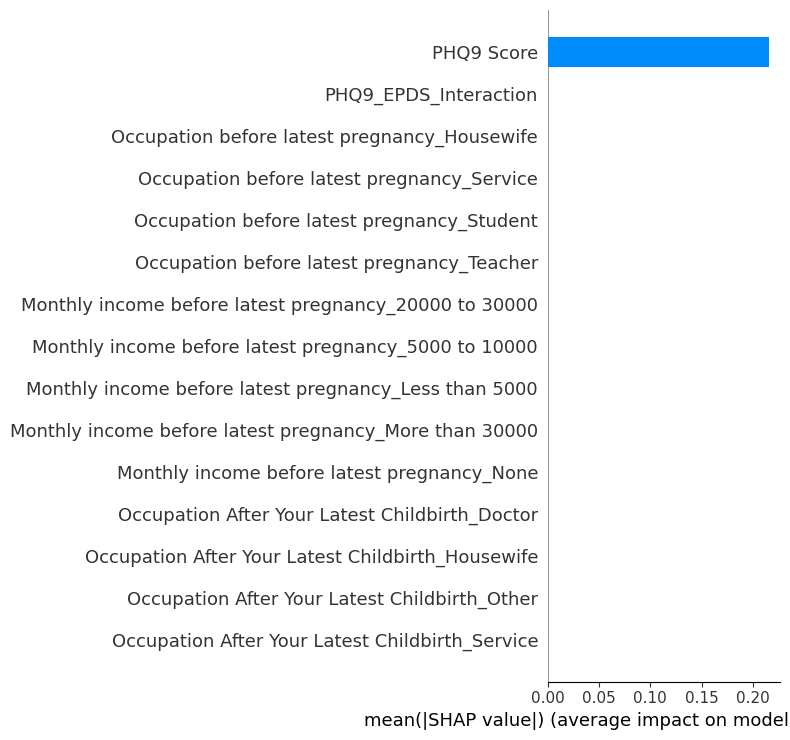

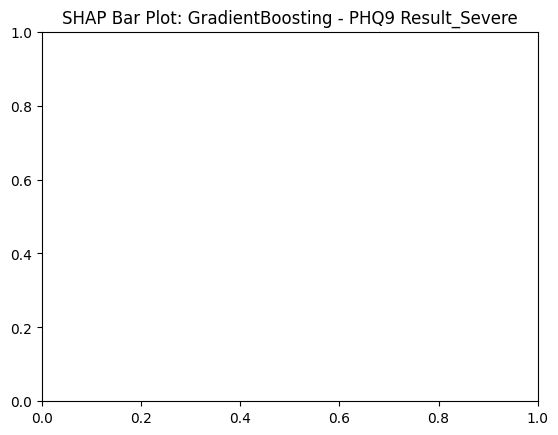

❌ Error explaining GradientBoosting on PHQ9 Result_Severe: 'PermutationExplainer' object has no attribute 'expected_value'

Explaining model: RandomForest on target: EPDS Result_low


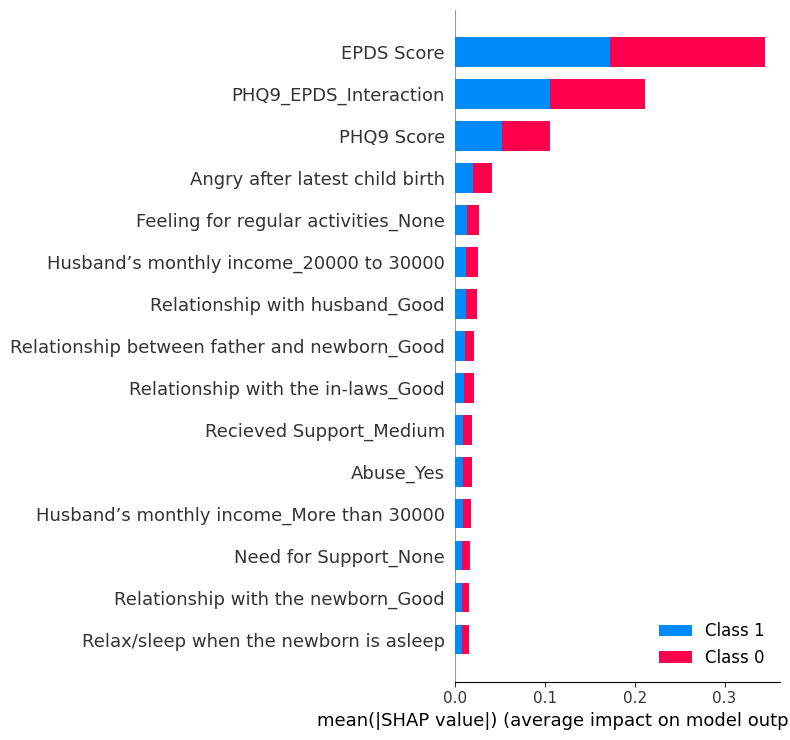

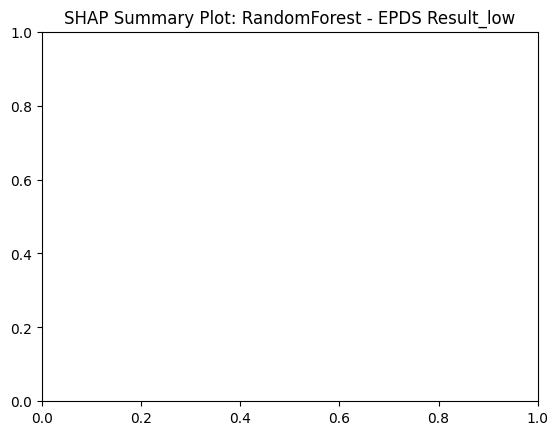

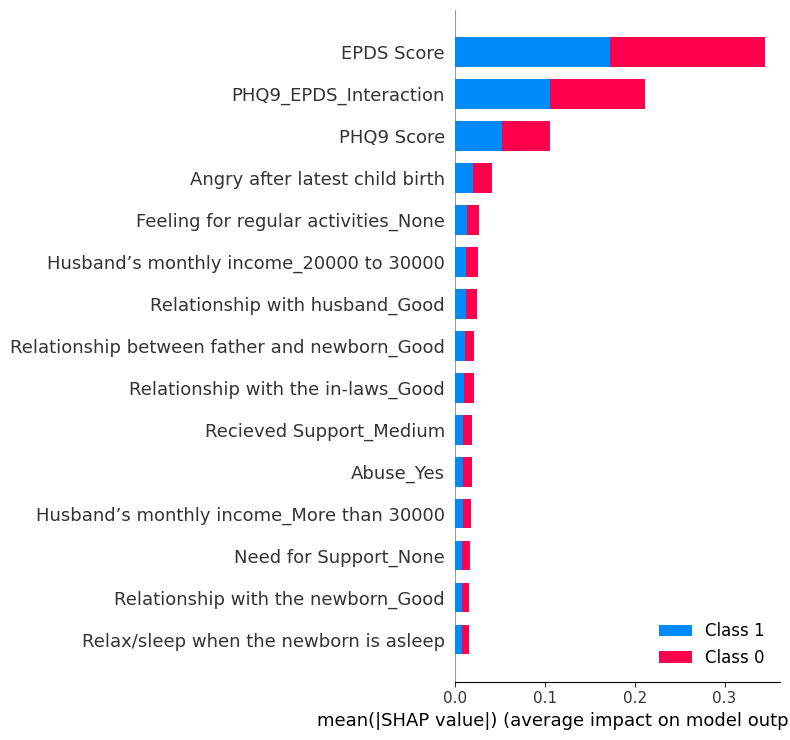

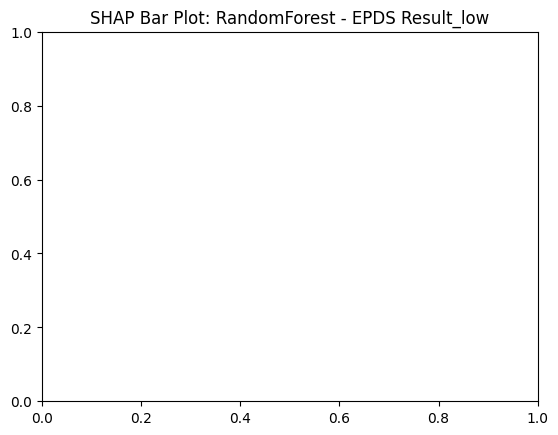

❌ Error explaining RandomForest on EPDS Result_low: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: EPDS Result_low
❌ Error explaining SVM on EPDS Result_low: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: EPDS Result_low
❌ Error explaining XGBoost on EPDS Result_low: 'utf-8' codec can't decode byte 0x84 in position 6303: invalid start byte

Explaining model: DecisionTree on target: EPDS Result_low


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


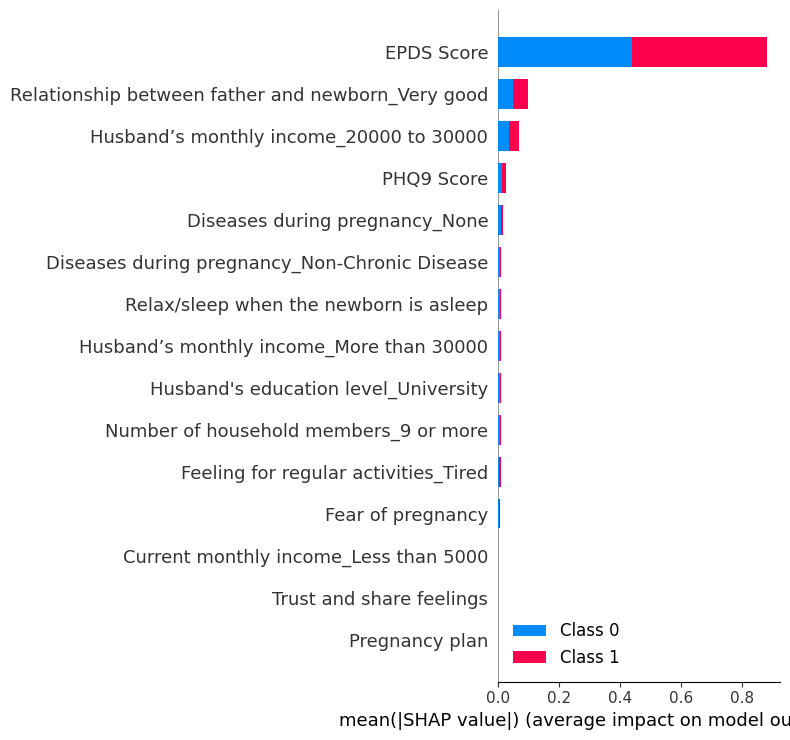

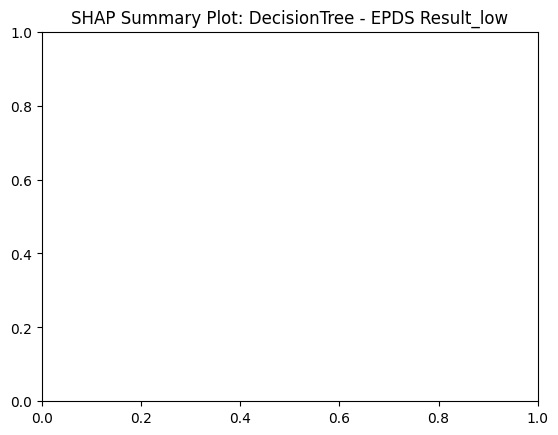

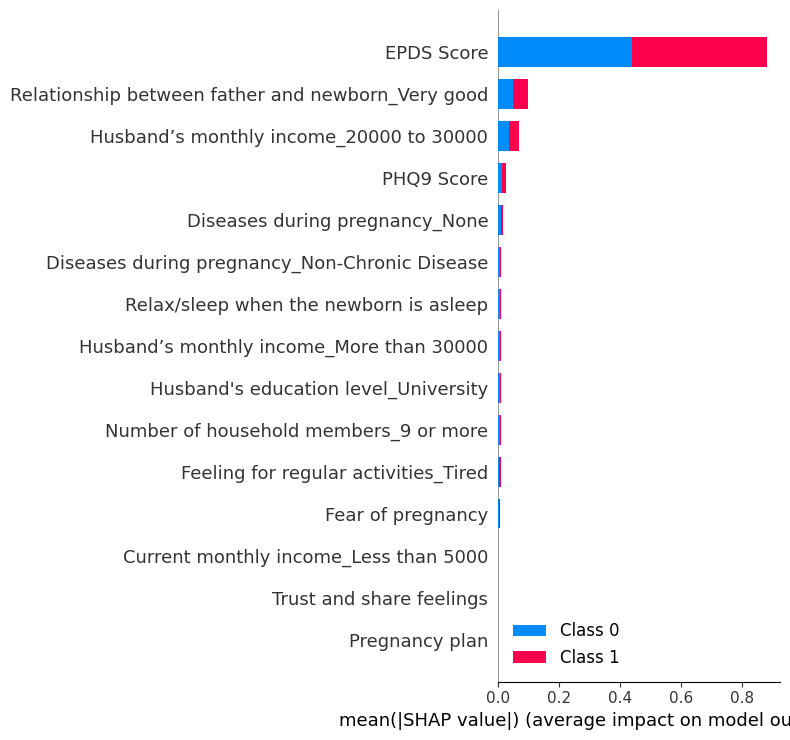

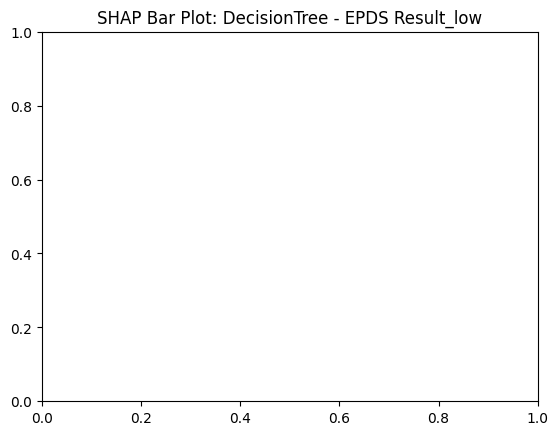

❌ Error explaining DecisionTree on EPDS Result_low: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: EPDS Result_low


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


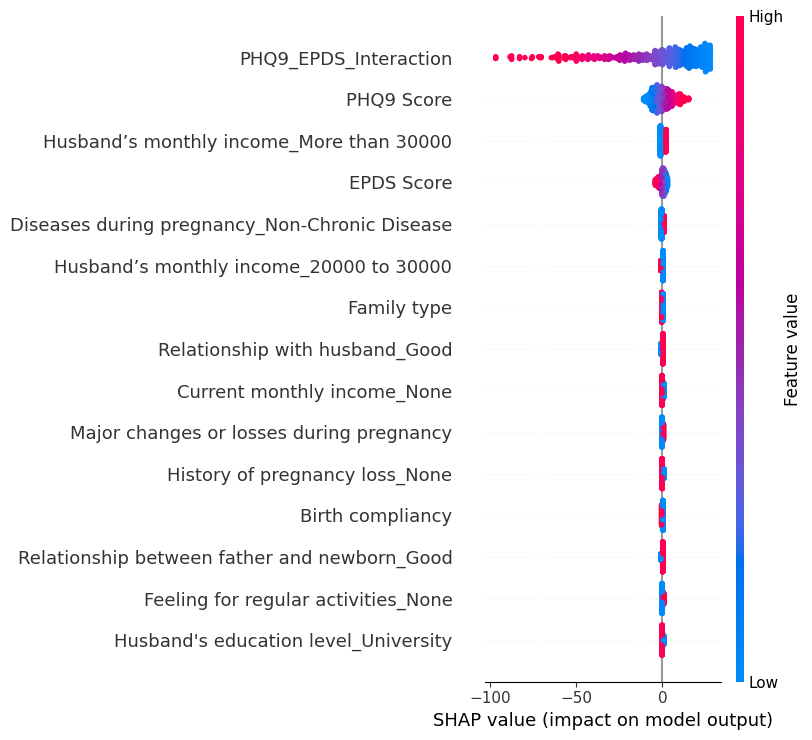

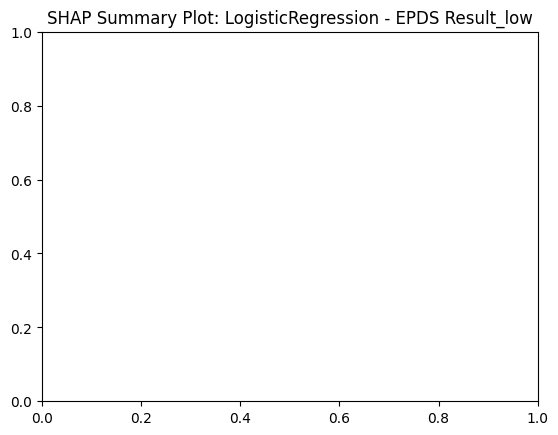

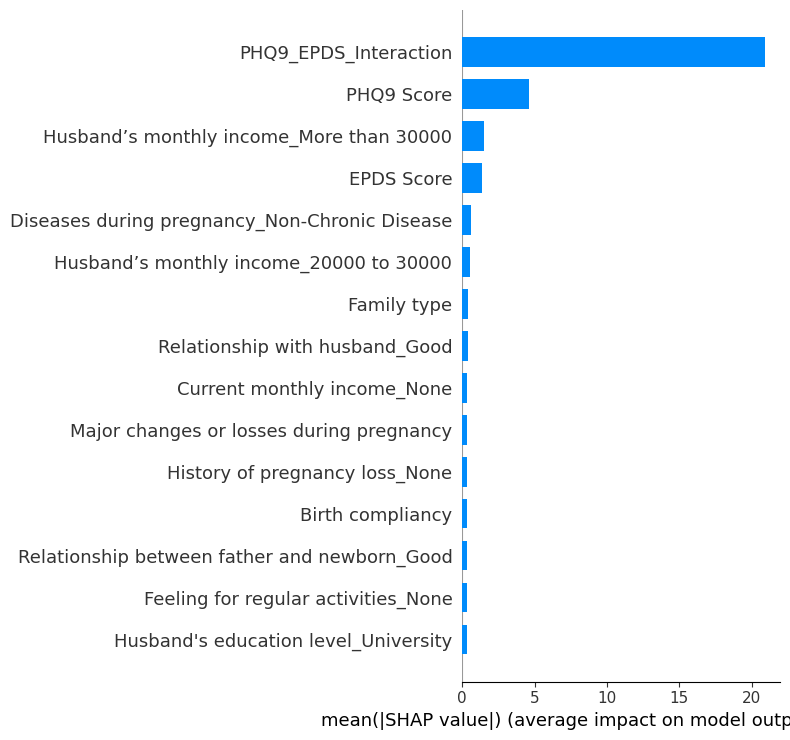

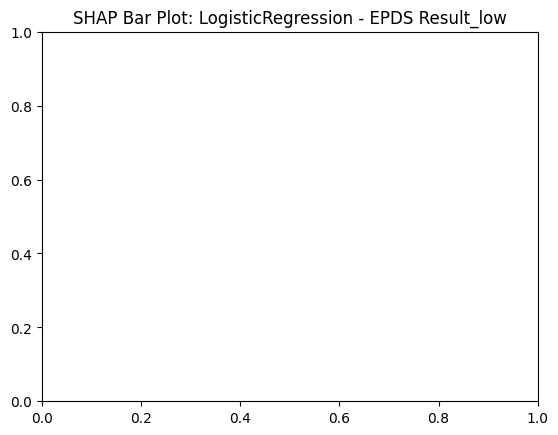

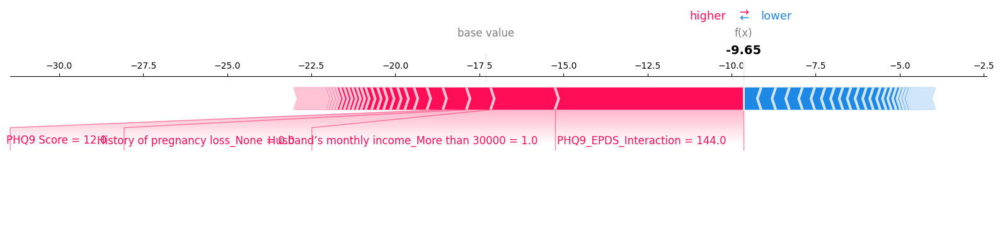

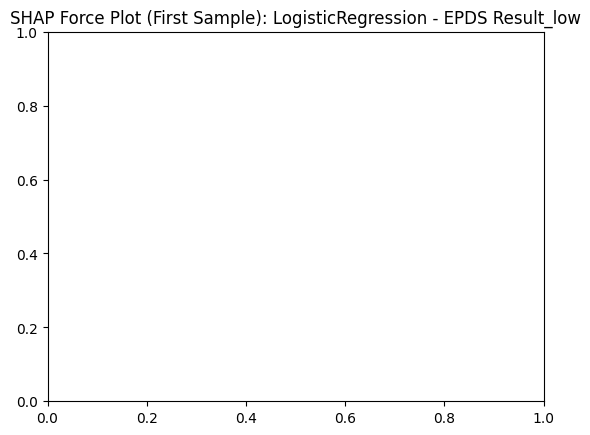


Explaining model: GradientBoosting on target: EPDS Result_low


PermutationExplainer explainer: 640it [00:33, 13.80it/s]                                                               


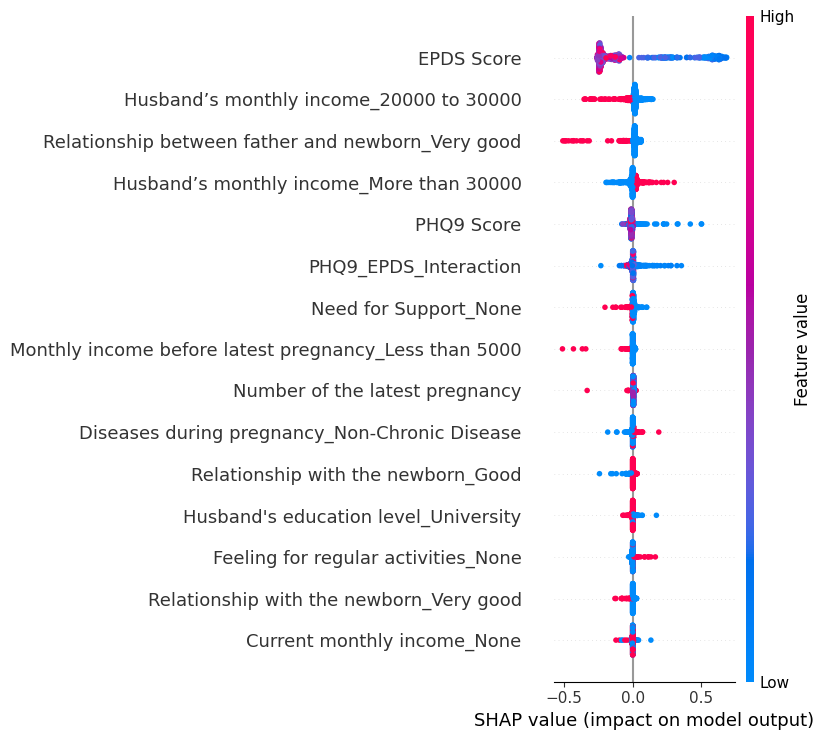

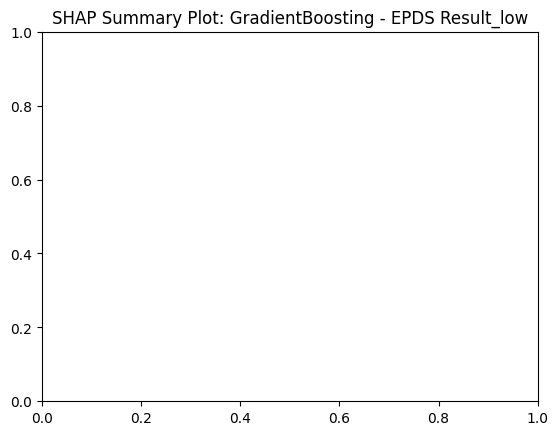

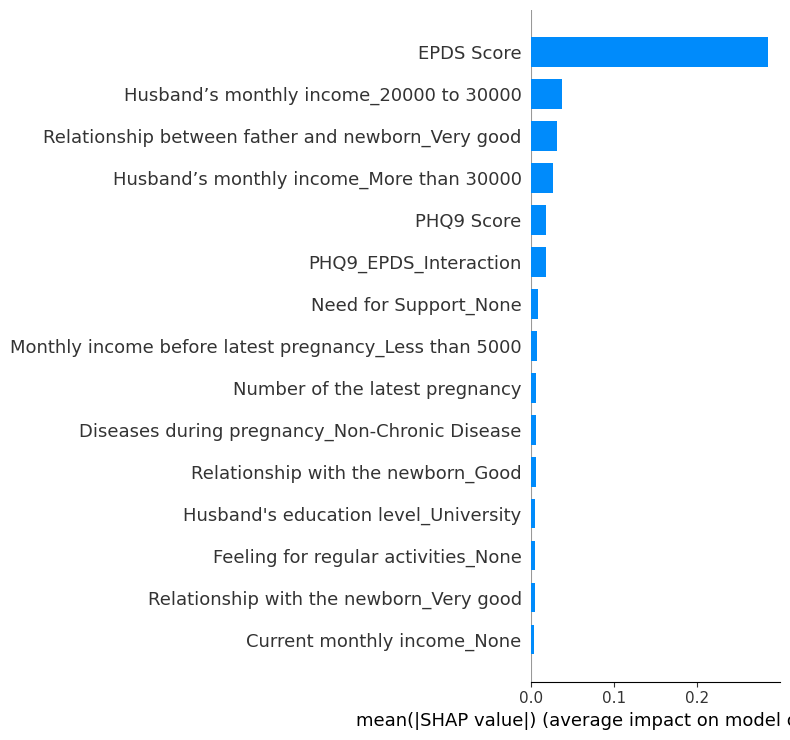

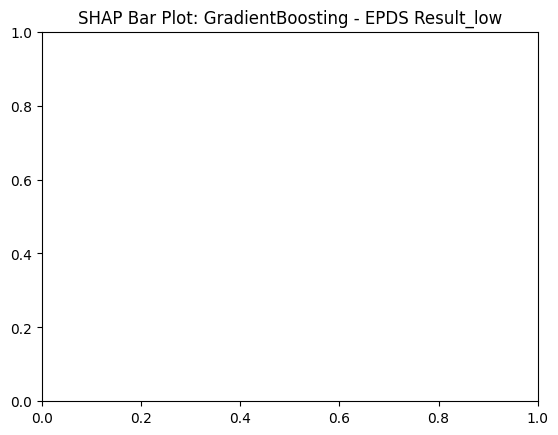

❌ Error explaining GradientBoosting on EPDS Result_low: 'PermutationExplainer' object has no attribute 'expected_value'

Explaining model: RandomForest on target: EPDS Result_medium


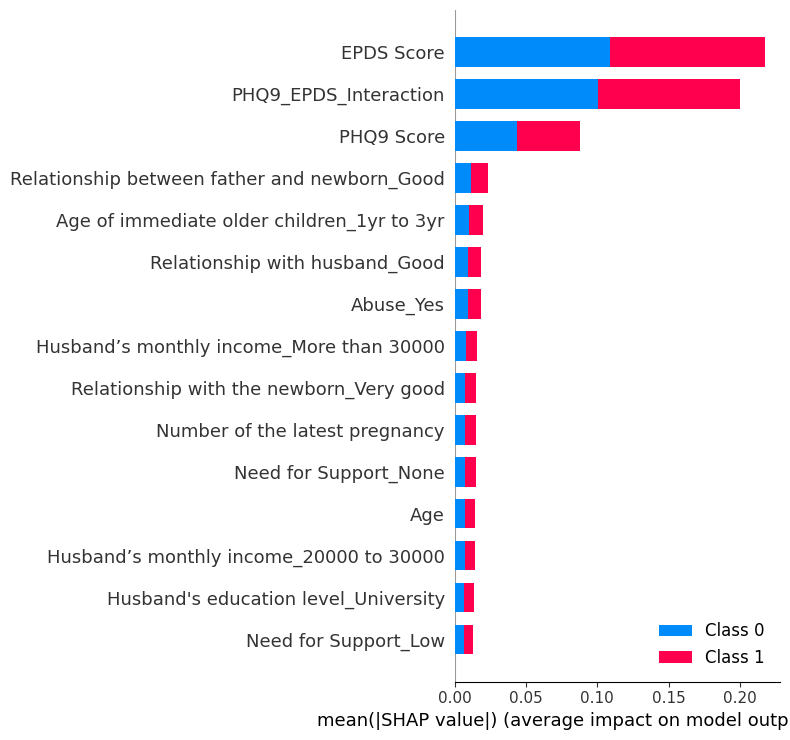

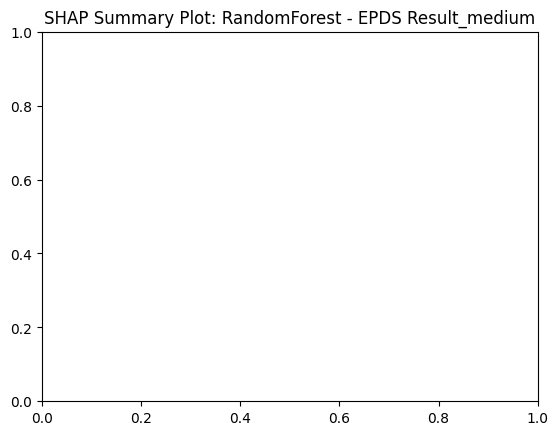

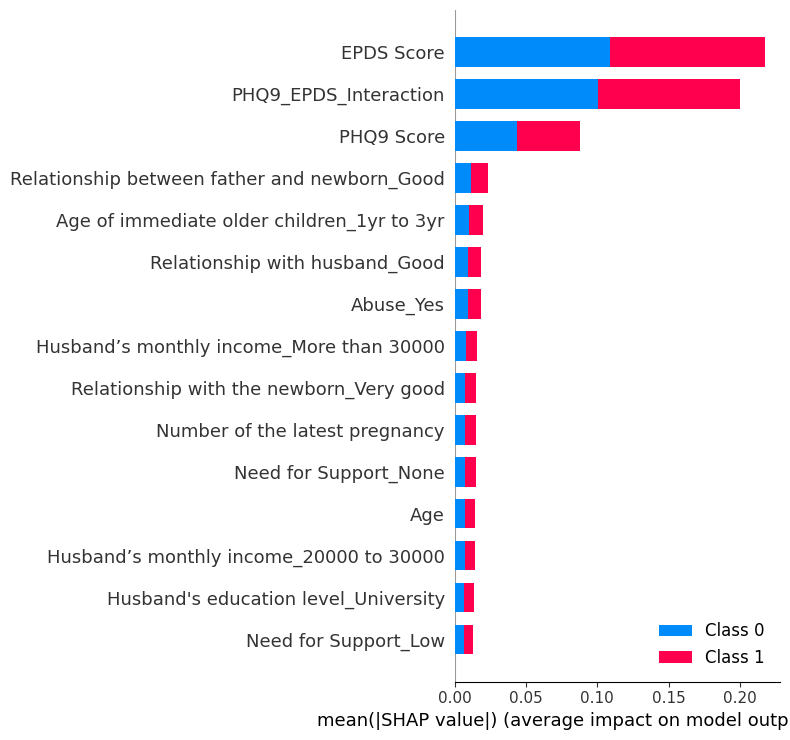

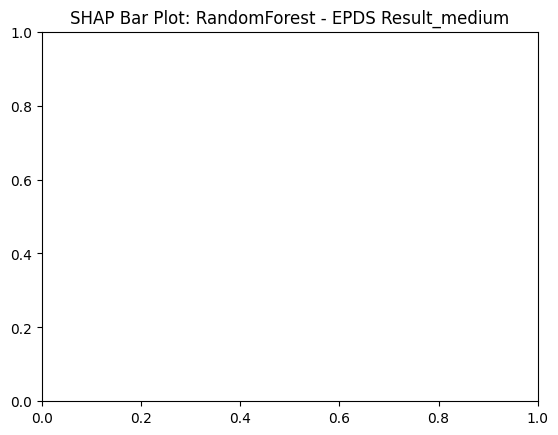

❌ Error explaining RandomForest on EPDS Result_medium: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: SVM on target: EPDS Result_medium
❌ Error explaining SVM on EPDS Result_medium: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: EPDS Result_medium
❌ Error explaining XGBoost on EPDS Result_medium: 'utf-8' codec can't decode byte 0xbe in position 6786: invalid start byte

Explaining model: DecisionTree on target: EPDS Result_medium


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


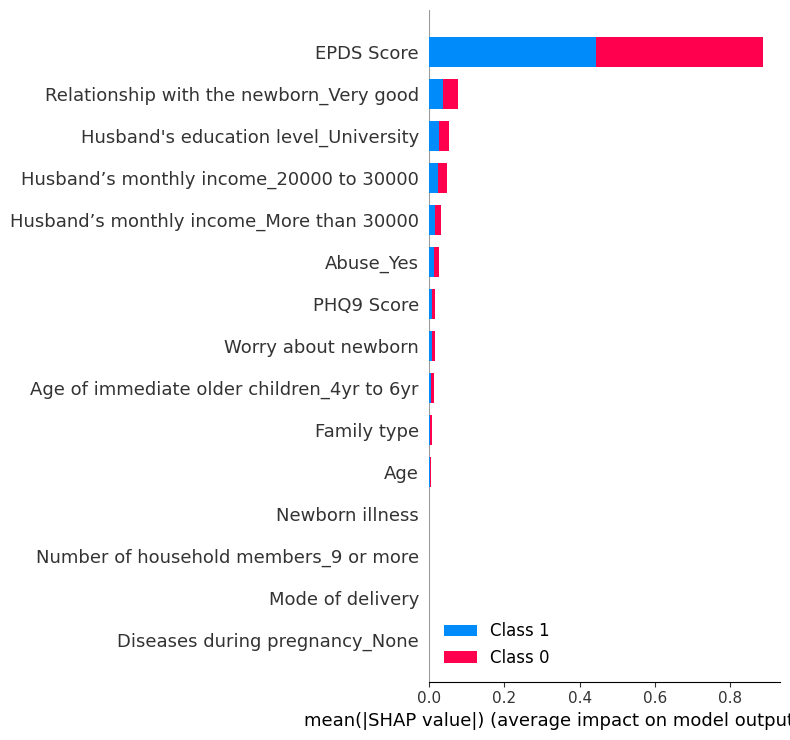

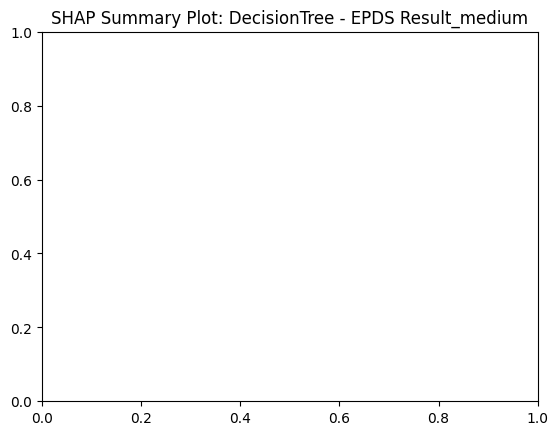

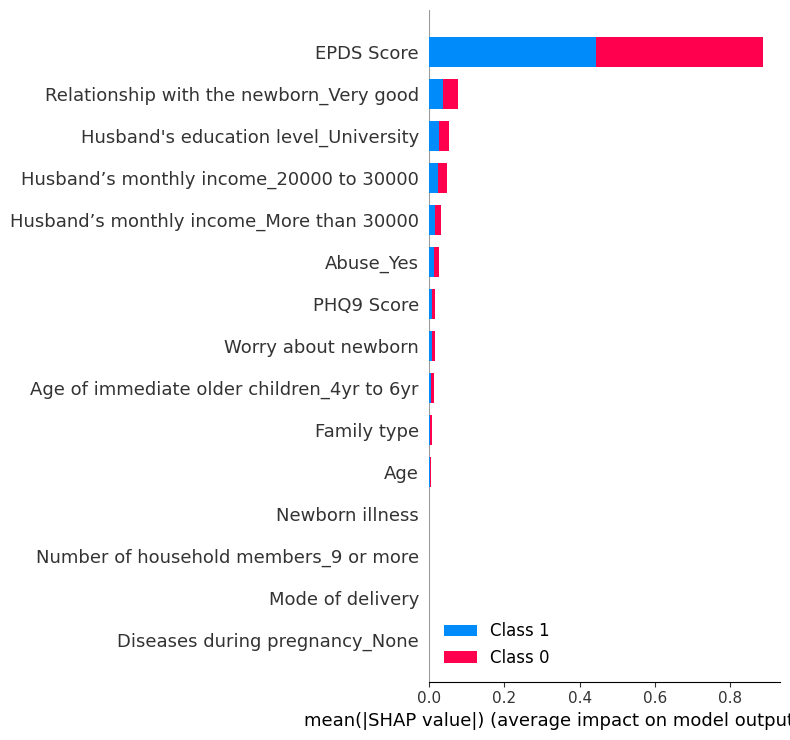

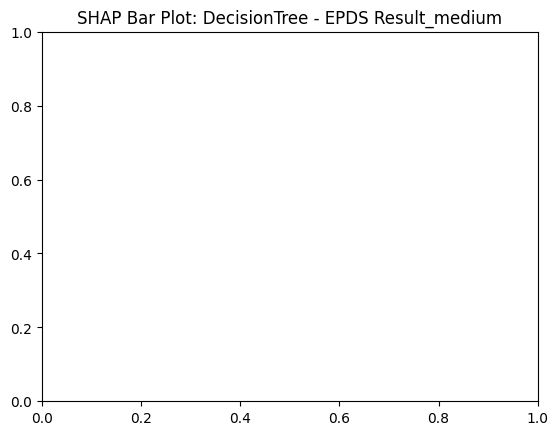

❌ Error explaining DecisionTree on EPDS Result_medium: In v0.20, force plot now requires the base value as the first parameter! Try shap.plots.force(explainer.expected_value, shap_values) or for multi-output models try shap.plots.force(explainer.expected_value[0], shap_values[0]).

Explaining model: LogisticRegression on target: EPDS Result_medium


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


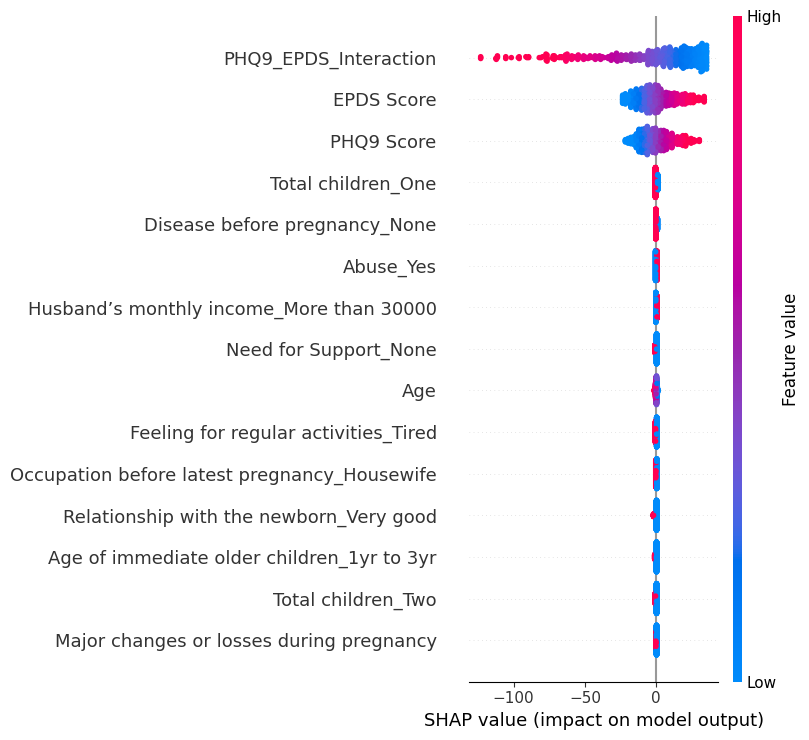

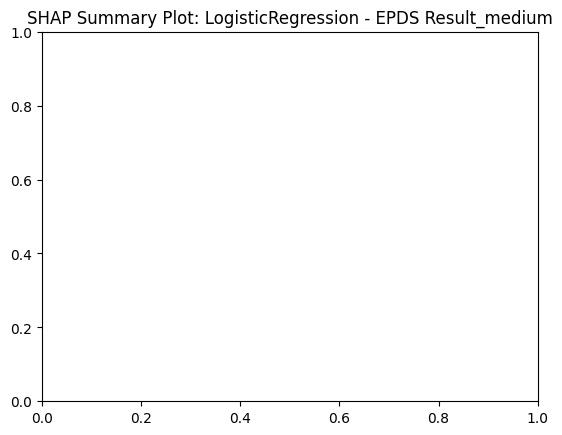

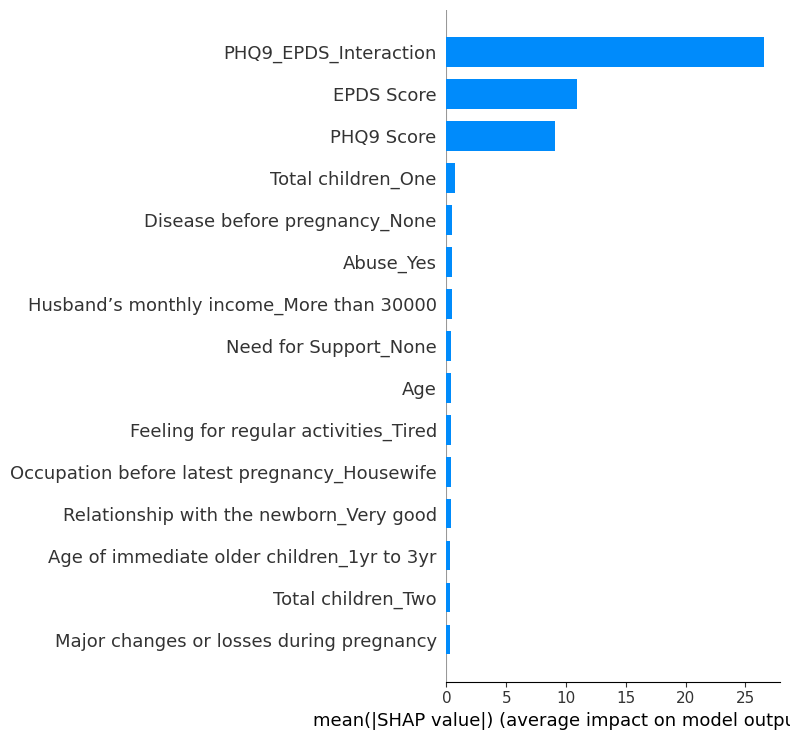

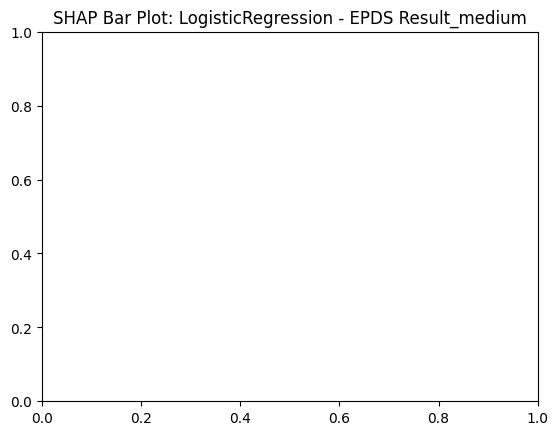

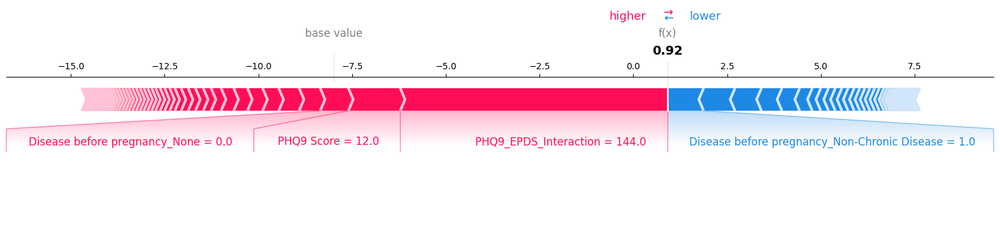

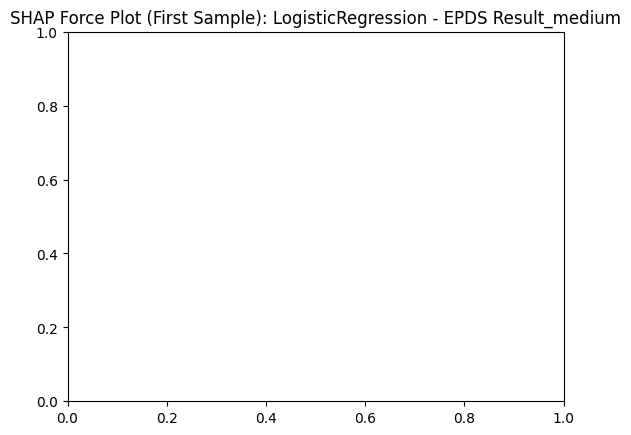


Explaining model: GradientBoosting on target: EPDS Result_medium


PermutationExplainer explainer: 640it [00:41, 11.90it/s]                                                               


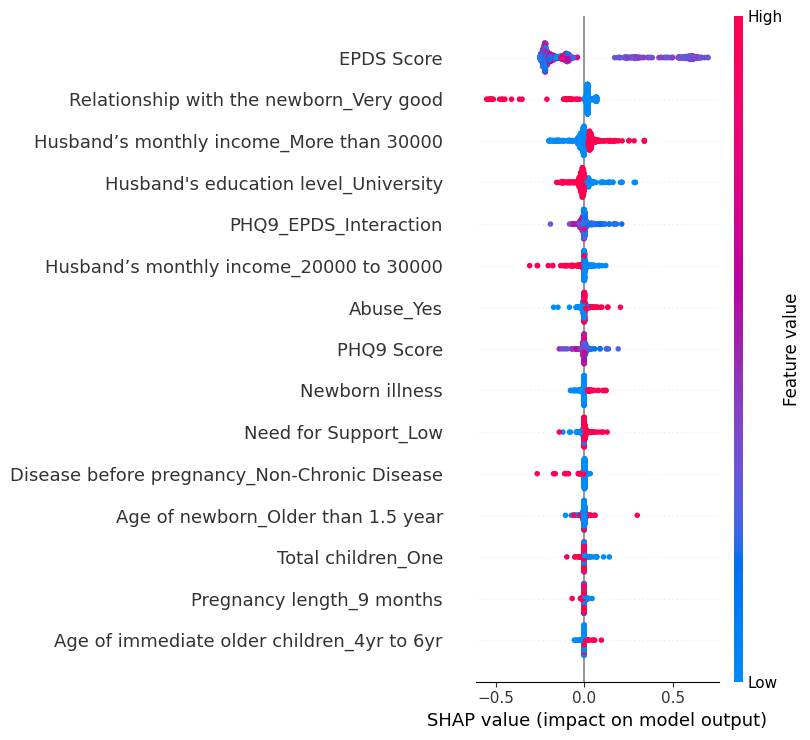

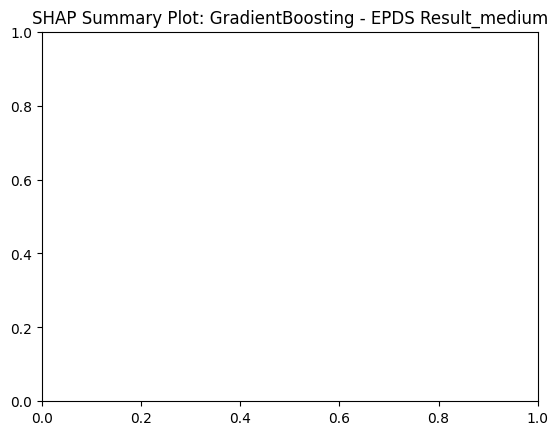

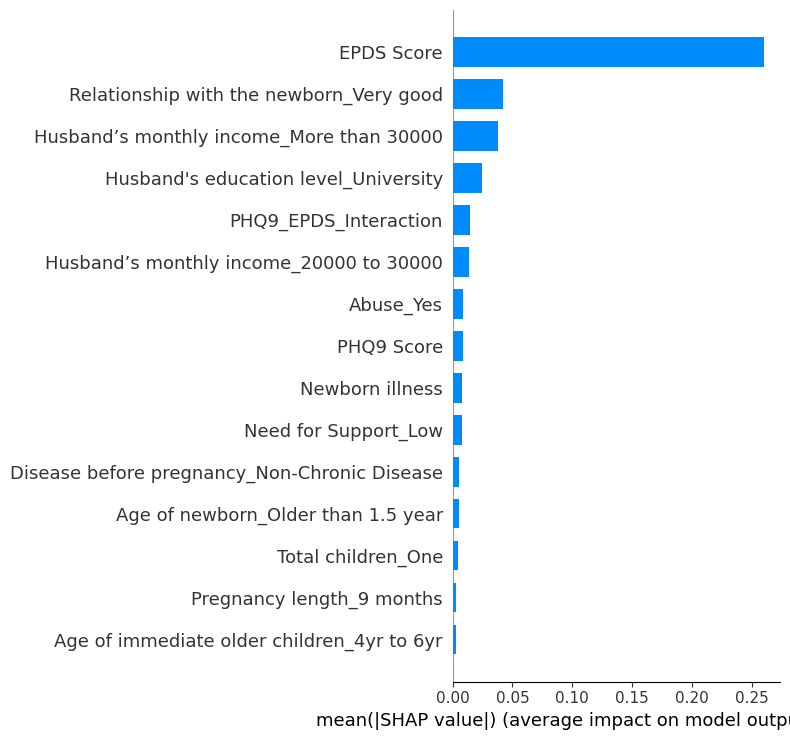

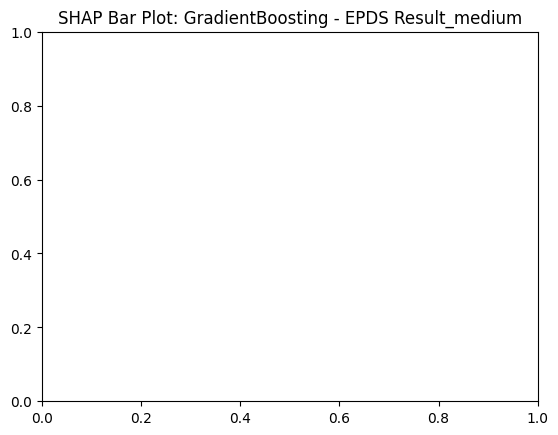

❌ Error explaining GradientBoosting on EPDS Result_medium: 'PermutationExplainer' object has no attribute 'expected_value'


In [32]:
import shap
import matplotlib.pyplot as plt

# Loop through best models and targets
for (model_name, target_variable), model in best_models.items():
    print(f"\nExplaining model: {model_name} on target: {target_variable}")
    
    try:
        X_explain = X_train_engineered.copy()

        # Add interaction feature if required
        if 'PHQ9 Score' in X_explain.columns and 'EPDS Score' in X_explain.columns:
            X_explain['PHQ9_EPDS_Interaction'] = X_explain['PHQ9 Score'] * X_explain['EPDS Score']
        
        # SHAP Explainer Selection
        if model_name == 'XGBoost':
            explainer = shap.TreeExplainer(model.get_booster())  # Use booster directly
            shap_values = explainer.shap_values(X_explain)

        elif model_name in ['RandomForest', 'DecisionTree']:
            explainer = shap.TreeExplainer(model)
            shap_values = explainer.shap_values(X_explain)

        elif model_name in ['LogisticRegression', 'SVM']:
            explainer = shap.LinearExplainer(model, X_explain, feature_perturbation="independent")
            shap_values = explainer.shap_values(X_explain)

        else:
            explainer = shap.Explainer(model.predict, X_explain)
            shap_values = explainer(X_explain)

        # ➤ SHAP Summary Plot (swarm)
        shap.summary_plot(shap_values, X_explain, max_display=15, show=True)
        plt.title(f"SHAP Summary Plot: {model_name} - {target_variable}")
        plt.show()

        # ➤ SHAP Bar Plot (global importance only)
        shap.summary_plot(shap_values, X_explain, plot_type="bar", max_display=15, show=True)
        plt.title(f"SHAP Bar Plot: {model_name} - {target_variable}")
        plt.show()

        # ➤ SHAP Force Plot (explanation for first sample)
        shap.initjs()  # For interactive HTML visual
        force_plot = shap.force_plot(
            explainer.expected_value[1] if isinstance(explainer.expected_value, list) else explainer.expected_value,
            shap_values[1][0] if isinstance(shap_values, list) else shap_values[0],
            X_explain.iloc[0],
            matplotlib=True,
            show=True
        )
        plt.title(f"SHAP Force Plot (First Sample): {model_name} - {target_variable}")
        plt.show()

    except Exception as e:
        print(f"❌ Error explaining {model_name} on {target_variable}: {e}")


In [33]:
import shap
import matplotlib.pyplot as plt
import os

# Create output directory
output_dir = "/mnt/data/shap_plots"
os.makedirs(output_dir, exist_ok=True)

# Loop through models
for (model_name, target_variable), model in best_models.items():
    print(f"\nExplaining model: {model_name} on target: {target_variable}")
    
    try:
        X_explain = X_train_engineered.copy()

        # Add interaction term if required
        if 'PHQ9 Score' in X_explain.columns and 'EPDS Score' in X_explain.columns:
            X_explain['PHQ9_EPDS_Interaction'] = X_explain['PHQ9 Score'] * X_explain['EPDS Score']

        # Initialize appropriate SHAP explainer
        if model_name == 'XGBoost':
            explainer = shap.TreeExplainer(model.get_booster())
            shap_values = explainer.shap_values(X_explain)

        elif model_name in ['RandomForest', 'DecisionTree']:
            explainer = shap.TreeExplainer(model)
            shap_values = explainer.shap_values(X_explain)

        elif model_name in ['LogisticRegression', 'SVM']:
            explainer = shap.LinearExplainer(model, X_explain, feature_perturbation="independent")
            shap_values = explainer.shap_values(X_explain)

        else:
            explainer = shap.Explainer(model.predict, X_explain)
            shap_values = explainer(X_explain)

        # --- SHAP Summary Bar Plot ---
        plt.figure(figsize=(10, 6))
        shap.summary_plot(shap_values, X_explain, max_display=15, show=False)
        plt.title(f"SHAP Summary Plot: {model_name} - {target_variable}")
        plot_filename = os.path.join(output_dir, f"{model_name}_{target_variable}_summary_bar.png")
        plt.savefig(plot_filename, bbox_inches='tight')
        plt.clf()
        plt.close()

        print(f"✅ Saved SHAP plot: {plot_filename}")

    except Exception as e:
        print(f"❌ Error explaining {model_name} on {target_variable}: {e}")



Explaining model: RandomForest on target: PHQ9 Result_Minimal
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_PHQ9 Result_Minimal_summary_bar.png

Explaining model: SVM on target: PHQ9 Result_Minimal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\SVM_PHQ9 Result_Minimal_summary_bar.png

Explaining model: XGBoost on target: PHQ9 Result_Minimal
❌ Error explaining XGBoost on PHQ9 Result_Minimal: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Minimal
✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_PHQ9 Result_Minimal_summary_bar.png

Explaining model: LogisticRegression on target: PHQ9 Result_Minimal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_PHQ9 Result_Minimal_summary_bar.png

Explaining model: GradientBoosting on target: PHQ9 Result_Minimal


PermutationExplainer explainer: 640it [00:29, 14.64it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_PHQ9 Result_Minimal_summary_bar.png

Explaining model: RandomForest on target: PHQ9 Result_Moderate
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_PHQ9 Result_Moderate_summary_bar.png

Explaining model: SVM on target: PHQ9 Result_Moderate
❌ Error explaining SVM on PHQ9 Result_Moderate: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Moderate
❌ Error explaining XGBoost on PHQ9 Result_Moderate: 'utf-8' codec can't decode byte 0xbd in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Moderate


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_PHQ9 Result_Moderate_summary_bar.png

Explaining model: LogisticRegression on target: PHQ9 Result_Moderate


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_PHQ9 Result_Moderate_summary_bar.png

Explaining model: GradientBoosting on target: PHQ9 Result_Moderate


PermutationExplainer explainer: 640it [00:25, 15.78it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_PHQ9 Result_Moderate_summary_bar.png

Explaining model: RandomForest on target: PHQ9 Result_Moderately Severe
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_PHQ9 Result_Moderately Severe_summary_bar.png

Explaining model: SVM on target: PHQ9 Result_Moderately Severe
❌ Error explaining SVM on PHQ9 Result_Moderately Severe: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Moderately Severe
❌ Error explaining XGBoost on PHQ9 Result_Moderately Severe: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Moderately Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_PHQ9 Result_Moderately Severe_summary_bar.png

Explaining model: LogisticRegression on target: PHQ9 Result_Moderately Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_PHQ9 Result_Moderately Severe_summary_bar.png

Explaining model: GradientBoosting on target: PHQ9 Result_Moderately Severe


PermutationExplainer explainer: 640it [00:23, 16.20it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_PHQ9 Result_Moderately Severe_summary_bar.png

Explaining model: RandomForest on target: PHQ9 Result_Normal
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_PHQ9 Result_Normal_summary_bar.png

Explaining model: SVM on target: PHQ9 Result_Normal
❌ Error explaining SVM on PHQ9 Result_Normal: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: PHQ9 Result_Normal
❌ Error explaining XGBoost on PHQ9 Result_Normal: 'utf-8' codec can't decode byte 0xbf in position 6795: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Normal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_PHQ9 Result_Normal_summary_bar.png

Explaining model: LogisticRegression on target: PHQ9 Result_Normal


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_PHQ9 Result_Normal_summary_bar.png

Explaining model: GradientBoosting on target: PHQ9 Result_Normal


PermutationExplainer explainer: 640it [00:23, 16.02it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_PHQ9 Result_Normal_summary_bar.png

Explaining model: RandomForest on target: PHQ9 Result_Severe
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_PHQ9 Result_Severe_summary_bar.png

Explaining model: SVM on target: PHQ9 Result_Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\SVM_PHQ9 Result_Severe_summary_bar.png

Explaining model: XGBoost on target: PHQ9 Result_Severe
❌ Error explaining XGBoost on PHQ9 Result_Severe: 'utf-8' codec can't decode byte 0xbe in position 6650: invalid start byte

Explaining model: DecisionTree on target: PHQ9 Result_Severe
✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_PHQ9 Result_Severe_summary_bar.png

Explaining model: LogisticRegression on target: PHQ9 Result_Severe


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_PHQ9 Result_Severe_summary_bar.png

Explaining model: GradientBoosting on target: PHQ9 Result_Severe


PermutationExplainer explainer: 640it [00:23, 16.48it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_PHQ9 Result_Severe_summary_bar.png

Explaining model: RandomForest on target: EPDS Result_low
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_EPDS Result_low_summary_bar.png

Explaining model: SVM on target: EPDS Result_low
❌ Error explaining SVM on EPDS Result_low: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: EPDS Result_low
❌ Error explaining XGBoost on EPDS Result_low: 'utf-8' codec can't decode byte 0x84 in position 6303: invalid start byte

Explaining model: DecisionTree on target: EPDS Result_low


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_EPDS Result_low_summary_bar.png

Explaining model: LogisticRegression on target: EPDS Result_low


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_EPDS Result_low_summary_bar.png

Explaining model: GradientBoosting on target: EPDS Result_low


PermutationExplainer explainer: 640it [00:30, 13.99it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_EPDS Result_low_summary_bar.png

Explaining model: RandomForest on target: EPDS Result_medium
✅ Saved SHAP plot: /mnt/data/shap_plots\RandomForest_EPDS Result_medium_summary_bar.png

Explaining model: SVM on target: EPDS Result_medium
❌ Error explaining SVM on EPDS Result_medium: An unknown model type was passed: <class 'sklearn.svm._classes.SVC'>

Explaining model: XGBoost on target: EPDS Result_medium
❌ Error explaining XGBoost on EPDS Result_medium: 'utf-8' codec can't decode byte 0xbe in position 6786: invalid start byte

Explaining model: DecisionTree on target: EPDS Result_medium


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\DecisionTree_EPDS Result_medium_summary_bar.png

Explaining model: LogisticRegression on target: EPDS Result_medium


The option feature_perturbation="independent" is has been renamed to feature_perturbation="interventional"!
The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, or maskers.Impute)


✅ Saved SHAP plot: /mnt/data/shap_plots\LogisticRegression_EPDS Result_medium_summary_bar.png

Explaining model: GradientBoosting on target: EPDS Result_medium


PermutationExplainer explainer: 640it [00:39, 12.12it/s]                                                               


✅ Saved SHAP plot: /mnt/data/shap_plots\GradientBoosting_EPDS Result_medium_summary_bar.png


In [34]:
import os
os.listdir('/mnt/data/shap_plots')


['DecisionTree_EPDS Result_low_summary_bar.png',
 'DecisionTree_EPDS Result_medium_summary_bar.png',
 'DecisionTree_PHQ9 Result_Minimal_summary_bar.png',
 'DecisionTree_PHQ9 Result_Moderately Severe_summary_bar.png',
 'DecisionTree_PHQ9 Result_Moderate_summary_bar.png',
 'DecisionTree_PHQ9 Result_Normal_summary_bar.png',
 'DecisionTree_PHQ9 Result_Severe_summary_bar.png',
 'GradientBoosting_EPDS Result_low_summary_bar.png',
 'GradientBoosting_EPDS Result_medium_summary_bar.png',
 'GradientBoosting_PHQ9 Result_Minimal_summary_bar.png',
 'GradientBoosting_PHQ9 Result_Moderately Severe_summary_bar.png',
 'GradientBoosting_PHQ9 Result_Moderate_summary_bar.png',
 'GradientBoosting_PHQ9 Result_Normal_summary_bar.png',
 'GradientBoosting_PHQ9 Result_Severe_summary_bar.png',
 'LogisticRegression_EPDS Result_low_summary_bar.png',
 'LogisticRegression_EPDS Result_medium_summary_bar.png',
 'LogisticRegression_PHQ9 Result_Minimal_summary_bar.png',
 'LogisticRegression_PHQ9 Result_Moderately Severe

In [35]:
import shutil
shutil.make_archive('/mnt/data/shap_plots_zip', 'zip', '/mnt/data/shap_plots')


'C:\\mnt\\data\\shap_plots_zip.zip'

In [36]:
from IPython.display import FileLink
FileLink('/mnt/data/shap_plots_zip.zip')


C:\mnt\data\shap_plots_zip.zip